In [1]:
# Import the required modules
import numpy as np
import pandas as pd
import math
from   datetime import datetime, timedelta,time
import requests
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
from   matplotlib.ticker import FuncFormatter
import statsmodels.api as sm
import pytz

In [2]:
API_KEY_ID     = "Enter_key_here"
API_SECRET_KEY = "Enter_private_key_here"

def get_alpaca_data(symbol: str, timeframe: str, start_date: str, end_date: str):
    # Get historical open, high, low, close, and volume data from Alpaca Markets.
    url = 'https://data.alpaca.markets/v2/stocks/bars'
    headers = {
        'APCA-API-KEY-ID': API_KEY_ID,
        'APCA-API-SECRET-KEY': API_SECRET_KEY
    }
    
    params = {
        'symbols': symbol,
        'timeframe': timeframe,
        'start': datetime.strptime(start_date, "%Y-%m-%d").isoformat() + 'Z',
        'end': datetime.strptime(end_date, "%Y-%m-%d").isoformat() + 'Z',
        'limit': 10000,
        'adjustment': 'raw',
        'feed': 'sip'
    }

    data_list = []
    eastern = pytz.timezone('America/New_York')  
    utc = pytz.utc  
    market_open  = time(9, 30)
    market_close = time(15, 59)

    print("Starting data fetching...")
    while True:
        print(f"Fetching data for symbols: {symbol} from {start_date} to {end_date}")
        response = requests.get(url, headers=headers, params=params)
        if response.status_code != 200:
            print(f"Error fetching data with status code {response.status_code}: {response.text}")
            break

        data = response.json()
        bars = data.get('bars')

        for symbol, entries in bars.items():
            print(f"Processing {len(entries)} entries for symbol: {symbol}")
            for entry in entries:
                try:
                    utc_time = datetime.fromisoformat(entry['t'].rstrip('Z')).replace(tzinfo=utc)
                    eastern_time = utc_time.astimezone(eastern)

                    # Apply market hours filter for '1Min' timeframe
                    if timeframe == '1Min' and not (market_open <= eastern_time.time() <= market_close):
                        continue  # Skip entries outside market hours

                    data_entry = {
                        'volume': entry['v'],
                        'open': entry['o'],
                        'high': entry['h'],
                        'low': entry['l'],
                        'close': entry['c'],
                        'caldt': eastern_time  
                    }
                    data_list.append(data_entry)
                    print(f"Appended data for {symbol} at {eastern_time}")
                except Exception as e:
                    print(f"Error processing entry: {entry}, {e}")
                    continue

        if 'next_page_token' in data and data['next_page_token']:
            params['page_token'] = data['next_page_token']
            print("Fetching next page...")
        else:
            print("No more pages to fetch.")
            break

    df = pd.DataFrame(data_list)
    print("Data fetching complete.")
    return df

def get_alpaca_corporate_actions(symbol: str, start_date: str, end_date: str):
    # Get historical dividends, stock splits, and reverse splits from Alpaca Markets API.
    url = "https://data.alpaca.markets/v1/corporate-actions"
    
    headers = {
        "accept": "application/json",
        "APCA-API-KEY-ID": API_KEY_ID,
        "APCA-API-SECRET-KEY": API_SECRET_KEY
    }

    params = {
        "symbols": symbol,
        "types": "forward_split,cash_dividend,reverse_split", # Fetch both dividends and splits
        "start": start_date,
        "end": end_date,
        "limit": 1000  # Fetch up to 1000 records at a time
    }

    response = requests.get(url, headers=headers, params=params)
    
    if response.status_code == 200:
        data = response.json()
        corporate_actions = data.get("corporate_actions", {})

        # Process dividends
        dividends_data = [
            {
                'caldt': datetime.strptime(entry['ex_date'], '%Y-%m-%d'),
                'dividend': float(entry['rate'])
            }
            for entry in corporate_actions.get("cash_dividends", [])
        ]
        dividends_df = pd.DataFrame(dividends_data)

        # Process splits (including reverse splits)
        splits_data = [
            {
                'caldt': datetime.strptime(entry['ex_date'], '%Y-%m-%d'),
                'split_ratio': entry['new_rate'] / entry['old_rate'],
                'split_type': 'forward_split'
            }
            for entry in corporate_actions.get("forward_splits", [])
        ] + [
            {
                'caldt': datetime.strptime(entry['ex_date'], '%Y-%m-%d'),
                'split_ratio': entry['new_rate'] / entry['old_rate'],
                'split_type': 'reverse_split'
            }
            for entry in corporate_actions.get("reverse_splits", [])
        ]    
        splits_df = pd.DataFrame(splits_data)
        
        print("Data fetching complete.")
        return dividends_df, splits_df
    else:
        print(f"Error fetching data: {response.status_code} - {response.text}")
        return pd.DataFrame(), pd.DataFrame()


In [3]:
symbol = 'QQQ'
start_date     = '2018-01-01'
end_date       = '2025-01-01'   
intraday_data = get_alpaca_data(symbol, '1Min', start_date, end_date)
daily_data = get_alpaca_data(symbol, '1D', start_date, end_date)
dividends, splits = get_alpaca_corporate_actions(symbol,start_date,end_date)

Starting data fetching...
Fetching data for symbols: QQQ from 2018-01-01 to 2025-01-01
Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2018-01-02 09:30:00-05:00
Appended data for QQQ at 2018-01-02 09:31:00-05:00
Appended data for QQQ at 2018-01-02 09:32:00-05:00
Appended data for QQQ at 2018-01-02 09:33:00-05:00
Appended data for QQQ at 2018-01-02 09:34:00-05:00
Appended data for QQQ at 2018-01-02 09:35:00-05:00
Appended data for QQQ at 2018-01-02 09:36:00-05:00
Appended data for QQQ at 2018-01-02 09:37:00-05:00
Appended data for QQQ at 2018-01-02 09:38:00-05:00
Appended data for QQQ at 2018-01-02 09:39:00-05:00
Appended data for QQQ at 2018-01-02 09:40:00-05:00
Appended data for QQQ at 2018-01-02 09:41:00-05:00
Appended data for QQQ at 2018-01-02 09:42:00-05:00
Appended data for QQQ at 2018-01-02 09:43:00-05:00
Appended data for QQQ at 2018-01-02 09:44:00-05:00
Appended data for QQQ at 2018-01-02 09:45:00-05:00
Appended data for QQQ at 2018-01-02 09:46:00-05:00
Appen

Appended data for QQQ at 2018-01-11 13:13:00-05:00
Appended data for QQQ at 2018-01-11 13:14:00-05:00
Appended data for QQQ at 2018-01-11 13:15:00-05:00
Appended data for QQQ at 2018-01-11 13:16:00-05:00
Appended data for QQQ at 2018-01-11 13:17:00-05:00
Appended data for QQQ at 2018-01-11 13:18:00-05:00
Appended data for QQQ at 2018-01-11 13:19:00-05:00
Appended data for QQQ at 2018-01-11 13:20:00-05:00
Appended data for QQQ at 2018-01-11 13:21:00-05:00
Appended data for QQQ at 2018-01-11 13:22:00-05:00
Appended data for QQQ at 2018-01-11 13:23:00-05:00
Appended data for QQQ at 2018-01-11 13:24:00-05:00
Appended data for QQQ at 2018-01-11 13:25:00-05:00
Appended data for QQQ at 2018-01-11 13:26:00-05:00
Appended data for QQQ at 2018-01-11 13:27:00-05:00
Appended data for QQQ at 2018-01-11 13:28:00-05:00
Appended data for QQQ at 2018-01-11 13:29:00-05:00
Appended data for QQQ at 2018-01-11 13:30:00-05:00
Appended data for QQQ at 2018-01-11 13:31:00-05:00
Appended data for QQQ at 2018-0

Appended data for QQQ at 2018-01-24 11:12:00-05:00
Appended data for QQQ at 2018-01-24 11:13:00-05:00
Appended data for QQQ at 2018-01-24 11:14:00-05:00
Appended data for QQQ at 2018-01-24 11:15:00-05:00
Appended data for QQQ at 2018-01-24 11:16:00-05:00
Appended data for QQQ at 2018-01-24 11:17:00-05:00
Appended data for QQQ at 2018-01-24 11:18:00-05:00
Appended data for QQQ at 2018-01-24 11:19:00-05:00
Appended data for QQQ at 2018-01-24 11:20:00-05:00
Appended data for QQQ at 2018-01-24 11:21:00-05:00
Appended data for QQQ at 2018-01-24 11:22:00-05:00
Appended data for QQQ at 2018-01-24 11:23:00-05:00
Appended data for QQQ at 2018-01-24 11:24:00-05:00
Appended data for QQQ at 2018-01-24 11:25:00-05:00
Appended data for QQQ at 2018-01-24 11:26:00-05:00
Appended data for QQQ at 2018-01-24 11:27:00-05:00
Appended data for QQQ at 2018-01-24 11:28:00-05:00
Appended data for QQQ at 2018-01-24 11:29:00-05:00
Appended data for QQQ at 2018-01-24 11:30:00-05:00
Appended data for QQQ at 2018-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2018-01-25 09:30:00-05:00
Appended data for QQQ at 2018-01-25 09:31:00-05:00
Appended data for QQQ at 2018-01-25 09:32:00-05:00
Appended data for QQQ at 2018-01-25 09:33:00-05:00
Appended data for QQQ at 2018-01-25 09:34:00-05:00
Appended data for QQQ at 2018-01-25 09:35:00-05:00
Appended data for QQQ at 2018-01-25 09:36:00-05:00
Appended data for QQQ at 2018-01-25 09:37:00-05:00
Appended data for QQQ at 2018-01-25 09:38:00-05:00
Appended data for QQQ at 2018-01-25 09:39:00-05:00
Appended data for QQQ at 2018-01-25 09:40:00-05:00
Appended data for QQQ at 2018-01-25 09:41:00-05:00
Appended data for QQQ at 2018-01-25 09:42:00-05:00
Appended data for QQQ at 2018-01-25 09:43:00-05:00
Appended data for QQQ at 2018-01-25 09:44:00-05:00
Appended data for QQQ at 2018-01-25 09:45:00-05:00
Appended data for QQQ at 2018-01-25 09:46:00-05:00
Appended data for QQQ at 2018-01-25 09:47:00-05:00
Appended data for QQQ at 2018-01-25 09:48

Appended data for QQQ at 2018-02-02 15:38:00-05:00
Appended data for QQQ at 2018-02-02 15:39:00-05:00
Appended data for QQQ at 2018-02-02 15:40:00-05:00
Appended data for QQQ at 2018-02-02 15:41:00-05:00
Appended data for QQQ at 2018-02-02 15:42:00-05:00
Appended data for QQQ at 2018-02-02 15:43:00-05:00
Appended data for QQQ at 2018-02-02 15:44:00-05:00
Appended data for QQQ at 2018-02-02 15:45:00-05:00
Appended data for QQQ at 2018-02-02 15:46:00-05:00
Appended data for QQQ at 2018-02-02 15:47:00-05:00
Appended data for QQQ at 2018-02-02 15:48:00-05:00
Appended data for QQQ at 2018-02-02 15:49:00-05:00
Appended data for QQQ at 2018-02-02 15:50:00-05:00
Appended data for QQQ at 2018-02-02 15:51:00-05:00
Appended data for QQQ at 2018-02-02 15:52:00-05:00
Appended data for QQQ at 2018-02-02 15:53:00-05:00
Appended data for QQQ at 2018-02-02 15:54:00-05:00
Appended data for QQQ at 2018-02-02 15:55:00-05:00
Appended data for QQQ at 2018-02-02 15:56:00-05:00
Appended data for QQQ at 2018-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2018-02-13 11:31:00-05:00
Appended data for QQQ at 2018-02-13 11:32:00-05:00
Appended data for QQQ at 2018-02-13 11:33:00-05:00
Appended data for QQQ at 2018-02-13 11:34:00-05:00
Appended data for QQQ at 2018-02-13 11:35:00-05:00
Appended data for QQQ at 2018-02-13 11:36:00-05:00
Appended data for QQQ at 2018-02-13 11:37:00-05:00
Appended data for QQQ at 2018-02-13 11:38:00-05:00
Appended data for QQQ at 2018-02-13 11:39:00-05:00
Appended data for QQQ at 2018-02-13 11:40:00-05:00
Appended data for QQQ at 2018-02-13 11:41:00-05:00
Appended data for QQQ at 2018-02-13 11:42:00-05:00
Appended data for QQQ at 2018-02-13 11:43:00-05:00
Appended data for QQQ at 2018-02-13 11:44:00-05:00
Appended data for QQQ at 2018-02-13 11:45:00-05:00
Appended data for QQQ at 2018-02-13 11:46:00-05:00
Appended data for QQQ at 2018-02-13 11:47:00-05:00
Appended data for QQQ at 2018-02-13 11:48:00-05:00
Appended data for QQQ at 2018-02-13 11:49

Appended data for QQQ at 2018-02-23 14:27:00-05:00
Appended data for QQQ at 2018-02-23 14:28:00-05:00
Appended data for QQQ at 2018-02-23 14:29:00-05:00
Appended data for QQQ at 2018-02-23 14:30:00-05:00
Appended data for QQQ at 2018-02-23 14:31:00-05:00
Appended data for QQQ at 2018-02-23 14:32:00-05:00
Appended data for QQQ at 2018-02-23 14:33:00-05:00
Appended data for QQQ at 2018-02-23 14:34:00-05:00
Appended data for QQQ at 2018-02-23 14:35:00-05:00
Appended data for QQQ at 2018-02-23 14:36:00-05:00
Appended data for QQQ at 2018-02-23 14:37:00-05:00
Appended data for QQQ at 2018-02-23 14:38:00-05:00
Appended data for QQQ at 2018-02-23 14:39:00-05:00
Appended data for QQQ at 2018-02-23 14:40:00-05:00
Appended data for QQQ at 2018-02-23 14:41:00-05:00
Appended data for QQQ at 2018-02-23 14:42:00-05:00
Appended data for QQQ at 2018-02-23 14:43:00-05:00
Appended data for QQQ at 2018-02-23 14:44:00-05:00
Appended data for QQQ at 2018-02-23 14:45:00-05:00
Appended data for QQQ at 2018-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2018-03-06 11:21:00-05:00
Appended data for QQQ at 2018-03-06 11:22:00-05:00
Appended data for QQQ at 2018-03-06 11:23:00-05:00
Appended data for QQQ at 2018-03-06 11:24:00-05:00
Appended data for QQQ at 2018-03-06 11:25:00-05:00
Appended data for QQQ at 2018-03-06 11:26:00-05:00
Appended data for QQQ at 2018-03-06 11:27:00-05:00
Appended data for QQQ at 2018-03-06 11:28:00-05:00
Appended data for QQQ at 2018-03-06 11:29:00-05:00
Appended data for QQQ at 2018-03-06 11:30:00-05:00
Appended data for QQQ at 2018-03-06 11:31:00-05:00
Appended data for QQQ at 2018-03-06 11:32:00-05:00
Appended data for QQQ at 2018-03-06 11:33:00-05:00
Appended data for QQQ at 2018-03-06 11:34:00-05:00
Appended data for QQQ at 2018-03-06 11:35:00-05:00
Appended data for QQQ at 2018-03-06 11:36:00-05:00
Appended data for QQQ at 2018-03-06 11:37:00-05:00
Appended data for QQQ at 2018-03-06 11:38:00-05:00
Appended data for QQQ at 2018-03-06 11:39

Appended data for QQQ at 2018-03-16 09:57:00-04:00
Appended data for QQQ at 2018-03-16 09:58:00-04:00
Appended data for QQQ at 2018-03-16 09:59:00-04:00
Appended data for QQQ at 2018-03-16 10:00:00-04:00
Appended data for QQQ at 2018-03-16 10:01:00-04:00
Appended data for QQQ at 2018-03-16 10:02:00-04:00
Appended data for QQQ at 2018-03-16 10:03:00-04:00
Appended data for QQQ at 2018-03-16 10:04:00-04:00
Appended data for QQQ at 2018-03-16 10:05:00-04:00
Appended data for QQQ at 2018-03-16 10:06:00-04:00
Appended data for QQQ at 2018-03-16 10:07:00-04:00
Appended data for QQQ at 2018-03-16 10:08:00-04:00
Appended data for QQQ at 2018-03-16 10:09:00-04:00
Appended data for QQQ at 2018-03-16 10:10:00-04:00
Appended data for QQQ at 2018-03-16 10:11:00-04:00
Appended data for QQQ at 2018-03-16 10:12:00-04:00
Appended data for QQQ at 2018-03-16 10:13:00-04:00
Appended data for QQQ at 2018-03-16 10:14:00-04:00
Appended data for QQQ at 2018-03-16 10:15:00-04:00
Appended data for QQQ at 2018-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2018-03-26 09:30:00-04:00
Appended data for QQQ at 2018-03-26 09:31:00-04:00
Appended data for QQQ at 2018-03-26 09:32:00-04:00
Appended data for QQQ at 2018-03-26 09:33:00-04:00
Appended data for QQQ at 2018-03-26 09:34:00-04:00
Appended data for QQQ at 2018-03-26 09:35:00-04:00
Appended data for QQQ at 2018-03-26 09:36:00-04:00
Appended data for QQQ at 2018-03-26 09:37:00-04:00
Appended data for QQQ at 2018-03-26 09:38:00-04:00
Appended data for QQQ at 2018-03-26 09:39:00-04:00
Appended data for QQQ at 2018-03-26 09:40:00-04:00
Appended data for QQQ at 2018-03-26 09:41:00-04:00
Appended data for QQQ at 2018-03-26 09:42:00-04:00
Appended data for QQQ at 2018-03-26 09:43:00-04:00
Appended data for QQQ at 2018-03-26 09:44:00-04:00
Appended data for QQQ at 2018-03-26 09:45:00-04:00
Appended data for QQQ at 2018-03-26 09:46:00-04:00
Appended data for QQQ at 2018-03-26 09:47:00-04:00
Appended data for QQQ at 2018-03-26 09:48

Appended data for QQQ at 2018-04-05 13:34:00-04:00
Appended data for QQQ at 2018-04-05 13:35:00-04:00
Appended data for QQQ at 2018-04-05 13:36:00-04:00
Appended data for QQQ at 2018-04-05 13:37:00-04:00
Appended data for QQQ at 2018-04-05 13:38:00-04:00
Appended data for QQQ at 2018-04-05 13:39:00-04:00
Appended data for QQQ at 2018-04-05 13:40:00-04:00
Appended data for QQQ at 2018-04-05 13:41:00-04:00
Appended data for QQQ at 2018-04-05 13:42:00-04:00
Appended data for QQQ at 2018-04-05 13:43:00-04:00
Appended data for QQQ at 2018-04-05 13:44:00-04:00
Appended data for QQQ at 2018-04-05 13:45:00-04:00
Appended data for QQQ at 2018-04-05 13:46:00-04:00
Appended data for QQQ at 2018-04-05 13:47:00-04:00
Appended data for QQQ at 2018-04-05 13:48:00-04:00
Appended data for QQQ at 2018-04-05 13:49:00-04:00
Appended data for QQQ at 2018-04-05 13:50:00-04:00
Appended data for QQQ at 2018-04-05 13:51:00-04:00
Appended data for QQQ at 2018-04-05 13:52:00-04:00
Appended data for QQQ at 2018-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2018-04-13 09:30:00-04:00
Appended data for QQQ at 2018-04-13 09:31:00-04:00
Appended data for QQQ at 2018-04-13 09:32:00-04:00
Appended data for QQQ at 2018-04-13 09:33:00-04:00
Appended data for QQQ at 2018-04-13 09:34:00-04:00
Appended data for QQQ at 2018-04-13 09:35:00-04:00
Appended data for QQQ at 2018-04-13 09:36:00-04:00
Appended data for QQQ at 2018-04-13 09:37:00-04:00
Appended data for QQQ at 2018-04-13 09:38:00-04:00
Appended data for QQQ at 2018-04-13 09:39:00-04:00
Appended data for QQQ at 2018-04-13 09:40:00-04:00
Appended data for QQQ at 2018-04-13 09:41:00-04:00
Appended data for QQQ at 2018-04-13 09:42:00-04:00
Appended data for QQQ at 2018-04-13 09:43:00-04:00
Appended data for QQQ at 2018-04-13 09:44:00-04:00
Appended data for QQQ at 2018-04-13 09:45:00-04:00
Appended data for QQQ at 2018-04-13 09:46:00-04:00
Appended data for QQQ at 2018-04-13 09:47:00-04:00
Appended data for QQQ at 2018-04-13 09:48

Appended data for QQQ at 2018-04-24 12:55:00-04:00
Appended data for QQQ at 2018-04-24 12:56:00-04:00
Appended data for QQQ at 2018-04-24 12:57:00-04:00
Appended data for QQQ at 2018-04-24 12:58:00-04:00
Appended data for QQQ at 2018-04-24 12:59:00-04:00
Appended data for QQQ at 2018-04-24 13:00:00-04:00
Appended data for QQQ at 2018-04-24 13:01:00-04:00
Appended data for QQQ at 2018-04-24 13:02:00-04:00
Appended data for QQQ at 2018-04-24 13:03:00-04:00
Appended data for QQQ at 2018-04-24 13:04:00-04:00
Appended data for QQQ at 2018-04-24 13:05:00-04:00
Appended data for QQQ at 2018-04-24 13:06:00-04:00
Appended data for QQQ at 2018-04-24 13:07:00-04:00
Appended data for QQQ at 2018-04-24 13:08:00-04:00
Appended data for QQQ at 2018-04-24 13:09:00-04:00
Appended data for QQQ at 2018-04-24 13:10:00-04:00
Appended data for QQQ at 2018-04-24 13:11:00-04:00
Appended data for QQQ at 2018-04-24 13:12:00-04:00
Appended data for QQQ at 2018-04-24 13:13:00-04:00
Appended data for QQQ at 2018-0

Fetching next page...
Fetching data for symbols: QQQ from 2018-01-01 to 2025-01-01
Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2018-05-07 12:20:00-04:00
Appended data for QQQ at 2018-05-07 12:21:00-04:00
Appended data for QQQ at 2018-05-07 12:22:00-04:00
Appended data for QQQ at 2018-05-07 12:23:00-04:00
Appended data for QQQ at 2018-05-07 12:24:00-04:00
Appended data for QQQ at 2018-05-07 12:25:00-04:00
Appended data for QQQ at 2018-05-07 12:26:00-04:00
Appended data for QQQ at 2018-05-07 12:27:00-04:00
Appended data for QQQ at 2018-05-07 12:28:00-04:00
Appended data for QQQ at 2018-05-07 12:29:00-04:00
Appended data for QQQ at 2018-05-07 12:30:00-04:00
Appended data for QQQ at 2018-05-07 12:31:00-04:00
Appended data for QQQ at 2018-05-07 12:32:00-04:00
Appended data for QQQ at 2018-05-07 12:33:00-04:00
Appended data for QQQ at 2018-05-07 12:34:00-04:00
Appended data for QQQ at 2018-05-07 12:35:00-04:00
Appended data for QQQ at 2018-05-07 12:36:00-04:00
Appended 

Appended data for QQQ at 2018-05-17 10:16:00-04:00
Appended data for QQQ at 2018-05-17 10:17:00-04:00
Appended data for QQQ at 2018-05-17 10:18:00-04:00
Appended data for QQQ at 2018-05-17 10:19:00-04:00
Appended data for QQQ at 2018-05-17 10:20:00-04:00
Appended data for QQQ at 2018-05-17 10:21:00-04:00
Appended data for QQQ at 2018-05-17 10:22:00-04:00
Appended data for QQQ at 2018-05-17 10:23:00-04:00
Appended data for QQQ at 2018-05-17 10:24:00-04:00
Appended data for QQQ at 2018-05-17 10:25:00-04:00
Appended data for QQQ at 2018-05-17 10:26:00-04:00
Appended data for QQQ at 2018-05-17 10:27:00-04:00
Appended data for QQQ at 2018-05-17 10:28:00-04:00
Appended data for QQQ at 2018-05-17 10:29:00-04:00
Appended data for QQQ at 2018-05-17 10:30:00-04:00
Appended data for QQQ at 2018-05-17 10:31:00-04:00
Appended data for QQQ at 2018-05-17 10:32:00-04:00
Appended data for QQQ at 2018-05-17 10:33:00-04:00
Appended data for QQQ at 2018-05-17 10:34:00-04:00
Appended data for QQQ at 2018-0

Appended data for QQQ at 2018-05-29 14:45:00-04:00
Appended data for QQQ at 2018-05-29 14:46:00-04:00
Appended data for QQQ at 2018-05-29 14:47:00-04:00
Appended data for QQQ at 2018-05-29 14:48:00-04:00
Appended data for QQQ at 2018-05-29 14:49:00-04:00
Appended data for QQQ at 2018-05-29 14:50:00-04:00
Appended data for QQQ at 2018-05-29 14:51:00-04:00
Appended data for QQQ at 2018-05-29 14:52:00-04:00
Appended data for QQQ at 2018-05-29 14:53:00-04:00
Appended data for QQQ at 2018-05-29 14:54:00-04:00
Appended data for QQQ at 2018-05-29 14:55:00-04:00
Appended data for QQQ at 2018-05-29 14:56:00-04:00
Appended data for QQQ at 2018-05-29 14:57:00-04:00
Appended data for QQQ at 2018-05-29 14:58:00-04:00
Appended data for QQQ at 2018-05-29 14:59:00-04:00
Appended data for QQQ at 2018-05-29 15:00:00-04:00
Appended data for QQQ at 2018-05-29 15:01:00-04:00
Appended data for QQQ at 2018-05-29 15:02:00-04:00
Appended data for QQQ at 2018-05-29 15:03:00-04:00
Appended data for QQQ at 2018-0

Appended data for QQQ at 2018-06-08 12:41:00-04:00
Appended data for QQQ at 2018-06-08 12:42:00-04:00
Appended data for QQQ at 2018-06-08 12:43:00-04:00
Appended data for QQQ at 2018-06-08 12:44:00-04:00
Appended data for QQQ at 2018-06-08 12:45:00-04:00
Appended data for QQQ at 2018-06-08 12:46:00-04:00
Appended data for QQQ at 2018-06-08 12:47:00-04:00
Appended data for QQQ at 2018-06-08 12:48:00-04:00
Appended data for QQQ at 2018-06-08 12:49:00-04:00
Appended data for QQQ at 2018-06-08 12:50:00-04:00
Appended data for QQQ at 2018-06-08 12:51:00-04:00
Appended data for QQQ at 2018-06-08 12:52:00-04:00
Appended data for QQQ at 2018-06-08 12:53:00-04:00
Appended data for QQQ at 2018-06-08 12:54:00-04:00
Appended data for QQQ at 2018-06-08 12:55:00-04:00
Appended data for QQQ at 2018-06-08 12:56:00-04:00
Appended data for QQQ at 2018-06-08 12:57:00-04:00
Appended data for QQQ at 2018-06-08 12:58:00-04:00
Appended data for QQQ at 2018-06-08 12:59:00-04:00
Appended data for QQQ at 2018-0

Appended data for QQQ at 2018-06-19 13:26:00-04:00
Appended data for QQQ at 2018-06-19 13:27:00-04:00
Appended data for QQQ at 2018-06-19 13:28:00-04:00
Appended data for QQQ at 2018-06-19 13:29:00-04:00
Appended data for QQQ at 2018-06-19 13:30:00-04:00
Appended data for QQQ at 2018-06-19 13:31:00-04:00
Appended data for QQQ at 2018-06-19 13:32:00-04:00
Appended data for QQQ at 2018-06-19 13:33:00-04:00
Appended data for QQQ at 2018-06-19 13:34:00-04:00
Appended data for QQQ at 2018-06-19 13:35:00-04:00
Appended data for QQQ at 2018-06-19 13:36:00-04:00
Appended data for QQQ at 2018-06-19 13:37:00-04:00
Appended data for QQQ at 2018-06-19 13:38:00-04:00
Appended data for QQQ at 2018-06-19 13:39:00-04:00
Appended data for QQQ at 2018-06-19 13:40:00-04:00
Appended data for QQQ at 2018-06-19 13:41:00-04:00
Appended data for QQQ at 2018-06-19 13:42:00-04:00
Appended data for QQQ at 2018-06-19 13:43:00-04:00
Appended data for QQQ at 2018-06-19 13:44:00-04:00
Appended data for QQQ at 2018-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2018-06-20 10:21:00-04:00
Appended data for QQQ at 2018-06-20 10:22:00-04:00
Appended data for QQQ at 2018-06-20 10:23:00-04:00
Appended data for QQQ at 2018-06-20 10:24:00-04:00
Appended data for QQQ at 2018-06-20 10:25:00-04:00
Appended data for QQQ at 2018-06-20 10:26:00-04:00
Appended data for QQQ at 2018-06-20 10:27:00-04:00
Appended data for QQQ at 2018-06-20 10:28:00-04:00
Appended data for QQQ at 2018-06-20 10:29:00-04:00
Appended data for QQQ at 2018-06-20 10:30:00-04:00
Appended data for QQQ at 2018-06-20 10:31:00-04:00
Appended data for QQQ at 2018-06-20 10:32:00-04:00
Appended data for QQQ at 2018-06-20 10:33:00-04:00
Appended data for QQQ at 2018-06-20 10:34:00-04:00
Appended data for QQQ at 2018-06-20 10:35:00-04:00
Appended data for QQQ at 2018-06-20 10:36:00-04:00
Appended data for QQQ at 2018-06-20 10:37:00-04:00
Appended data for QQQ at 2018-06-20 10:38:00-04:00
Appended data for QQQ at 2018-06-20 10:39

Appended data for QQQ at 2018-06-29 15:07:00-04:00
Appended data for QQQ at 2018-06-29 15:08:00-04:00
Appended data for QQQ at 2018-06-29 15:09:00-04:00
Appended data for QQQ at 2018-06-29 15:10:00-04:00
Appended data for QQQ at 2018-06-29 15:11:00-04:00
Appended data for QQQ at 2018-06-29 15:12:00-04:00
Appended data for QQQ at 2018-06-29 15:13:00-04:00
Appended data for QQQ at 2018-06-29 15:14:00-04:00
Appended data for QQQ at 2018-06-29 15:15:00-04:00
Appended data for QQQ at 2018-06-29 15:16:00-04:00
Appended data for QQQ at 2018-06-29 15:17:00-04:00
Appended data for QQQ at 2018-06-29 15:18:00-04:00
Appended data for QQQ at 2018-06-29 15:19:00-04:00
Appended data for QQQ at 2018-06-29 15:20:00-04:00
Appended data for QQQ at 2018-06-29 15:21:00-04:00
Appended data for QQQ at 2018-06-29 15:22:00-04:00
Appended data for QQQ at 2018-06-29 15:23:00-04:00
Appended data for QQQ at 2018-06-29 15:24:00-04:00
Appended data for QQQ at 2018-06-29 15:25:00-04:00
Appended data for QQQ at 2018-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2018-07-11 14:42:00-04:00
Appended data for QQQ at 2018-07-11 14:43:00-04:00
Appended data for QQQ at 2018-07-11 14:44:00-04:00
Appended data for QQQ at 2018-07-11 14:45:00-04:00
Appended data for QQQ at 2018-07-11 14:46:00-04:00
Appended data for QQQ at 2018-07-11 14:47:00-04:00
Appended data for QQQ at 2018-07-11 14:48:00-04:00
Appended data for QQQ at 2018-07-11 14:49:00-04:00
Appended data for QQQ at 2018-07-11 14:50:00-04:00
Appended data for QQQ at 2018-07-11 14:51:00-04:00
Appended data for QQQ at 2018-07-11 14:52:00-04:00
Appended data for QQQ at 2018-07-11 14:53:00-04:00
Appended data for QQQ at 2018-07-11 14:54:00-04:00
Appended data for QQQ at 2018-07-11 14:55:00-04:00
Appended data for QQQ at 2018-07-11 14:56:00-04:00
Appended data for QQQ at 2018-07-11 14:57:00-04:00
Appended data for QQQ at 2018-07-11 14:58:00-04:00
Appended data for QQQ at 2018-07-11 14:59:00-04:00
Appended data for QQQ at 2018-07-11 15:00

Appended data for QQQ at 2018-07-23 10:55:00-04:00
Appended data for QQQ at 2018-07-23 10:56:00-04:00
Appended data for QQQ at 2018-07-23 10:57:00-04:00
Appended data for QQQ at 2018-07-23 10:58:00-04:00
Appended data for QQQ at 2018-07-23 10:59:00-04:00
Appended data for QQQ at 2018-07-23 11:00:00-04:00
Appended data for QQQ at 2018-07-23 11:01:00-04:00
Appended data for QQQ at 2018-07-23 11:02:00-04:00
Appended data for QQQ at 2018-07-23 11:03:00-04:00
Appended data for QQQ at 2018-07-23 11:04:00-04:00
Appended data for QQQ at 2018-07-23 11:05:00-04:00
Appended data for QQQ at 2018-07-23 11:06:00-04:00
Appended data for QQQ at 2018-07-23 11:07:00-04:00
Appended data for QQQ at 2018-07-23 11:08:00-04:00
Appended data for QQQ at 2018-07-23 11:09:00-04:00
Appended data for QQQ at 2018-07-23 11:10:00-04:00
Appended data for QQQ at 2018-07-23 11:11:00-04:00
Appended data for QQQ at 2018-07-23 11:12:00-04:00
Appended data for QQQ at 2018-07-23 11:13:00-04:00
Appended data for QQQ at 2018-0

Fetching next page...
Fetching data for symbols: QQQ from 2018-01-01 to 2025-01-01
Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2018-08-01 09:30:00-04:00
Appended data for QQQ at 2018-08-01 09:31:00-04:00
Appended data for QQQ at 2018-08-01 09:32:00-04:00
Appended data for QQQ at 2018-08-01 09:33:00-04:00
Appended data for QQQ at 2018-08-01 09:34:00-04:00
Appended data for QQQ at 2018-08-01 09:35:00-04:00
Appended data for QQQ at 2018-08-01 09:36:00-04:00
Appended data for QQQ at 2018-08-01 09:37:00-04:00
Appended data for QQQ at 2018-08-01 09:38:00-04:00
Appended data for QQQ at 2018-08-01 09:39:00-04:00
Appended data for QQQ at 2018-08-01 09:40:00-04:00
Appended data for QQQ at 2018-08-01 09:41:00-04:00
Appended data for QQQ at 2018-08-01 09:42:00-04:00
Appended data for QQQ at 2018-08-01 09:43:00-04:00
Appended data for QQQ at 2018-08-01 09:44:00-04:00
Appended data for QQQ at 2018-08-01 09:45:00-04:00
Appended data for QQQ at 2018-08-01 09:46:00-04:00
Appended 

Appended data for QQQ at 2018-08-10 11:30:00-04:00
Appended data for QQQ at 2018-08-10 11:31:00-04:00
Appended data for QQQ at 2018-08-10 11:32:00-04:00
Appended data for QQQ at 2018-08-10 11:33:00-04:00
Appended data for QQQ at 2018-08-10 11:34:00-04:00
Appended data for QQQ at 2018-08-10 11:35:00-04:00
Appended data for QQQ at 2018-08-10 11:36:00-04:00
Appended data for QQQ at 2018-08-10 11:37:00-04:00
Appended data for QQQ at 2018-08-10 11:38:00-04:00
Appended data for QQQ at 2018-08-10 11:39:00-04:00
Appended data for QQQ at 2018-08-10 11:40:00-04:00
Appended data for QQQ at 2018-08-10 11:41:00-04:00
Appended data for QQQ at 2018-08-10 11:42:00-04:00
Appended data for QQQ at 2018-08-10 11:43:00-04:00
Appended data for QQQ at 2018-08-10 11:44:00-04:00
Appended data for QQQ at 2018-08-10 11:45:00-04:00
Appended data for QQQ at 2018-08-10 11:46:00-04:00
Appended data for QQQ at 2018-08-10 11:47:00-04:00
Appended data for QQQ at 2018-08-10 11:48:00-04:00
Appended data for QQQ at 2018-0

Appended data for QQQ at 2018-08-21 09:30:00-04:00
Appended data for QQQ at 2018-08-21 09:31:00-04:00
Appended data for QQQ at 2018-08-21 09:32:00-04:00
Appended data for QQQ at 2018-08-21 09:33:00-04:00
Appended data for QQQ at 2018-08-21 09:34:00-04:00
Appended data for QQQ at 2018-08-21 09:35:00-04:00
Appended data for QQQ at 2018-08-21 09:36:00-04:00
Appended data for QQQ at 2018-08-21 09:37:00-04:00
Appended data for QQQ at 2018-08-21 09:38:00-04:00
Appended data for QQQ at 2018-08-21 09:39:00-04:00
Appended data for QQQ at 2018-08-21 09:40:00-04:00
Appended data for QQQ at 2018-08-21 09:41:00-04:00
Appended data for QQQ at 2018-08-21 09:42:00-04:00
Appended data for QQQ at 2018-08-21 09:43:00-04:00
Appended data for QQQ at 2018-08-21 09:44:00-04:00
Appended data for QQQ at 2018-08-21 09:45:00-04:00
Appended data for QQQ at 2018-08-21 09:46:00-04:00
Appended data for QQQ at 2018-08-21 09:47:00-04:00
Appended data for QQQ at 2018-08-21 09:48:00-04:00
Appended data for QQQ at 2018-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2018-08-22 09:30:00-04:00
Appended data for QQQ at 2018-08-22 09:31:00-04:00
Appended data for QQQ at 2018-08-22 09:32:00-04:00
Appended data for QQQ at 2018-08-22 09:33:00-04:00
Appended data for QQQ at 2018-08-22 09:34:00-04:00
Appended data for QQQ at 2018-08-22 09:35:00-04:00
Appended data for QQQ at 2018-08-22 09:36:00-04:00
Appended data for QQQ at 2018-08-22 09:37:00-04:00
Appended data for QQQ at 2018-08-22 09:38:00-04:00
Appended data for QQQ at 2018-08-22 09:39:00-04:00
Appended data for QQQ at 2018-08-22 09:40:00-04:00
Appended data for QQQ at 2018-08-22 09:41:00-04:00
Appended data for QQQ at 2018-08-22 09:42:00-04:00
Appended data for QQQ at 2018-08-22 09:43:00-04:00
Appended data for QQQ at 2018-08-22 09:44:00-04:00
Appended data for QQQ at 2018-08-22 09:45:00-04:00
Appended data for QQQ at 2018-08-22 09:46:00-04:00
Appended data for QQQ at 2018-08-22 09:47:00-04:00
Appended data for QQQ at 2018-08-22 09:48

Appended data for QQQ at 2018-08-31 13:56:00-04:00
Appended data for QQQ at 2018-08-31 13:57:00-04:00
Appended data for QQQ at 2018-08-31 13:58:00-04:00
Appended data for QQQ at 2018-08-31 13:59:00-04:00
Appended data for QQQ at 2018-08-31 14:00:00-04:00
Appended data for QQQ at 2018-08-31 14:01:00-04:00
Appended data for QQQ at 2018-08-31 14:02:00-04:00
Appended data for QQQ at 2018-08-31 14:03:00-04:00
Appended data for QQQ at 2018-08-31 14:04:00-04:00
Appended data for QQQ at 2018-08-31 14:05:00-04:00
Appended data for QQQ at 2018-08-31 14:06:00-04:00
Appended data for QQQ at 2018-08-31 14:07:00-04:00
Appended data for QQQ at 2018-08-31 14:08:00-04:00
Appended data for QQQ at 2018-08-31 14:09:00-04:00
Appended data for QQQ at 2018-08-31 14:10:00-04:00
Appended data for QQQ at 2018-08-31 14:11:00-04:00
Appended data for QQQ at 2018-08-31 14:12:00-04:00
Appended data for QQQ at 2018-08-31 14:13:00-04:00
Appended data for QQQ at 2018-08-31 14:14:00-04:00
Appended data for QQQ at 2018-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2018-09-13 10:35:00-04:00
Appended data for QQQ at 2018-09-13 10:36:00-04:00
Appended data for QQQ at 2018-09-13 10:37:00-04:00
Appended data for QQQ at 2018-09-13 10:38:00-04:00
Appended data for QQQ at 2018-09-13 10:39:00-04:00
Appended data for QQQ at 2018-09-13 10:40:00-04:00
Appended data for QQQ at 2018-09-13 10:41:00-04:00
Appended data for QQQ at 2018-09-13 10:42:00-04:00
Appended data for QQQ at 2018-09-13 10:43:00-04:00
Appended data for QQQ at 2018-09-13 10:44:00-04:00
Appended data for QQQ at 2018-09-13 10:45:00-04:00
Appended data for QQQ at 2018-09-13 10:46:00-04:00
Appended data for QQQ at 2018-09-13 10:47:00-04:00
Appended data for QQQ at 2018-09-13 10:48:00-04:00
Appended data for QQQ at 2018-09-13 10:49:00-04:00
Appended data for QQQ at 2018-09-13 10:50:00-04:00
Appended data for QQQ at 2018-09-13 10:51:00-04:00
Appended data for QQQ at 2018-09-13 10:52:00-04:00
Appended data for QQQ at 2018-09-13 10:53

Appended data for QQQ at 2018-09-25 09:52:00-04:00
Appended data for QQQ at 2018-09-25 09:53:00-04:00
Appended data for QQQ at 2018-09-25 09:54:00-04:00
Appended data for QQQ at 2018-09-25 09:55:00-04:00
Appended data for QQQ at 2018-09-25 09:56:00-04:00
Appended data for QQQ at 2018-09-25 09:57:00-04:00
Appended data for QQQ at 2018-09-25 09:58:00-04:00
Appended data for QQQ at 2018-09-25 09:59:00-04:00
Appended data for QQQ at 2018-09-25 10:00:00-04:00
Appended data for QQQ at 2018-09-25 10:01:00-04:00
Appended data for QQQ at 2018-09-25 10:02:00-04:00
Appended data for QQQ at 2018-09-25 10:03:00-04:00
Appended data for QQQ at 2018-09-25 10:04:00-04:00
Appended data for QQQ at 2018-09-25 10:05:00-04:00
Appended data for QQQ at 2018-09-25 10:06:00-04:00
Appended data for QQQ at 2018-09-25 10:07:00-04:00
Appended data for QQQ at 2018-09-25 10:08:00-04:00
Appended data for QQQ at 2018-09-25 10:09:00-04:00
Appended data for QQQ at 2018-09-25 10:10:00-04:00
Appended data for QQQ at 2018-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2018-10-04 12:57:00-04:00
Appended data for QQQ at 2018-10-04 12:58:00-04:00
Appended data for QQQ at 2018-10-04 12:59:00-04:00
Appended data for QQQ at 2018-10-04 13:00:00-04:00
Appended data for QQQ at 2018-10-04 13:01:00-04:00
Appended data for QQQ at 2018-10-04 13:02:00-04:00
Appended data for QQQ at 2018-10-04 13:03:00-04:00
Appended data for QQQ at 2018-10-04 13:04:00-04:00
Appended data for QQQ at 2018-10-04 13:05:00-04:00
Appended data for QQQ at 2018-10-04 13:06:00-04:00
Appended data for QQQ at 2018-10-04 13:07:00-04:00
Appended data for QQQ at 2018-10-04 13:08:00-04:00
Appended data for QQQ at 2018-10-04 13:09:00-04:00
Appended data for QQQ at 2018-10-04 13:10:00-04:00
Appended data for QQQ at 2018-10-04 13:11:00-04:00
Appended data for QQQ at 2018-10-04 13:12:00-04:00
Appended data for QQQ at 2018-10-04 13:13:00-04:00
Appended data for QQQ at 2018-10-04 13:14:00-04:00
Appended data for QQQ at 2018-10-04 13:15

Appended data for QQQ at 2018-10-16 10:19:00-04:00
Appended data for QQQ at 2018-10-16 10:20:00-04:00
Appended data for QQQ at 2018-10-16 10:21:00-04:00
Appended data for QQQ at 2018-10-16 10:22:00-04:00
Appended data for QQQ at 2018-10-16 10:23:00-04:00
Appended data for QQQ at 2018-10-16 10:24:00-04:00
Appended data for QQQ at 2018-10-16 10:25:00-04:00
Appended data for QQQ at 2018-10-16 10:26:00-04:00
Appended data for QQQ at 2018-10-16 10:27:00-04:00
Appended data for QQQ at 2018-10-16 10:28:00-04:00
Appended data for QQQ at 2018-10-16 10:29:00-04:00
Appended data for QQQ at 2018-10-16 10:30:00-04:00
Appended data for QQQ at 2018-10-16 10:31:00-04:00
Appended data for QQQ at 2018-10-16 10:32:00-04:00
Appended data for QQQ at 2018-10-16 10:33:00-04:00
Appended data for QQQ at 2018-10-16 10:34:00-04:00
Appended data for QQQ at 2018-10-16 10:35:00-04:00
Appended data for QQQ at 2018-10-16 10:36:00-04:00
Appended data for QQQ at 2018-10-16 10:37:00-04:00
Appended data for QQQ at 2018-1

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2018-10-23 13:03:00-04:00
Appended data for QQQ at 2018-10-23 13:04:00-04:00
Appended data for QQQ at 2018-10-23 13:05:00-04:00
Appended data for QQQ at 2018-10-23 13:06:00-04:00
Appended data for QQQ at 2018-10-23 13:07:00-04:00
Appended data for QQQ at 2018-10-23 13:08:00-04:00
Appended data for QQQ at 2018-10-23 13:09:00-04:00
Appended data for QQQ at 2018-10-23 13:10:00-04:00
Appended data for QQQ at 2018-10-23 13:11:00-04:00
Appended data for QQQ at 2018-10-23 13:12:00-04:00
Appended data for QQQ at 2018-10-23 13:13:00-04:00
Appended data for QQQ at 2018-10-23 13:14:00-04:00
Appended data for QQQ at 2018-10-23 13:15:00-04:00
Appended data for QQQ at 2018-10-23 13:16:00-04:00
Appended data for QQQ at 2018-10-23 13:17:00-04:00
Appended data for QQQ at 2018-10-23 13:18:00-04:00
Appended data for QQQ at 2018-10-23 13:19:00-04:00
Appended data for QQQ at 2018-10-23 13:20:00-04:00
Appended data for QQQ at 2018-10-23 13:21

Appended data for QQQ at 2018-11-02 11:04:00-04:00
Appended data for QQQ at 2018-11-02 11:05:00-04:00
Appended data for QQQ at 2018-11-02 11:06:00-04:00
Appended data for QQQ at 2018-11-02 11:07:00-04:00
Appended data for QQQ at 2018-11-02 11:08:00-04:00
Appended data for QQQ at 2018-11-02 11:09:00-04:00
Appended data for QQQ at 2018-11-02 11:10:00-04:00
Appended data for QQQ at 2018-11-02 11:11:00-04:00
Appended data for QQQ at 2018-11-02 11:12:00-04:00
Appended data for QQQ at 2018-11-02 11:13:00-04:00
Appended data for QQQ at 2018-11-02 11:14:00-04:00
Appended data for QQQ at 2018-11-02 11:15:00-04:00
Appended data for QQQ at 2018-11-02 11:16:00-04:00
Appended data for QQQ at 2018-11-02 11:17:00-04:00
Appended data for QQQ at 2018-11-02 11:18:00-04:00
Appended data for QQQ at 2018-11-02 11:19:00-04:00
Appended data for QQQ at 2018-11-02 11:20:00-04:00
Appended data for QQQ at 2018-11-02 11:21:00-04:00
Appended data for QQQ at 2018-11-02 11:22:00-04:00
Appended data for QQQ at 2018-1

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2018-11-08 14:36:00-05:00
Appended data for QQQ at 2018-11-08 14:37:00-05:00
Appended data for QQQ at 2018-11-08 14:38:00-05:00
Appended data for QQQ at 2018-11-08 14:39:00-05:00
Appended data for QQQ at 2018-11-08 14:40:00-05:00
Appended data for QQQ at 2018-11-08 14:41:00-05:00
Appended data for QQQ at 2018-11-08 14:42:00-05:00
Appended data for QQQ at 2018-11-08 14:43:00-05:00
Appended data for QQQ at 2018-11-08 14:44:00-05:00
Appended data for QQQ at 2018-11-08 14:45:00-05:00
Appended data for QQQ at 2018-11-08 14:46:00-05:00
Appended data for QQQ at 2018-11-08 14:47:00-05:00
Appended data for QQQ at 2018-11-08 14:48:00-05:00
Appended data for QQQ at 2018-11-08 14:49:00-05:00
Appended data for QQQ at 2018-11-08 14:50:00-05:00
Appended data for QQQ at 2018-11-08 14:51:00-05:00
Appended data for QQQ at 2018-11-08 14:52:00-05:00
Appended data for QQQ at 2018-11-08 14:53:00-05:00
Appended data for QQQ at 2018-11-08 14:54

Appended data for QQQ at 2018-11-19 14:30:00-05:00
Appended data for QQQ at 2018-11-19 14:31:00-05:00
Appended data for QQQ at 2018-11-19 14:32:00-05:00
Appended data for QQQ at 2018-11-19 14:33:00-05:00
Appended data for QQQ at 2018-11-19 14:34:00-05:00
Appended data for QQQ at 2018-11-19 14:35:00-05:00
Appended data for QQQ at 2018-11-19 14:36:00-05:00
Appended data for QQQ at 2018-11-19 14:37:00-05:00
Appended data for QQQ at 2018-11-19 14:38:00-05:00
Appended data for QQQ at 2018-11-19 14:39:00-05:00
Appended data for QQQ at 2018-11-19 14:40:00-05:00
Appended data for QQQ at 2018-11-19 14:41:00-05:00
Appended data for QQQ at 2018-11-19 14:42:00-05:00
Appended data for QQQ at 2018-11-19 14:43:00-05:00
Appended data for QQQ at 2018-11-19 14:44:00-05:00
Appended data for QQQ at 2018-11-19 14:45:00-05:00
Appended data for QQQ at 2018-11-19 14:46:00-05:00
Appended data for QQQ at 2018-11-19 14:47:00-05:00
Appended data for QQQ at 2018-11-19 14:48:00-05:00
Appended data for QQQ at 2018-1

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2018-11-28 12:30:00-05:00
Appended data for QQQ at 2018-11-28 12:31:00-05:00
Appended data for QQQ at 2018-11-28 12:32:00-05:00
Appended data for QQQ at 2018-11-28 12:33:00-05:00
Appended data for QQQ at 2018-11-28 12:34:00-05:00
Appended data for QQQ at 2018-11-28 12:35:00-05:00
Appended data for QQQ at 2018-11-28 12:36:00-05:00
Appended data for QQQ at 2018-11-28 12:37:00-05:00
Appended data for QQQ at 2018-11-28 12:38:00-05:00
Appended data for QQQ at 2018-11-28 12:39:00-05:00
Appended data for QQQ at 2018-11-28 12:40:00-05:00
Appended data for QQQ at 2018-11-28 12:41:00-05:00
Appended data for QQQ at 2018-11-28 12:42:00-05:00
Appended data for QQQ at 2018-11-28 12:43:00-05:00
Appended data for QQQ at 2018-11-28 12:44:00-05:00
Appended data for QQQ at 2018-11-28 12:45:00-05:00
Appended data for QQQ at 2018-11-28 12:46:00-05:00
Appended data for QQQ at 2018-11-28 12:47:00-05:00
Appended data for QQQ at 2018-11-28 12:48

Appended data for QQQ at 2018-12-10 14:56:00-05:00
Appended data for QQQ at 2018-12-10 14:57:00-05:00
Appended data for QQQ at 2018-12-10 14:58:00-05:00
Appended data for QQQ at 2018-12-10 14:59:00-05:00
Appended data for QQQ at 2018-12-10 15:00:00-05:00
Appended data for QQQ at 2018-12-10 15:01:00-05:00
Appended data for QQQ at 2018-12-10 15:02:00-05:00
Appended data for QQQ at 2018-12-10 15:03:00-05:00
Appended data for QQQ at 2018-12-10 15:04:00-05:00
Appended data for QQQ at 2018-12-10 15:05:00-05:00
Appended data for QQQ at 2018-12-10 15:06:00-05:00
Appended data for QQQ at 2018-12-10 15:07:00-05:00
Appended data for QQQ at 2018-12-10 15:08:00-05:00
Appended data for QQQ at 2018-12-10 15:09:00-05:00
Appended data for QQQ at 2018-12-10 15:10:00-05:00
Appended data for QQQ at 2018-12-10 15:11:00-05:00
Appended data for QQQ at 2018-12-10 15:12:00-05:00
Appended data for QQQ at 2018-12-10 15:13:00-05:00
Appended data for QQQ at 2018-12-10 15:14:00-05:00
Appended data for QQQ at 2018-1

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2018-12-18 10:22:00-05:00
Appended data for QQQ at 2018-12-18 10:23:00-05:00
Appended data for QQQ at 2018-12-18 10:24:00-05:00
Appended data for QQQ at 2018-12-18 10:25:00-05:00
Appended data for QQQ at 2018-12-18 10:26:00-05:00
Appended data for QQQ at 2018-12-18 10:27:00-05:00
Appended data for QQQ at 2018-12-18 10:28:00-05:00
Appended data for QQQ at 2018-12-18 10:29:00-05:00
Appended data for QQQ at 2018-12-18 10:30:00-05:00
Appended data for QQQ at 2018-12-18 10:31:00-05:00
Appended data for QQQ at 2018-12-18 10:32:00-05:00
Appended data for QQQ at 2018-12-18 10:33:00-05:00
Appended data for QQQ at 2018-12-18 10:34:00-05:00
Appended data for QQQ at 2018-12-18 10:35:00-05:00
Appended data for QQQ at 2018-12-18 10:36:00-05:00
Appended data for QQQ at 2018-12-18 10:37:00-05:00
Appended data for QQQ at 2018-12-18 10:38:00-05:00
Appended data for QQQ at 2018-12-18 10:39:00-05:00
Appended data for QQQ at 2018-12-18 10:40

Appended data for QQQ at 2018-12-28 14:28:00-05:00
Appended data for QQQ at 2018-12-28 14:29:00-05:00
Appended data for QQQ at 2018-12-28 14:30:00-05:00
Appended data for QQQ at 2018-12-28 14:31:00-05:00
Appended data for QQQ at 2018-12-28 14:32:00-05:00
Appended data for QQQ at 2018-12-28 14:33:00-05:00
Appended data for QQQ at 2018-12-28 14:34:00-05:00
Appended data for QQQ at 2018-12-28 14:35:00-05:00
Appended data for QQQ at 2018-12-28 14:36:00-05:00
Appended data for QQQ at 2018-12-28 14:37:00-05:00
Appended data for QQQ at 2018-12-28 14:38:00-05:00
Appended data for QQQ at 2018-12-28 14:39:00-05:00
Appended data for QQQ at 2018-12-28 14:40:00-05:00
Appended data for QQQ at 2018-12-28 14:41:00-05:00
Appended data for QQQ at 2018-12-28 14:42:00-05:00
Appended data for QQQ at 2018-12-28 14:43:00-05:00
Appended data for QQQ at 2018-12-28 14:44:00-05:00
Appended data for QQQ at 2018-12-28 14:45:00-05:00
Appended data for QQQ at 2018-12-28 14:46:00-05:00
Appended data for QQQ at 2018-1

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2019-01-08 09:30:00-05:00
Appended data for QQQ at 2019-01-08 09:31:00-05:00
Appended data for QQQ at 2019-01-08 09:32:00-05:00
Appended data for QQQ at 2019-01-08 09:33:00-05:00
Appended data for QQQ at 2019-01-08 09:34:00-05:00
Appended data for QQQ at 2019-01-08 09:35:00-05:00
Appended data for QQQ at 2019-01-08 09:36:00-05:00
Appended data for QQQ at 2019-01-08 09:37:00-05:00
Appended data for QQQ at 2019-01-08 09:38:00-05:00
Appended data for QQQ at 2019-01-08 09:39:00-05:00
Appended data for QQQ at 2019-01-08 09:40:00-05:00
Appended data for QQQ at 2019-01-08 09:41:00-05:00
Appended data for QQQ at 2019-01-08 09:42:00-05:00
Appended data for QQQ at 2019-01-08 09:43:00-05:00
Appended data for QQQ at 2019-01-08 09:44:00-05:00
Appended data for QQQ at 2019-01-08 09:45:00-05:00
Appended data for QQQ at 2019-01-08 09:46:00-05:00
Appended data for QQQ at 2019-01-08 09:47:00-05:00
Appended data for QQQ at 2019-01-08 09:48

Appended data for QQQ at 2019-01-17 13:07:00-05:00
Appended data for QQQ at 2019-01-17 13:08:00-05:00
Appended data for QQQ at 2019-01-17 13:09:00-05:00
Appended data for QQQ at 2019-01-17 13:10:00-05:00
Appended data for QQQ at 2019-01-17 13:11:00-05:00
Appended data for QQQ at 2019-01-17 13:12:00-05:00
Appended data for QQQ at 2019-01-17 13:13:00-05:00
Appended data for QQQ at 2019-01-17 13:14:00-05:00
Appended data for QQQ at 2019-01-17 13:15:00-05:00
Appended data for QQQ at 2019-01-17 13:16:00-05:00
Appended data for QQQ at 2019-01-17 13:17:00-05:00
Appended data for QQQ at 2019-01-17 13:18:00-05:00
Appended data for QQQ at 2019-01-17 13:19:00-05:00
Appended data for QQQ at 2019-01-17 13:20:00-05:00
Appended data for QQQ at 2019-01-17 13:21:00-05:00
Appended data for QQQ at 2019-01-17 13:22:00-05:00
Appended data for QQQ at 2019-01-17 13:23:00-05:00
Appended data for QQQ at 2019-01-17 13:24:00-05:00
Appended data for QQQ at 2019-01-17 13:25:00-05:00
Appended data for QQQ at 2019-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2019-01-28 11:12:00-05:00
Appended data for QQQ at 2019-01-28 11:13:00-05:00
Appended data for QQQ at 2019-01-28 11:14:00-05:00
Appended data for QQQ at 2019-01-28 11:15:00-05:00
Appended data for QQQ at 2019-01-28 11:16:00-05:00
Appended data for QQQ at 2019-01-28 11:17:00-05:00
Appended data for QQQ at 2019-01-28 11:18:00-05:00
Appended data for QQQ at 2019-01-28 11:19:00-05:00
Appended data for QQQ at 2019-01-28 11:20:00-05:00
Appended data for QQQ at 2019-01-28 11:21:00-05:00
Appended data for QQQ at 2019-01-28 11:22:00-05:00
Appended data for QQQ at 2019-01-28 11:23:00-05:00
Appended data for QQQ at 2019-01-28 11:24:00-05:00
Appended data for QQQ at 2019-01-28 11:25:00-05:00
Appended data for QQQ at 2019-01-28 11:26:00-05:00
Appended data for QQQ at 2019-01-28 11:27:00-05:00
Appended data for QQQ at 2019-01-28 11:28:00-05:00
Appended data for QQQ at 2019-01-28 11:29:00-05:00
Appended data for QQQ at 2019-01-28 11:30

Appended data for QQQ at 2019-02-06 12:00:00-05:00
Appended data for QQQ at 2019-02-06 12:01:00-05:00
Appended data for QQQ at 2019-02-06 12:02:00-05:00
Appended data for QQQ at 2019-02-06 12:03:00-05:00
Appended data for QQQ at 2019-02-06 12:04:00-05:00
Appended data for QQQ at 2019-02-06 12:05:00-05:00
Appended data for QQQ at 2019-02-06 12:06:00-05:00
Appended data for QQQ at 2019-02-06 12:07:00-05:00
Appended data for QQQ at 2019-02-06 12:08:00-05:00
Appended data for QQQ at 2019-02-06 12:09:00-05:00
Appended data for QQQ at 2019-02-06 12:10:00-05:00
Appended data for QQQ at 2019-02-06 12:11:00-05:00
Appended data for QQQ at 2019-02-06 12:12:00-05:00
Appended data for QQQ at 2019-02-06 12:13:00-05:00
Appended data for QQQ at 2019-02-06 12:14:00-05:00
Appended data for QQQ at 2019-02-06 12:15:00-05:00
Appended data for QQQ at 2019-02-06 12:16:00-05:00
Appended data for QQQ at 2019-02-06 12:17:00-05:00
Appended data for QQQ at 2019-02-06 12:18:00-05:00
Appended data for QQQ at 2019-0

Appended data for QQQ at 2019-02-14 14:39:00-05:00
Appended data for QQQ at 2019-02-14 14:40:00-05:00
Appended data for QQQ at 2019-02-14 14:41:00-05:00
Appended data for QQQ at 2019-02-14 14:42:00-05:00
Appended data for QQQ at 2019-02-14 14:43:00-05:00
Appended data for QQQ at 2019-02-14 14:44:00-05:00
Appended data for QQQ at 2019-02-14 14:45:00-05:00
Appended data for QQQ at 2019-02-14 14:46:00-05:00
Appended data for QQQ at 2019-02-14 14:47:00-05:00
Appended data for QQQ at 2019-02-14 14:48:00-05:00
Appended data for QQQ at 2019-02-14 14:49:00-05:00
Appended data for QQQ at 2019-02-14 14:50:00-05:00
Appended data for QQQ at 2019-02-14 14:51:00-05:00
Appended data for QQQ at 2019-02-14 14:52:00-05:00
Appended data for QQQ at 2019-02-14 14:53:00-05:00
Appended data for QQQ at 2019-02-14 14:54:00-05:00
Appended data for QQQ at 2019-02-14 14:55:00-05:00
Appended data for QQQ at 2019-02-14 14:56:00-05:00
Appended data for QQQ at 2019-02-14 14:57:00-05:00
Appended data for QQQ at 2019-0

Appended data for QQQ at 2019-02-27 12:35:00-05:00
Appended data for QQQ at 2019-02-27 12:36:00-05:00
Appended data for QQQ at 2019-02-27 12:37:00-05:00
Appended data for QQQ at 2019-02-27 12:38:00-05:00
Appended data for QQQ at 2019-02-27 12:39:00-05:00
Appended data for QQQ at 2019-02-27 12:40:00-05:00
Appended data for QQQ at 2019-02-27 12:41:00-05:00
Appended data for QQQ at 2019-02-27 12:42:00-05:00
Appended data for QQQ at 2019-02-27 12:43:00-05:00
Appended data for QQQ at 2019-02-27 12:44:00-05:00
Appended data for QQQ at 2019-02-27 12:45:00-05:00
Appended data for QQQ at 2019-02-27 12:46:00-05:00
Appended data for QQQ at 2019-02-27 12:47:00-05:00
Appended data for QQQ at 2019-02-27 12:48:00-05:00
Appended data for QQQ at 2019-02-27 12:49:00-05:00
Appended data for QQQ at 2019-02-27 12:50:00-05:00
Appended data for QQQ at 2019-02-27 12:51:00-05:00
Appended data for QQQ at 2019-02-27 12:52:00-05:00
Appended data for QQQ at 2019-02-27 12:53:00-05:00
Appended data for QQQ at 2019-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2019-03-08 09:30:00-05:00
Appended data for QQQ at 2019-03-08 09:31:00-05:00
Appended data for QQQ at 2019-03-08 09:32:00-05:00
Appended data for QQQ at 2019-03-08 09:33:00-05:00
Appended data for QQQ at 2019-03-08 09:34:00-05:00
Appended data for QQQ at 2019-03-08 09:35:00-05:00
Appended data for QQQ at 2019-03-08 09:36:00-05:00
Appended data for QQQ at 2019-03-08 09:37:00-05:00
Appended data for QQQ at 2019-03-08 09:38:00-05:00
Appended data for QQQ at 2019-03-08 09:39:00-05:00
Appended data for QQQ at 2019-03-08 09:40:00-05:00
Appended data for QQQ at 2019-03-08 09:41:00-05:00
Appended data for QQQ at 2019-03-08 09:42:00-05:00
Appended data for QQQ at 2019-03-08 09:43:00-05:00
Appended data for QQQ at 2019-03-08 09:44:00-05:00
Appended data for QQQ at 2019-03-08 09:45:00-05:00
Appended data for QQQ at 2019-03-08 09:46:00-05:00
Appended data for QQQ at 2019-03-08 09:47:00-05:00
Appended data for QQQ at 2019-03-08 09:48

Appended data for QQQ at 2019-03-19 13:11:00-04:00
Appended data for QQQ at 2019-03-19 13:12:00-04:00
Appended data for QQQ at 2019-03-19 13:13:00-04:00
Appended data for QQQ at 2019-03-19 13:14:00-04:00
Appended data for QQQ at 2019-03-19 13:15:00-04:00
Appended data for QQQ at 2019-03-19 13:16:00-04:00
Appended data for QQQ at 2019-03-19 13:17:00-04:00
Appended data for QQQ at 2019-03-19 13:18:00-04:00
Appended data for QQQ at 2019-03-19 13:19:00-04:00
Appended data for QQQ at 2019-03-19 13:20:00-04:00
Appended data for QQQ at 2019-03-19 13:21:00-04:00
Appended data for QQQ at 2019-03-19 13:22:00-04:00
Appended data for QQQ at 2019-03-19 13:23:00-04:00
Appended data for QQQ at 2019-03-19 13:24:00-04:00
Appended data for QQQ at 2019-03-19 13:25:00-04:00
Appended data for QQQ at 2019-03-19 13:26:00-04:00
Appended data for QQQ at 2019-03-19 13:27:00-04:00
Appended data for QQQ at 2019-03-19 13:28:00-04:00
Appended data for QQQ at 2019-03-19 13:29:00-04:00
Appended data for QQQ at 2019-0

Appended data for QQQ at 2019-03-27 15:51:00-04:00
Appended data for QQQ at 2019-03-27 15:52:00-04:00
Appended data for QQQ at 2019-03-27 15:53:00-04:00
Appended data for QQQ at 2019-03-27 15:54:00-04:00
Appended data for QQQ at 2019-03-27 15:55:00-04:00
Appended data for QQQ at 2019-03-27 15:56:00-04:00
Appended data for QQQ at 2019-03-27 15:57:00-04:00
Appended data for QQQ at 2019-03-27 15:58:00-04:00
Appended data for QQQ at 2019-03-27 15:59:00-04:00
Fetching next page...
Fetching data for symbols: QQQ from 2018-01-01 to 2025-01-01
Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2019-03-28 09:30:00-04:00
Appended data for QQQ at 2019-03-28 09:31:00-04:00
Appended data for QQQ at 2019-03-28 09:32:00-04:00
Appended data for QQQ at 2019-03-28 09:33:00-04:00
Appended data for QQQ at 2019-03-28 09:34:00-04:00
Appended data for QQQ at 2019-03-28 09:35:00-04:00
Appended data for QQQ at 2019-03-28 09:36:00-04:00
Appended data for QQQ at 2019-03-28 09:37:00-04:00
Appended 

Appended data for QQQ at 2019-04-08 13:47:00-04:00
Appended data for QQQ at 2019-04-08 13:48:00-04:00
Appended data for QQQ at 2019-04-08 13:49:00-04:00
Appended data for QQQ at 2019-04-08 13:50:00-04:00
Appended data for QQQ at 2019-04-08 13:51:00-04:00
Appended data for QQQ at 2019-04-08 13:52:00-04:00
Appended data for QQQ at 2019-04-08 13:53:00-04:00
Appended data for QQQ at 2019-04-08 13:54:00-04:00
Appended data for QQQ at 2019-04-08 13:55:00-04:00
Appended data for QQQ at 2019-04-08 13:56:00-04:00
Appended data for QQQ at 2019-04-08 13:57:00-04:00
Appended data for QQQ at 2019-04-08 13:58:00-04:00
Appended data for QQQ at 2019-04-08 13:59:00-04:00
Appended data for QQQ at 2019-04-08 14:00:00-04:00
Appended data for QQQ at 2019-04-08 14:01:00-04:00
Appended data for QQQ at 2019-04-08 14:02:00-04:00
Appended data for QQQ at 2019-04-08 14:03:00-04:00
Appended data for QQQ at 2019-04-08 14:04:00-04:00
Appended data for QQQ at 2019-04-08 14:05:00-04:00
Appended data for QQQ at 2019-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2019-04-18 09:30:00-04:00
Appended data for QQQ at 2019-04-18 09:31:00-04:00
Appended data for QQQ at 2019-04-18 09:32:00-04:00
Appended data for QQQ at 2019-04-18 09:33:00-04:00
Appended data for QQQ at 2019-04-18 09:34:00-04:00
Appended data for QQQ at 2019-04-18 09:35:00-04:00
Appended data for QQQ at 2019-04-18 09:36:00-04:00
Appended data for QQQ at 2019-04-18 09:37:00-04:00
Appended data for QQQ at 2019-04-18 09:38:00-04:00
Appended data for QQQ at 2019-04-18 09:39:00-04:00
Appended data for QQQ at 2019-04-18 09:40:00-04:00
Appended data for QQQ at 2019-04-18 09:41:00-04:00
Appended data for QQQ at 2019-04-18 09:42:00-04:00
Appended data for QQQ at 2019-04-18 09:43:00-04:00
Appended data for QQQ at 2019-04-18 09:44:00-04:00
Appended data for QQQ at 2019-04-18 09:45:00-04:00
Appended data for QQQ at 2019-04-18 09:46:00-04:00
Appended data for QQQ at 2019-04-18 09:47:00-04:00
Appended data for QQQ at 2019-04-18 09:48

Appended data for QQQ at 2019-04-30 14:53:00-04:00
Appended data for QQQ at 2019-04-30 14:54:00-04:00
Appended data for QQQ at 2019-04-30 14:55:00-04:00
Appended data for QQQ at 2019-04-30 14:56:00-04:00
Appended data for QQQ at 2019-04-30 14:57:00-04:00
Appended data for QQQ at 2019-04-30 14:58:00-04:00
Appended data for QQQ at 2019-04-30 14:59:00-04:00
Appended data for QQQ at 2019-04-30 15:00:00-04:00
Appended data for QQQ at 2019-04-30 15:01:00-04:00
Appended data for QQQ at 2019-04-30 15:02:00-04:00
Appended data for QQQ at 2019-04-30 15:03:00-04:00
Appended data for QQQ at 2019-04-30 15:04:00-04:00
Appended data for QQQ at 2019-04-30 15:05:00-04:00
Appended data for QQQ at 2019-04-30 15:06:00-04:00
Appended data for QQQ at 2019-04-30 15:07:00-04:00
Appended data for QQQ at 2019-04-30 15:08:00-04:00
Appended data for QQQ at 2019-04-30 15:09:00-04:00
Appended data for QQQ at 2019-04-30 15:10:00-04:00
Appended data for QQQ at 2019-04-30 15:11:00-04:00
Appended data for QQQ at 2019-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2019-05-08 15:51:00-04:00
Appended data for QQQ at 2019-05-08 15:52:00-04:00
Appended data for QQQ at 2019-05-08 15:53:00-04:00
Appended data for QQQ at 2019-05-08 15:54:00-04:00
Appended data for QQQ at 2019-05-08 15:55:00-04:00
Appended data for QQQ at 2019-05-08 15:56:00-04:00
Appended data for QQQ at 2019-05-08 15:57:00-04:00
Appended data for QQQ at 2019-05-08 15:58:00-04:00
Appended data for QQQ at 2019-05-08 15:59:00-04:00
Appended data for QQQ at 2019-05-09 09:30:00-04:00
Appended data for QQQ at 2019-05-09 09:31:00-04:00
Appended data for QQQ at 2019-05-09 09:32:00-04:00
Appended data for QQQ at 2019-05-09 09:33:00-04:00
Appended data for QQQ at 2019-05-09 09:34:00-04:00
Appended data for QQQ at 2019-05-09 09:35:00-04:00
Appended data for QQQ at 2019-05-09 09:36:00-04:00
Appended data for QQQ at 2019-05-09 09:37:00-04:00
Appended data for QQQ at 2019-05-09 09:38:00-04:00
Appended data for QQQ at 2019-05-09 09:39

Appended data for QQQ at 2019-05-17 14:59:00-04:00
Appended data for QQQ at 2019-05-17 15:00:00-04:00
Appended data for QQQ at 2019-05-17 15:01:00-04:00
Appended data for QQQ at 2019-05-17 15:02:00-04:00
Appended data for QQQ at 2019-05-17 15:03:00-04:00
Appended data for QQQ at 2019-05-17 15:04:00-04:00
Appended data for QQQ at 2019-05-17 15:05:00-04:00
Appended data for QQQ at 2019-05-17 15:06:00-04:00
Appended data for QQQ at 2019-05-17 15:07:00-04:00
Appended data for QQQ at 2019-05-17 15:08:00-04:00
Appended data for QQQ at 2019-05-17 15:09:00-04:00
Appended data for QQQ at 2019-05-17 15:10:00-04:00
Appended data for QQQ at 2019-05-17 15:11:00-04:00
Appended data for QQQ at 2019-05-17 15:12:00-04:00
Appended data for QQQ at 2019-05-17 15:13:00-04:00
Appended data for QQQ at 2019-05-17 15:14:00-04:00
Appended data for QQQ at 2019-05-17 15:15:00-04:00
Appended data for QQQ at 2019-05-17 15:16:00-04:00
Appended data for QQQ at 2019-05-17 15:17:00-04:00
Appended data for QQQ at 2019-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2019-05-29 09:30:00-04:00
Appended data for QQQ at 2019-05-29 09:31:00-04:00
Appended data for QQQ at 2019-05-29 09:32:00-04:00
Appended data for QQQ at 2019-05-29 09:33:00-04:00
Appended data for QQQ at 2019-05-29 09:34:00-04:00
Appended data for QQQ at 2019-05-29 09:35:00-04:00
Appended data for QQQ at 2019-05-29 09:36:00-04:00
Appended data for QQQ at 2019-05-29 09:37:00-04:00
Appended data for QQQ at 2019-05-29 09:38:00-04:00
Appended data for QQQ at 2019-05-29 09:39:00-04:00
Appended data for QQQ at 2019-05-29 09:40:00-04:00
Appended data for QQQ at 2019-05-29 09:41:00-04:00
Appended data for QQQ at 2019-05-29 09:42:00-04:00
Appended data for QQQ at 2019-05-29 09:43:00-04:00
Appended data for QQQ at 2019-05-29 09:44:00-04:00
Appended data for QQQ at 2019-05-29 09:45:00-04:00
Appended data for QQQ at 2019-05-29 09:46:00-04:00
Appended data for QQQ at 2019-05-29 09:47:00-04:00
Appended data for QQQ at 2019-05-29 09:48

Appended data for QQQ at 2019-06-07 09:30:00-04:00
Appended data for QQQ at 2019-06-07 09:31:00-04:00
Appended data for QQQ at 2019-06-07 09:32:00-04:00
Appended data for QQQ at 2019-06-07 09:33:00-04:00
Appended data for QQQ at 2019-06-07 09:34:00-04:00
Appended data for QQQ at 2019-06-07 09:35:00-04:00
Appended data for QQQ at 2019-06-07 09:36:00-04:00
Appended data for QQQ at 2019-06-07 09:37:00-04:00
Appended data for QQQ at 2019-06-07 09:38:00-04:00
Appended data for QQQ at 2019-06-07 09:39:00-04:00
Appended data for QQQ at 2019-06-07 09:40:00-04:00
Appended data for QQQ at 2019-06-07 09:41:00-04:00
Appended data for QQQ at 2019-06-07 09:42:00-04:00
Appended data for QQQ at 2019-06-07 09:43:00-04:00
Appended data for QQQ at 2019-06-07 09:44:00-04:00
Appended data for QQQ at 2019-06-07 09:45:00-04:00
Appended data for QQQ at 2019-06-07 09:46:00-04:00
Appended data for QQQ at 2019-06-07 09:47:00-04:00
Appended data for QQQ at 2019-06-07 09:48:00-04:00
Appended data for QQQ at 2019-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2019-06-17 09:30:00-04:00
Appended data for QQQ at 2019-06-17 09:31:00-04:00
Appended data for QQQ at 2019-06-17 09:32:00-04:00
Appended data for QQQ at 2019-06-17 09:33:00-04:00
Appended data for QQQ at 2019-06-17 09:34:00-04:00
Appended data for QQQ at 2019-06-17 09:35:00-04:00
Appended data for QQQ at 2019-06-17 09:36:00-04:00
Appended data for QQQ at 2019-06-17 09:37:00-04:00
Appended data for QQQ at 2019-06-17 09:38:00-04:00
Appended data for QQQ at 2019-06-17 09:39:00-04:00
Appended data for QQQ at 2019-06-17 09:40:00-04:00
Appended data for QQQ at 2019-06-17 09:41:00-04:00
Appended data for QQQ at 2019-06-17 09:42:00-04:00
Appended data for QQQ at 2019-06-17 09:43:00-04:00
Appended data for QQQ at 2019-06-17 09:44:00-04:00
Appended data for QQQ at 2019-06-17 09:45:00-04:00
Appended data for QQQ at 2019-06-17 09:46:00-04:00
Appended data for QQQ at 2019-06-17 09:47:00-04:00
Appended data for QQQ at 2019-06-17 09:48

Appended data for QQQ at 2019-06-26 14:21:00-04:00
Appended data for QQQ at 2019-06-26 14:22:00-04:00
Appended data for QQQ at 2019-06-26 14:23:00-04:00
Appended data for QQQ at 2019-06-26 14:24:00-04:00
Appended data for QQQ at 2019-06-26 14:25:00-04:00
Appended data for QQQ at 2019-06-26 14:26:00-04:00
Appended data for QQQ at 2019-06-26 14:27:00-04:00
Appended data for QQQ at 2019-06-26 14:28:00-04:00
Appended data for QQQ at 2019-06-26 14:29:00-04:00
Appended data for QQQ at 2019-06-26 14:30:00-04:00
Appended data for QQQ at 2019-06-26 14:31:00-04:00
Appended data for QQQ at 2019-06-26 14:32:00-04:00
Appended data for QQQ at 2019-06-26 14:33:00-04:00
Appended data for QQQ at 2019-06-26 14:34:00-04:00
Appended data for QQQ at 2019-06-26 14:35:00-04:00
Appended data for QQQ at 2019-06-26 14:36:00-04:00
Appended data for QQQ at 2019-06-26 14:37:00-04:00
Appended data for QQQ at 2019-06-26 14:38:00-04:00
Appended data for QQQ at 2019-06-26 14:39:00-04:00
Appended data for QQQ at 2019-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2019-07-08 14:10:00-04:00
Appended data for QQQ at 2019-07-08 14:11:00-04:00
Appended data for QQQ at 2019-07-08 14:12:00-04:00
Appended data for QQQ at 2019-07-08 14:13:00-04:00
Appended data for QQQ at 2019-07-08 14:14:00-04:00
Appended data for QQQ at 2019-07-08 14:15:00-04:00
Appended data for QQQ at 2019-07-08 14:16:00-04:00
Appended data for QQQ at 2019-07-08 14:17:00-04:00
Appended data for QQQ at 2019-07-08 14:18:00-04:00
Appended data for QQQ at 2019-07-08 14:19:00-04:00
Appended data for QQQ at 2019-07-08 14:20:00-04:00
Appended data for QQQ at 2019-07-08 14:21:00-04:00
Appended data for QQQ at 2019-07-08 14:22:00-04:00
Appended data for QQQ at 2019-07-08 14:23:00-04:00
Appended data for QQQ at 2019-07-08 14:24:00-04:00
Appended data for QQQ at 2019-07-08 14:25:00-04:00
Appended data for QQQ at 2019-07-08 14:26:00-04:00
Appended data for QQQ at 2019-07-08 14:27:00-04:00
Appended data for QQQ at 2019-07-08 14:28

Appended data for QQQ at 2019-07-18 10:06:00-04:00
Appended data for QQQ at 2019-07-18 10:07:00-04:00
Appended data for QQQ at 2019-07-18 10:08:00-04:00
Appended data for QQQ at 2019-07-18 10:09:00-04:00
Appended data for QQQ at 2019-07-18 10:10:00-04:00
Appended data for QQQ at 2019-07-18 10:11:00-04:00
Appended data for QQQ at 2019-07-18 10:12:00-04:00
Appended data for QQQ at 2019-07-18 10:13:00-04:00
Appended data for QQQ at 2019-07-18 10:14:00-04:00
Appended data for QQQ at 2019-07-18 10:15:00-04:00
Appended data for QQQ at 2019-07-18 10:16:00-04:00
Appended data for QQQ at 2019-07-18 10:17:00-04:00
Appended data for QQQ at 2019-07-18 10:18:00-04:00
Appended data for QQQ at 2019-07-18 10:19:00-04:00
Appended data for QQQ at 2019-07-18 10:20:00-04:00
Appended data for QQQ at 2019-07-18 10:21:00-04:00
Appended data for QQQ at 2019-07-18 10:22:00-04:00
Appended data for QQQ at 2019-07-18 10:23:00-04:00
Appended data for QQQ at 2019-07-18 10:24:00-04:00
Appended data for QQQ at 2019-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2019-07-26 14:43:00-04:00
Appended data for QQQ at 2019-07-26 14:44:00-04:00
Appended data for QQQ at 2019-07-26 14:45:00-04:00
Appended data for QQQ at 2019-07-26 14:46:00-04:00
Appended data for QQQ at 2019-07-26 14:47:00-04:00
Appended data for QQQ at 2019-07-26 14:48:00-04:00
Appended data for QQQ at 2019-07-26 14:49:00-04:00
Appended data for QQQ at 2019-07-26 14:50:00-04:00
Appended data for QQQ at 2019-07-26 14:51:00-04:00
Appended data for QQQ at 2019-07-26 14:52:00-04:00
Appended data for QQQ at 2019-07-26 14:53:00-04:00
Appended data for QQQ at 2019-07-26 14:54:00-04:00
Appended data for QQQ at 2019-07-26 14:55:00-04:00
Appended data for QQQ at 2019-07-26 14:56:00-04:00
Appended data for QQQ at 2019-07-26 14:57:00-04:00
Appended data for QQQ at 2019-07-26 14:58:00-04:00
Appended data for QQQ at 2019-07-26 14:59:00-04:00
Appended data for QQQ at 2019-07-26 15:00:00-04:00
Appended data for QQQ at 2019-07-26 15:01

Appended data for QQQ at 2019-08-07 10:42:00-04:00
Appended data for QQQ at 2019-08-07 10:43:00-04:00
Appended data for QQQ at 2019-08-07 10:44:00-04:00
Appended data for QQQ at 2019-08-07 10:45:00-04:00
Appended data for QQQ at 2019-08-07 10:46:00-04:00
Appended data for QQQ at 2019-08-07 10:47:00-04:00
Appended data for QQQ at 2019-08-07 10:48:00-04:00
Appended data for QQQ at 2019-08-07 10:49:00-04:00
Appended data for QQQ at 2019-08-07 10:50:00-04:00
Appended data for QQQ at 2019-08-07 10:51:00-04:00
Appended data for QQQ at 2019-08-07 10:52:00-04:00
Appended data for QQQ at 2019-08-07 10:53:00-04:00
Appended data for QQQ at 2019-08-07 10:54:00-04:00
Appended data for QQQ at 2019-08-07 10:55:00-04:00
Appended data for QQQ at 2019-08-07 10:56:00-04:00
Appended data for QQQ at 2019-08-07 10:57:00-04:00
Appended data for QQQ at 2019-08-07 10:58:00-04:00
Appended data for QQQ at 2019-08-07 10:59:00-04:00
Appended data for QQQ at 2019-08-07 11:00:00-04:00
Appended data for QQQ at 2019-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2019-08-14 12:40:00-04:00
Appended data for QQQ at 2019-08-14 12:41:00-04:00
Appended data for QQQ at 2019-08-14 12:42:00-04:00
Appended data for QQQ at 2019-08-14 12:43:00-04:00
Appended data for QQQ at 2019-08-14 12:44:00-04:00
Appended data for QQQ at 2019-08-14 12:45:00-04:00
Appended data for QQQ at 2019-08-14 12:46:00-04:00
Appended data for QQQ at 2019-08-14 12:47:00-04:00
Appended data for QQQ at 2019-08-14 12:48:00-04:00
Appended data for QQQ at 2019-08-14 12:49:00-04:00
Appended data for QQQ at 2019-08-14 12:50:00-04:00
Appended data for QQQ at 2019-08-14 12:51:00-04:00
Appended data for QQQ at 2019-08-14 12:52:00-04:00
Appended data for QQQ at 2019-08-14 12:53:00-04:00
Appended data for QQQ at 2019-08-14 12:54:00-04:00
Appended data for QQQ at 2019-08-14 12:55:00-04:00
Appended data for QQQ at 2019-08-14 12:56:00-04:00
Appended data for QQQ at 2019-08-14 12:57:00-04:00
Appended data for QQQ at 2019-08-14 12:58

Appended data for QQQ at 2019-08-23 15:58:00-04:00
Appended data for QQQ at 2019-08-23 15:59:00-04:00
Appended data for QQQ at 2019-08-26 09:30:00-04:00
Appended data for QQQ at 2019-08-26 09:31:00-04:00
Appended data for QQQ at 2019-08-26 09:32:00-04:00
Appended data for QQQ at 2019-08-26 09:33:00-04:00
Appended data for QQQ at 2019-08-26 09:34:00-04:00
Appended data for QQQ at 2019-08-26 09:35:00-04:00
Appended data for QQQ at 2019-08-26 09:36:00-04:00
Appended data for QQQ at 2019-08-26 09:37:00-04:00
Appended data for QQQ at 2019-08-26 09:38:00-04:00
Appended data for QQQ at 2019-08-26 09:39:00-04:00
Appended data for QQQ at 2019-08-26 09:40:00-04:00
Appended data for QQQ at 2019-08-26 09:41:00-04:00
Appended data for QQQ at 2019-08-26 09:42:00-04:00
Appended data for QQQ at 2019-08-26 09:43:00-04:00
Appended data for QQQ at 2019-08-26 09:44:00-04:00
Appended data for QQQ at 2019-08-26 09:45:00-04:00
Appended data for QQQ at 2019-08-26 09:46:00-04:00
Appended data for QQQ at 2019-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2019-09-03 13:18:00-04:00
Appended data for QQQ at 2019-09-03 13:19:00-04:00
Appended data for QQQ at 2019-09-03 13:20:00-04:00
Appended data for QQQ at 2019-09-03 13:21:00-04:00
Appended data for QQQ at 2019-09-03 13:22:00-04:00
Appended data for QQQ at 2019-09-03 13:23:00-04:00
Appended data for QQQ at 2019-09-03 13:24:00-04:00
Appended data for QQQ at 2019-09-03 13:25:00-04:00
Appended data for QQQ at 2019-09-03 13:26:00-04:00
Appended data for QQQ at 2019-09-03 13:27:00-04:00
Appended data for QQQ at 2019-09-03 13:28:00-04:00
Appended data for QQQ at 2019-09-03 13:29:00-04:00
Appended data for QQQ at 2019-09-03 13:30:00-04:00
Appended data for QQQ at 2019-09-03 13:31:00-04:00
Appended data for QQQ at 2019-09-03 13:32:00-04:00
Appended data for QQQ at 2019-09-03 13:33:00-04:00
Appended data for QQQ at 2019-09-03 13:34:00-04:00
Appended data for QQQ at 2019-09-03 13:35:00-04:00
Appended data for QQQ at 2019-09-03 13:36

Appended data for QQQ at 2019-09-12 14:44:00-04:00
Appended data for QQQ at 2019-09-12 14:45:00-04:00
Appended data for QQQ at 2019-09-12 14:46:00-04:00
Appended data for QQQ at 2019-09-12 14:47:00-04:00
Appended data for QQQ at 2019-09-12 14:48:00-04:00
Appended data for QQQ at 2019-09-12 14:49:00-04:00
Appended data for QQQ at 2019-09-12 14:50:00-04:00
Appended data for QQQ at 2019-09-12 14:51:00-04:00
Appended data for QQQ at 2019-09-12 14:52:00-04:00
Appended data for QQQ at 2019-09-12 14:53:00-04:00
Appended data for QQQ at 2019-09-12 14:54:00-04:00
Appended data for QQQ at 2019-09-12 14:55:00-04:00
Appended data for QQQ at 2019-09-12 14:56:00-04:00
Appended data for QQQ at 2019-09-12 14:57:00-04:00
Appended data for QQQ at 2019-09-12 14:58:00-04:00
Appended data for QQQ at 2019-09-12 14:59:00-04:00
Appended data for QQQ at 2019-09-12 15:00:00-04:00
Appended data for QQQ at 2019-09-12 15:01:00-04:00
Appended data for QQQ at 2019-09-12 15:02:00-04:00
Appended data for QQQ at 2019-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2019-09-24 09:30:00-04:00
Appended data for QQQ at 2019-09-24 09:31:00-04:00
Appended data for QQQ at 2019-09-24 09:32:00-04:00
Appended data for QQQ at 2019-09-24 09:33:00-04:00
Appended data for QQQ at 2019-09-24 09:34:00-04:00
Appended data for QQQ at 2019-09-24 09:35:00-04:00
Appended data for QQQ at 2019-09-24 09:36:00-04:00
Appended data for QQQ at 2019-09-24 09:37:00-04:00
Appended data for QQQ at 2019-09-24 09:38:00-04:00
Appended data for QQQ at 2019-09-24 09:39:00-04:00
Appended data for QQQ at 2019-09-24 09:40:00-04:00
Appended data for QQQ at 2019-09-24 09:41:00-04:00
Appended data for QQQ at 2019-09-24 09:42:00-04:00
Appended data for QQQ at 2019-09-24 09:43:00-04:00
Appended data for QQQ at 2019-09-24 09:44:00-04:00
Appended data for QQQ at 2019-09-24 09:45:00-04:00
Appended data for QQQ at 2019-09-24 09:46:00-04:00
Appended data for QQQ at 2019-09-24 09:47:00-04:00
Appended data for QQQ at 2019-09-24 09:48

Appended data for QQQ at 2019-10-03 13:13:00-04:00
Appended data for QQQ at 2019-10-03 13:14:00-04:00
Appended data for QQQ at 2019-10-03 13:15:00-04:00
Appended data for QQQ at 2019-10-03 13:16:00-04:00
Appended data for QQQ at 2019-10-03 13:17:00-04:00
Appended data for QQQ at 2019-10-03 13:18:00-04:00
Appended data for QQQ at 2019-10-03 13:19:00-04:00
Appended data for QQQ at 2019-10-03 13:20:00-04:00
Appended data for QQQ at 2019-10-03 13:21:00-04:00
Appended data for QQQ at 2019-10-03 13:22:00-04:00
Appended data for QQQ at 2019-10-03 13:23:00-04:00
Appended data for QQQ at 2019-10-03 13:24:00-04:00
Appended data for QQQ at 2019-10-03 13:25:00-04:00
Appended data for QQQ at 2019-10-03 13:26:00-04:00
Appended data for QQQ at 2019-10-03 13:27:00-04:00
Appended data for QQQ at 2019-10-03 13:28:00-04:00
Appended data for QQQ at 2019-10-03 13:29:00-04:00
Appended data for QQQ at 2019-10-03 13:30:00-04:00
Appended data for QQQ at 2019-10-03 13:31:00-04:00
Appended data for QQQ at 2019-1

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2019-10-11 10:09:00-04:00
Appended data for QQQ at 2019-10-11 10:10:00-04:00
Appended data for QQQ at 2019-10-11 10:11:00-04:00
Appended data for QQQ at 2019-10-11 10:12:00-04:00
Appended data for QQQ at 2019-10-11 10:13:00-04:00
Appended data for QQQ at 2019-10-11 10:14:00-04:00
Appended data for QQQ at 2019-10-11 10:15:00-04:00
Appended data for QQQ at 2019-10-11 10:16:00-04:00
Appended data for QQQ at 2019-10-11 10:17:00-04:00
Appended data for QQQ at 2019-10-11 10:18:00-04:00
Appended data for QQQ at 2019-10-11 10:19:00-04:00
Appended data for QQQ at 2019-10-11 10:20:00-04:00
Appended data for QQQ at 2019-10-11 10:21:00-04:00
Appended data for QQQ at 2019-10-11 10:22:00-04:00
Appended data for QQQ at 2019-10-11 10:23:00-04:00
Appended data for QQQ at 2019-10-11 10:24:00-04:00
Appended data for QQQ at 2019-10-11 10:25:00-04:00
Appended data for QQQ at 2019-10-11 10:26:00-04:00
Appended data for QQQ at 2019-10-11 10:27

Appended data for QQQ at 2019-10-22 15:56:00-04:00
Appended data for QQQ at 2019-10-22 15:57:00-04:00
Appended data for QQQ at 2019-10-22 15:58:00-04:00
Appended data for QQQ at 2019-10-22 15:59:00-04:00
Appended data for QQQ at 2019-10-23 09:30:00-04:00
Appended data for QQQ at 2019-10-23 09:31:00-04:00
Appended data for QQQ at 2019-10-23 09:32:00-04:00
Appended data for QQQ at 2019-10-23 09:33:00-04:00
Appended data for QQQ at 2019-10-23 09:34:00-04:00
Appended data for QQQ at 2019-10-23 09:35:00-04:00
Appended data for QQQ at 2019-10-23 09:36:00-04:00
Appended data for QQQ at 2019-10-23 09:37:00-04:00
Appended data for QQQ at 2019-10-23 09:38:00-04:00
Appended data for QQQ at 2019-10-23 09:39:00-04:00
Appended data for QQQ at 2019-10-23 09:40:00-04:00
Appended data for QQQ at 2019-10-23 09:41:00-04:00
Appended data for QQQ at 2019-10-23 09:42:00-04:00
Appended data for QQQ at 2019-10-23 09:43:00-04:00
Appended data for QQQ at 2019-10-23 09:44:00-04:00
Appended data for QQQ at 2019-1

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2019-10-31 14:31:00-04:00
Appended data for QQQ at 2019-10-31 14:32:00-04:00
Appended data for QQQ at 2019-10-31 14:33:00-04:00
Appended data for QQQ at 2019-10-31 14:34:00-04:00
Appended data for QQQ at 2019-10-31 14:35:00-04:00
Appended data for QQQ at 2019-10-31 14:36:00-04:00
Appended data for QQQ at 2019-10-31 14:37:00-04:00
Appended data for QQQ at 2019-10-31 14:38:00-04:00
Appended data for QQQ at 2019-10-31 14:39:00-04:00
Appended data for QQQ at 2019-10-31 14:40:00-04:00
Appended data for QQQ at 2019-10-31 14:41:00-04:00
Appended data for QQQ at 2019-10-31 14:42:00-04:00
Appended data for QQQ at 2019-10-31 14:43:00-04:00
Appended data for QQQ at 2019-10-31 14:44:00-04:00
Appended data for QQQ at 2019-10-31 14:45:00-04:00
Appended data for QQQ at 2019-10-31 14:46:00-04:00
Appended data for QQQ at 2019-10-31 14:47:00-04:00
Appended data for QQQ at 2019-10-31 14:48:00-04:00
Appended data for QQQ at 2019-10-31 14:49

Appended data for QQQ at 2019-11-12 10:02:00-05:00
Appended data for QQQ at 2019-11-12 10:03:00-05:00
Appended data for QQQ at 2019-11-12 10:04:00-05:00
Appended data for QQQ at 2019-11-12 10:05:00-05:00
Appended data for QQQ at 2019-11-12 10:06:00-05:00
Appended data for QQQ at 2019-11-12 10:07:00-05:00
Appended data for QQQ at 2019-11-12 10:08:00-05:00
Appended data for QQQ at 2019-11-12 10:09:00-05:00
Appended data for QQQ at 2019-11-12 10:10:00-05:00
Appended data for QQQ at 2019-11-12 10:11:00-05:00
Appended data for QQQ at 2019-11-12 10:12:00-05:00
Appended data for QQQ at 2019-11-12 10:13:00-05:00
Appended data for QQQ at 2019-11-12 10:14:00-05:00
Appended data for QQQ at 2019-11-12 10:15:00-05:00
Appended data for QQQ at 2019-11-12 10:16:00-05:00
Appended data for QQQ at 2019-11-12 10:17:00-05:00
Appended data for QQQ at 2019-11-12 10:18:00-05:00
Appended data for QQQ at 2019-11-12 10:19:00-05:00
Appended data for QQQ at 2019-11-12 10:20:00-05:00
Appended data for QQQ at 2019-1

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2019-11-21 09:30:00-05:00
Appended data for QQQ at 2019-11-21 09:31:00-05:00
Appended data for QQQ at 2019-11-21 09:32:00-05:00
Appended data for QQQ at 2019-11-21 09:33:00-05:00
Appended data for QQQ at 2019-11-21 09:34:00-05:00
Appended data for QQQ at 2019-11-21 09:35:00-05:00
Appended data for QQQ at 2019-11-21 09:36:00-05:00
Appended data for QQQ at 2019-11-21 09:37:00-05:00
Appended data for QQQ at 2019-11-21 09:38:00-05:00
Appended data for QQQ at 2019-11-21 09:39:00-05:00
Appended data for QQQ at 2019-11-21 09:40:00-05:00
Appended data for QQQ at 2019-11-21 09:41:00-05:00
Appended data for QQQ at 2019-11-21 09:42:00-05:00
Appended data for QQQ at 2019-11-21 09:43:00-05:00
Appended data for QQQ at 2019-11-21 09:44:00-05:00
Appended data for QQQ at 2019-11-21 09:45:00-05:00
Appended data for QQQ at 2019-11-21 09:46:00-05:00
Appended data for QQQ at 2019-11-21 09:47:00-05:00
Appended data for QQQ at 2019-11-21 09:48

Appended data for QQQ at 2019-12-03 14:43:00-05:00
Appended data for QQQ at 2019-12-03 14:44:00-05:00
Appended data for QQQ at 2019-12-03 14:45:00-05:00
Appended data for QQQ at 2019-12-03 14:46:00-05:00
Appended data for QQQ at 2019-12-03 14:47:00-05:00
Appended data for QQQ at 2019-12-03 14:48:00-05:00
Appended data for QQQ at 2019-12-03 14:49:00-05:00
Appended data for QQQ at 2019-12-03 14:50:00-05:00
Appended data for QQQ at 2019-12-03 14:51:00-05:00
Appended data for QQQ at 2019-12-03 14:52:00-05:00
Appended data for QQQ at 2019-12-03 14:53:00-05:00
Appended data for QQQ at 2019-12-03 14:54:00-05:00
Appended data for QQQ at 2019-12-03 14:55:00-05:00
Appended data for QQQ at 2019-12-03 14:56:00-05:00
Appended data for QQQ at 2019-12-03 14:57:00-05:00
Appended data for QQQ at 2019-12-03 14:58:00-05:00
Appended data for QQQ at 2019-12-03 14:59:00-05:00
Appended data for QQQ at 2019-12-03 15:00:00-05:00
Appended data for QQQ at 2019-12-03 15:01:00-05:00
Appended data for QQQ at 2019-1

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2019-12-12 14:01:00-05:00
Appended data for QQQ at 2019-12-12 14:02:00-05:00
Appended data for QQQ at 2019-12-12 14:03:00-05:00
Appended data for QQQ at 2019-12-12 14:04:00-05:00
Appended data for QQQ at 2019-12-12 14:05:00-05:00
Appended data for QQQ at 2019-12-12 14:06:00-05:00
Appended data for QQQ at 2019-12-12 14:07:00-05:00
Appended data for QQQ at 2019-12-12 14:08:00-05:00
Appended data for QQQ at 2019-12-12 14:09:00-05:00
Appended data for QQQ at 2019-12-12 14:10:00-05:00
Appended data for QQQ at 2019-12-12 14:11:00-05:00
Appended data for QQQ at 2019-12-12 14:12:00-05:00
Appended data for QQQ at 2019-12-12 14:13:00-05:00
Appended data for QQQ at 2019-12-12 14:14:00-05:00
Appended data for QQQ at 2019-12-12 14:15:00-05:00
Appended data for QQQ at 2019-12-12 14:16:00-05:00
Appended data for QQQ at 2019-12-12 14:17:00-05:00
Appended data for QQQ at 2019-12-12 14:18:00-05:00
Appended data for QQQ at 2019-12-12 14:19

Appended data for QQQ at 2019-12-23 13:23:00-05:00
Appended data for QQQ at 2019-12-23 13:24:00-05:00
Appended data for QQQ at 2019-12-23 13:25:00-05:00
Appended data for QQQ at 2019-12-23 13:26:00-05:00
Appended data for QQQ at 2019-12-23 13:27:00-05:00
Appended data for QQQ at 2019-12-23 13:28:00-05:00
Appended data for QQQ at 2019-12-23 13:29:00-05:00
Appended data for QQQ at 2019-12-23 13:30:00-05:00
Appended data for QQQ at 2019-12-23 13:31:00-05:00
Appended data for QQQ at 2019-12-23 13:32:00-05:00
Appended data for QQQ at 2019-12-23 13:33:00-05:00
Appended data for QQQ at 2019-12-23 13:34:00-05:00
Appended data for QQQ at 2019-12-23 13:35:00-05:00
Appended data for QQQ at 2019-12-23 13:36:00-05:00
Appended data for QQQ at 2019-12-23 13:37:00-05:00
Appended data for QQQ at 2019-12-23 13:38:00-05:00
Appended data for QQQ at 2019-12-23 13:39:00-05:00
Appended data for QQQ at 2019-12-23 13:40:00-05:00
Appended data for QQQ at 2019-12-23 13:41:00-05:00
Appended data for QQQ at 2019-1

Appended data for QQQ at 2020-01-06 09:30:00-05:00
Appended data for QQQ at 2020-01-06 09:31:00-05:00
Appended data for QQQ at 2020-01-06 09:32:00-05:00
Appended data for QQQ at 2020-01-06 09:33:00-05:00
Appended data for QQQ at 2020-01-06 09:34:00-05:00
Appended data for QQQ at 2020-01-06 09:35:00-05:00
Appended data for QQQ at 2020-01-06 09:36:00-05:00
Appended data for QQQ at 2020-01-06 09:37:00-05:00
Appended data for QQQ at 2020-01-06 09:38:00-05:00
Appended data for QQQ at 2020-01-06 09:39:00-05:00
Appended data for QQQ at 2020-01-06 09:40:00-05:00
Appended data for QQQ at 2020-01-06 09:41:00-05:00
Appended data for QQQ at 2020-01-06 09:42:00-05:00
Appended data for QQQ at 2020-01-06 09:43:00-05:00
Appended data for QQQ at 2020-01-06 09:44:00-05:00
Appended data for QQQ at 2020-01-06 09:45:00-05:00
Appended data for QQQ at 2020-01-06 09:46:00-05:00
Appended data for QQQ at 2020-01-06 09:47:00-05:00
Appended data for QQQ at 2020-01-06 09:48:00-05:00
Appended data for QQQ at 2020-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2020-01-06 13:03:00-05:00
Appended data for QQQ at 2020-01-06 13:04:00-05:00
Appended data for QQQ at 2020-01-06 13:05:00-05:00
Appended data for QQQ at 2020-01-06 13:06:00-05:00
Appended data for QQQ at 2020-01-06 13:07:00-05:00
Appended data for QQQ at 2020-01-06 13:08:00-05:00
Appended data for QQQ at 2020-01-06 13:09:00-05:00
Appended data for QQQ at 2020-01-06 13:10:00-05:00
Appended data for QQQ at 2020-01-06 13:11:00-05:00
Appended data for QQQ at 2020-01-06 13:12:00-05:00
Appended data for QQQ at 2020-01-06 13:13:00-05:00
Appended data for QQQ at 2020-01-06 13:14:00-05:00
Appended data for QQQ at 2020-01-06 13:15:00-05:00
Appended data for QQQ at 2020-01-06 13:16:00-05:00
Appended data for QQQ at 2020-01-06 13:17:00-05:00
Appended data for QQQ at 2020-01-06 13:18:00-05:00
Appended data for QQQ at 2020-01-06 13:19:00-05:00
Appended data for QQQ at 2020-01-06 13:20:00-05:00
Appended data for QQQ at 2020-01-06 13:21

Appended data for QQQ at 2020-01-16 11:01:00-05:00
Appended data for QQQ at 2020-01-16 11:02:00-05:00
Appended data for QQQ at 2020-01-16 11:03:00-05:00
Appended data for QQQ at 2020-01-16 11:04:00-05:00
Appended data for QQQ at 2020-01-16 11:05:00-05:00
Appended data for QQQ at 2020-01-16 11:06:00-05:00
Appended data for QQQ at 2020-01-16 11:07:00-05:00
Appended data for QQQ at 2020-01-16 11:08:00-05:00
Appended data for QQQ at 2020-01-16 11:09:00-05:00
Appended data for QQQ at 2020-01-16 11:10:00-05:00
Appended data for QQQ at 2020-01-16 11:11:00-05:00
Appended data for QQQ at 2020-01-16 11:12:00-05:00
Appended data for QQQ at 2020-01-16 11:13:00-05:00
Appended data for QQQ at 2020-01-16 11:14:00-05:00
Appended data for QQQ at 2020-01-16 11:15:00-05:00
Appended data for QQQ at 2020-01-16 11:16:00-05:00
Appended data for QQQ at 2020-01-16 11:17:00-05:00
Appended data for QQQ at 2020-01-16 11:18:00-05:00
Appended data for QQQ at 2020-01-16 11:19:00-05:00
Appended data for QQQ at 2020-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2020-01-27 09:30:00-05:00
Appended data for QQQ at 2020-01-27 09:31:00-05:00
Appended data for QQQ at 2020-01-27 09:32:00-05:00
Appended data for QQQ at 2020-01-27 09:33:00-05:00
Appended data for QQQ at 2020-01-27 09:34:00-05:00
Appended data for QQQ at 2020-01-27 09:35:00-05:00
Appended data for QQQ at 2020-01-27 09:36:00-05:00
Appended data for QQQ at 2020-01-27 09:37:00-05:00
Appended data for QQQ at 2020-01-27 09:38:00-05:00
Appended data for QQQ at 2020-01-27 09:39:00-05:00
Appended data for QQQ at 2020-01-27 09:40:00-05:00
Appended data for QQQ at 2020-01-27 09:41:00-05:00
Appended data for QQQ at 2020-01-27 09:42:00-05:00
Appended data for QQQ at 2020-01-27 09:43:00-05:00
Appended data for QQQ at 2020-01-27 09:44:00-05:00
Appended data for QQQ at 2020-01-27 09:45:00-05:00
Appended data for QQQ at 2020-01-27 09:46:00-05:00
Appended data for QQQ at 2020-01-27 09:47:00-05:00
Appended data for QQQ at 2020-01-27 09:48

Appended data for QQQ at 2020-02-05 09:47:00-05:00
Appended data for QQQ at 2020-02-05 09:48:00-05:00
Appended data for QQQ at 2020-02-05 09:49:00-05:00
Appended data for QQQ at 2020-02-05 09:50:00-05:00
Appended data for QQQ at 2020-02-05 09:51:00-05:00
Appended data for QQQ at 2020-02-05 09:52:00-05:00
Appended data for QQQ at 2020-02-05 09:53:00-05:00
Appended data for QQQ at 2020-02-05 09:54:00-05:00
Appended data for QQQ at 2020-02-05 09:55:00-05:00
Appended data for QQQ at 2020-02-05 09:56:00-05:00
Appended data for QQQ at 2020-02-05 09:57:00-05:00
Appended data for QQQ at 2020-02-05 09:58:00-05:00
Appended data for QQQ at 2020-02-05 09:59:00-05:00
Appended data for QQQ at 2020-02-05 10:00:00-05:00
Appended data for QQQ at 2020-02-05 10:01:00-05:00
Appended data for QQQ at 2020-02-05 10:02:00-05:00
Appended data for QQQ at 2020-02-05 10:03:00-05:00
Appended data for QQQ at 2020-02-05 10:04:00-05:00
Appended data for QQQ at 2020-02-05 10:05:00-05:00
Appended data for QQQ at 2020-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2020-02-12 12:30:00-05:00
Appended data for QQQ at 2020-02-12 12:31:00-05:00
Appended data for QQQ at 2020-02-12 12:32:00-05:00
Appended data for QQQ at 2020-02-12 12:33:00-05:00
Appended data for QQQ at 2020-02-12 12:34:00-05:00
Appended data for QQQ at 2020-02-12 12:35:00-05:00
Appended data for QQQ at 2020-02-12 12:36:00-05:00
Appended data for QQQ at 2020-02-12 12:37:00-05:00
Appended data for QQQ at 2020-02-12 12:38:00-05:00
Appended data for QQQ at 2020-02-12 12:39:00-05:00
Appended data for QQQ at 2020-02-12 12:40:00-05:00
Appended data for QQQ at 2020-02-12 12:41:00-05:00
Appended data for QQQ at 2020-02-12 12:42:00-05:00
Appended data for QQQ at 2020-02-12 12:43:00-05:00
Appended data for QQQ at 2020-02-12 12:44:00-05:00
Appended data for QQQ at 2020-02-12 12:45:00-05:00
Appended data for QQQ at 2020-02-12 12:46:00-05:00
Appended data for QQQ at 2020-02-12 12:47:00-05:00
Appended data for QQQ at 2020-02-12 12:48

Appended data for QQQ at 2020-02-24 15:03:00-05:00
Appended data for QQQ at 2020-02-24 15:04:00-05:00
Appended data for QQQ at 2020-02-24 15:05:00-05:00
Appended data for QQQ at 2020-02-24 15:06:00-05:00
Appended data for QQQ at 2020-02-24 15:07:00-05:00
Appended data for QQQ at 2020-02-24 15:08:00-05:00
Appended data for QQQ at 2020-02-24 15:09:00-05:00
Appended data for QQQ at 2020-02-24 15:10:00-05:00
Appended data for QQQ at 2020-02-24 15:11:00-05:00
Appended data for QQQ at 2020-02-24 15:12:00-05:00
Appended data for QQQ at 2020-02-24 15:13:00-05:00
Appended data for QQQ at 2020-02-24 15:14:00-05:00
Appended data for QQQ at 2020-02-24 15:15:00-05:00
Appended data for QQQ at 2020-02-24 15:16:00-05:00
Appended data for QQQ at 2020-02-24 15:17:00-05:00
Appended data for QQQ at 2020-02-24 15:18:00-05:00
Appended data for QQQ at 2020-02-24 15:19:00-05:00
Appended data for QQQ at 2020-02-24 15:20:00-05:00
Appended data for QQQ at 2020-02-24 15:21:00-05:00
Appended data for QQQ at 2020-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2020-03-02 12:09:00-05:00
Appended data for QQQ at 2020-03-02 12:10:00-05:00
Appended data for QQQ at 2020-03-02 12:11:00-05:00
Appended data for QQQ at 2020-03-02 12:12:00-05:00
Appended data for QQQ at 2020-03-02 12:13:00-05:00
Appended data for QQQ at 2020-03-02 12:14:00-05:00
Appended data for QQQ at 2020-03-02 12:15:00-05:00
Appended data for QQQ at 2020-03-02 12:16:00-05:00
Appended data for QQQ at 2020-03-02 12:17:00-05:00
Appended data for QQQ at 2020-03-02 12:18:00-05:00
Appended data for QQQ at 2020-03-02 12:19:00-05:00
Appended data for QQQ at 2020-03-02 12:20:00-05:00
Appended data for QQQ at 2020-03-02 12:21:00-05:00
Appended data for QQQ at 2020-03-02 12:22:00-05:00
Appended data for QQQ at 2020-03-02 12:23:00-05:00
Appended data for QQQ at 2020-03-02 12:24:00-05:00
Appended data for QQQ at 2020-03-02 12:25:00-05:00
Appended data for QQQ at 2020-03-02 12:26:00-05:00
Appended data for QQQ at 2020-03-02 12:27

Appended data for QQQ at 2020-03-11 12:13:00-04:00
Appended data for QQQ at 2020-03-11 12:14:00-04:00
Appended data for QQQ at 2020-03-11 12:15:00-04:00
Appended data for QQQ at 2020-03-11 12:16:00-04:00
Appended data for QQQ at 2020-03-11 12:17:00-04:00
Appended data for QQQ at 2020-03-11 12:18:00-04:00
Appended data for QQQ at 2020-03-11 12:19:00-04:00
Appended data for QQQ at 2020-03-11 12:20:00-04:00
Appended data for QQQ at 2020-03-11 12:21:00-04:00
Appended data for QQQ at 2020-03-11 12:22:00-04:00
Appended data for QQQ at 2020-03-11 12:23:00-04:00
Appended data for QQQ at 2020-03-11 12:24:00-04:00
Appended data for QQQ at 2020-03-11 12:25:00-04:00
Appended data for QQQ at 2020-03-11 12:26:00-04:00
Appended data for QQQ at 2020-03-11 12:27:00-04:00
Appended data for QQQ at 2020-03-11 12:28:00-04:00
Appended data for QQQ at 2020-03-11 12:29:00-04:00
Appended data for QQQ at 2020-03-11 12:30:00-04:00
Appended data for QQQ at 2020-03-11 12:31:00-04:00
Appended data for QQQ at 2020-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2020-03-17 13:08:00-04:00
Appended data for QQQ at 2020-03-17 13:09:00-04:00
Appended data for QQQ at 2020-03-17 13:10:00-04:00
Appended data for QQQ at 2020-03-17 13:11:00-04:00
Appended data for QQQ at 2020-03-17 13:12:00-04:00
Appended data for QQQ at 2020-03-17 13:13:00-04:00
Appended data for QQQ at 2020-03-17 13:14:00-04:00
Appended data for QQQ at 2020-03-17 13:15:00-04:00
Appended data for QQQ at 2020-03-17 13:16:00-04:00
Appended data for QQQ at 2020-03-17 13:17:00-04:00
Appended data for QQQ at 2020-03-17 13:18:00-04:00
Appended data for QQQ at 2020-03-17 13:19:00-04:00
Appended data for QQQ at 2020-03-17 13:20:00-04:00
Appended data for QQQ at 2020-03-17 13:21:00-04:00
Appended data for QQQ at 2020-03-17 13:22:00-04:00
Appended data for QQQ at 2020-03-17 13:23:00-04:00
Appended data for QQQ at 2020-03-17 13:24:00-04:00
Appended data for QQQ at 2020-03-17 13:25:00-04:00
Appended data for QQQ at 2020-03-17 13:26

Appended data for QQQ at 2020-03-27 09:30:00-04:00
Appended data for QQQ at 2020-03-27 09:31:00-04:00
Appended data for QQQ at 2020-03-27 09:32:00-04:00
Appended data for QQQ at 2020-03-27 09:33:00-04:00
Appended data for QQQ at 2020-03-27 09:34:00-04:00
Appended data for QQQ at 2020-03-27 09:35:00-04:00
Appended data for QQQ at 2020-03-27 09:36:00-04:00
Appended data for QQQ at 2020-03-27 09:37:00-04:00
Appended data for QQQ at 2020-03-27 09:38:00-04:00
Appended data for QQQ at 2020-03-27 09:39:00-04:00
Appended data for QQQ at 2020-03-27 09:40:00-04:00
Appended data for QQQ at 2020-03-27 09:41:00-04:00
Appended data for QQQ at 2020-03-27 09:42:00-04:00
Appended data for QQQ at 2020-03-27 09:43:00-04:00
Appended data for QQQ at 2020-03-27 09:44:00-04:00
Appended data for QQQ at 2020-03-27 09:45:00-04:00
Appended data for QQQ at 2020-03-27 09:46:00-04:00
Appended data for QQQ at 2020-03-27 09:47:00-04:00
Appended data for QQQ at 2020-03-27 09:48:00-04:00
Appended data for QQQ at 2020-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2020-04-01 15:59:00-04:00
Appended data for QQQ at 2020-04-02 09:30:00-04:00
Appended data for QQQ at 2020-04-02 09:31:00-04:00
Appended data for QQQ at 2020-04-02 09:32:00-04:00
Appended data for QQQ at 2020-04-02 09:33:00-04:00
Appended data for QQQ at 2020-04-02 09:34:00-04:00
Appended data for QQQ at 2020-04-02 09:35:00-04:00
Appended data for QQQ at 2020-04-02 09:36:00-04:00
Appended data for QQQ at 2020-04-02 09:37:00-04:00
Appended data for QQQ at 2020-04-02 09:38:00-04:00
Appended data for QQQ at 2020-04-02 09:39:00-04:00
Appended data for QQQ at 2020-04-02 09:40:00-04:00
Appended data for QQQ at 2020-04-02 09:41:00-04:00
Appended data for QQQ at 2020-04-02 09:42:00-04:00
Appended data for QQQ at 2020-04-02 09:43:00-04:00
Appended data for QQQ at 2020-04-02 09:44:00-04:00
Appended data for QQQ at 2020-04-02 09:45:00-04:00
Appended data for QQQ at 2020-04-02 09:46:00-04:00
Appended data for QQQ at 2020-04-02 09:47

Appended data for QQQ at 2020-04-14 13:17:00-04:00
Appended data for QQQ at 2020-04-14 13:18:00-04:00
Appended data for QQQ at 2020-04-14 13:19:00-04:00
Appended data for QQQ at 2020-04-14 13:20:00-04:00
Appended data for QQQ at 2020-04-14 13:21:00-04:00
Appended data for QQQ at 2020-04-14 13:22:00-04:00
Appended data for QQQ at 2020-04-14 13:23:00-04:00
Appended data for QQQ at 2020-04-14 13:24:00-04:00
Appended data for QQQ at 2020-04-14 13:25:00-04:00
Appended data for QQQ at 2020-04-14 13:26:00-04:00
Appended data for QQQ at 2020-04-14 13:27:00-04:00
Appended data for QQQ at 2020-04-14 13:28:00-04:00
Appended data for QQQ at 2020-04-14 13:29:00-04:00
Appended data for QQQ at 2020-04-14 13:30:00-04:00
Appended data for QQQ at 2020-04-14 13:31:00-04:00
Appended data for QQQ at 2020-04-14 13:32:00-04:00
Appended data for QQQ at 2020-04-14 13:33:00-04:00
Appended data for QQQ at 2020-04-14 13:34:00-04:00
Appended data for QQQ at 2020-04-14 13:35:00-04:00
Appended data for QQQ at 2020-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2020-04-20 11:44:00-04:00
Appended data for QQQ at 2020-04-20 11:45:00-04:00
Appended data for QQQ at 2020-04-20 11:46:00-04:00
Appended data for QQQ at 2020-04-20 11:47:00-04:00
Appended data for QQQ at 2020-04-20 11:48:00-04:00
Appended data for QQQ at 2020-04-20 11:49:00-04:00
Appended data for QQQ at 2020-04-20 11:50:00-04:00
Appended data for QQQ at 2020-04-20 11:51:00-04:00
Appended data for QQQ at 2020-04-20 11:52:00-04:00
Appended data for QQQ at 2020-04-20 11:53:00-04:00
Appended data for QQQ at 2020-04-20 11:54:00-04:00
Appended data for QQQ at 2020-04-20 11:55:00-04:00
Appended data for QQQ at 2020-04-20 11:56:00-04:00
Appended data for QQQ at 2020-04-20 11:57:00-04:00
Appended data for QQQ at 2020-04-20 11:58:00-04:00
Appended data for QQQ at 2020-04-20 11:59:00-04:00
Appended data for QQQ at 2020-04-20 12:00:00-04:00
Appended data for QQQ at 2020-04-20 12:01:00-04:00
Appended data for QQQ at 2020-04-20 12:02

Appended data for QQQ at 2020-04-30 10:13:00-04:00
Appended data for QQQ at 2020-04-30 10:14:00-04:00
Appended data for QQQ at 2020-04-30 10:15:00-04:00
Appended data for QQQ at 2020-04-30 10:16:00-04:00
Appended data for QQQ at 2020-04-30 10:17:00-04:00
Appended data for QQQ at 2020-04-30 10:18:00-04:00
Appended data for QQQ at 2020-04-30 10:19:00-04:00
Appended data for QQQ at 2020-04-30 10:20:00-04:00
Appended data for QQQ at 2020-04-30 10:21:00-04:00
Appended data for QQQ at 2020-04-30 10:22:00-04:00
Appended data for QQQ at 2020-04-30 10:23:00-04:00
Appended data for QQQ at 2020-04-30 10:24:00-04:00
Appended data for QQQ at 2020-04-30 10:25:00-04:00
Appended data for QQQ at 2020-04-30 10:26:00-04:00
Appended data for QQQ at 2020-04-30 10:27:00-04:00
Appended data for QQQ at 2020-04-30 10:28:00-04:00
Appended data for QQQ at 2020-04-30 10:29:00-04:00
Appended data for QQQ at 2020-04-30 10:30:00-04:00
Appended data for QQQ at 2020-04-30 10:31:00-04:00
Appended data for QQQ at 2020-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2020-05-06 13:40:00-04:00
Appended data for QQQ at 2020-05-06 13:41:00-04:00
Appended data for QQQ at 2020-05-06 13:42:00-04:00
Appended data for QQQ at 2020-05-06 13:43:00-04:00
Appended data for QQQ at 2020-05-06 13:44:00-04:00
Appended data for QQQ at 2020-05-06 13:45:00-04:00
Appended data for QQQ at 2020-05-06 13:46:00-04:00
Appended data for QQQ at 2020-05-06 13:47:00-04:00
Appended data for QQQ at 2020-05-06 13:48:00-04:00
Appended data for QQQ at 2020-05-06 13:49:00-04:00
Appended data for QQQ at 2020-05-06 13:50:00-04:00
Appended data for QQQ at 2020-05-06 13:51:00-04:00
Appended data for QQQ at 2020-05-06 13:52:00-04:00
Appended data for QQQ at 2020-05-06 13:53:00-04:00
Appended data for QQQ at 2020-05-06 13:54:00-04:00
Appended data for QQQ at 2020-05-06 13:55:00-04:00
Appended data for QQQ at 2020-05-06 13:56:00-04:00
Appended data for QQQ at 2020-05-06 13:57:00-04:00
Appended data for QQQ at 2020-05-06 13:58

Appended data for QQQ at 2020-05-15 14:40:00-04:00
Appended data for QQQ at 2020-05-15 14:41:00-04:00
Appended data for QQQ at 2020-05-15 14:42:00-04:00
Appended data for QQQ at 2020-05-15 14:43:00-04:00
Appended data for QQQ at 2020-05-15 14:44:00-04:00
Appended data for QQQ at 2020-05-15 14:45:00-04:00
Appended data for QQQ at 2020-05-15 14:46:00-04:00
Appended data for QQQ at 2020-05-15 14:47:00-04:00
Appended data for QQQ at 2020-05-15 14:48:00-04:00
Appended data for QQQ at 2020-05-15 14:49:00-04:00
Appended data for QQQ at 2020-05-15 14:50:00-04:00
Appended data for QQQ at 2020-05-15 14:51:00-04:00
Appended data for QQQ at 2020-05-15 14:52:00-04:00
Appended data for QQQ at 2020-05-15 14:53:00-04:00
Appended data for QQQ at 2020-05-15 14:54:00-04:00
Appended data for QQQ at 2020-05-15 14:55:00-04:00
Appended data for QQQ at 2020-05-15 14:56:00-04:00
Appended data for QQQ at 2020-05-15 14:57:00-04:00
Appended data for QQQ at 2020-05-15 14:58:00-04:00
Appended data for QQQ at 2020-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2020-05-26 09:30:00-04:00
Appended data for QQQ at 2020-05-26 09:31:00-04:00
Appended data for QQQ at 2020-05-26 09:32:00-04:00
Appended data for QQQ at 2020-05-26 09:33:00-04:00
Appended data for QQQ at 2020-05-26 09:34:00-04:00
Appended data for QQQ at 2020-05-26 09:35:00-04:00
Appended data for QQQ at 2020-05-26 09:36:00-04:00
Appended data for QQQ at 2020-05-26 09:37:00-04:00
Appended data for QQQ at 2020-05-26 09:38:00-04:00
Appended data for QQQ at 2020-05-26 09:39:00-04:00
Appended data for QQQ at 2020-05-26 09:40:00-04:00
Appended data for QQQ at 2020-05-26 09:41:00-04:00
Appended data for QQQ at 2020-05-26 09:42:00-04:00
Appended data for QQQ at 2020-05-26 09:43:00-04:00
Appended data for QQQ at 2020-05-26 09:44:00-04:00
Appended data for QQQ at 2020-05-26 09:45:00-04:00
Appended data for QQQ at 2020-05-26 09:46:00-04:00
Appended data for QQQ at 2020-05-26 09:47:00-04:00
Appended data for QQQ at 2020-05-26 09:48

Appended data for QQQ at 2020-06-04 12:25:00-04:00
Appended data for QQQ at 2020-06-04 12:26:00-04:00
Appended data for QQQ at 2020-06-04 12:27:00-04:00
Appended data for QQQ at 2020-06-04 12:28:00-04:00
Appended data for QQQ at 2020-06-04 12:29:00-04:00
Appended data for QQQ at 2020-06-04 12:30:00-04:00
Appended data for QQQ at 2020-06-04 12:31:00-04:00
Appended data for QQQ at 2020-06-04 12:32:00-04:00
Appended data for QQQ at 2020-06-04 12:33:00-04:00
Appended data for QQQ at 2020-06-04 12:34:00-04:00
Appended data for QQQ at 2020-06-04 12:35:00-04:00
Appended data for QQQ at 2020-06-04 12:36:00-04:00
Appended data for QQQ at 2020-06-04 12:37:00-04:00
Appended data for QQQ at 2020-06-04 12:38:00-04:00
Appended data for QQQ at 2020-06-04 12:39:00-04:00
Appended data for QQQ at 2020-06-04 12:40:00-04:00
Appended data for QQQ at 2020-06-04 12:41:00-04:00
Appended data for QQQ at 2020-06-04 12:42:00-04:00
Appended data for QQQ at 2020-06-04 12:43:00-04:00
Appended data for QQQ at 2020-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2020-06-11 10:40:00-04:00
Appended data for QQQ at 2020-06-11 10:41:00-04:00
Appended data for QQQ at 2020-06-11 10:42:00-04:00
Appended data for QQQ at 2020-06-11 10:43:00-04:00
Appended data for QQQ at 2020-06-11 10:44:00-04:00
Appended data for QQQ at 2020-06-11 10:45:00-04:00
Appended data for QQQ at 2020-06-11 10:46:00-04:00
Appended data for QQQ at 2020-06-11 10:47:00-04:00
Appended data for QQQ at 2020-06-11 10:48:00-04:00
Appended data for QQQ at 2020-06-11 10:49:00-04:00
Appended data for QQQ at 2020-06-11 10:50:00-04:00
Appended data for QQQ at 2020-06-11 10:51:00-04:00
Appended data for QQQ at 2020-06-11 10:52:00-04:00
Appended data for QQQ at 2020-06-11 10:53:00-04:00
Appended data for QQQ at 2020-06-11 10:54:00-04:00
Appended data for QQQ at 2020-06-11 10:55:00-04:00
Appended data for QQQ at 2020-06-11 10:56:00-04:00
Appended data for QQQ at 2020-06-11 10:57:00-04:00
Appended data for QQQ at 2020-06-11 10:58

Appended data for QQQ at 2020-06-19 15:51:00-04:00
Appended data for QQQ at 2020-06-19 15:52:00-04:00
Appended data for QQQ at 2020-06-19 15:53:00-04:00
Appended data for QQQ at 2020-06-19 15:54:00-04:00
Appended data for QQQ at 2020-06-19 15:55:00-04:00
Appended data for QQQ at 2020-06-19 15:56:00-04:00
Appended data for QQQ at 2020-06-19 15:57:00-04:00
Appended data for QQQ at 2020-06-19 15:58:00-04:00
Appended data for QQQ at 2020-06-19 15:59:00-04:00
Appended data for QQQ at 2020-06-22 09:30:00-04:00
Appended data for QQQ at 2020-06-22 09:31:00-04:00
Appended data for QQQ at 2020-06-22 09:32:00-04:00
Appended data for QQQ at 2020-06-22 09:33:00-04:00
Appended data for QQQ at 2020-06-22 09:34:00-04:00
Appended data for QQQ at 2020-06-22 09:35:00-04:00
Appended data for QQQ at 2020-06-22 09:36:00-04:00
Appended data for QQQ at 2020-06-22 09:37:00-04:00
Appended data for QQQ at 2020-06-22 09:38:00-04:00
Appended data for QQQ at 2020-06-22 09:39:00-04:00
Appended data for QQQ at 2020-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2020-06-29 15:35:00-04:00
Appended data for QQQ at 2020-06-29 15:36:00-04:00
Appended data for QQQ at 2020-06-29 15:37:00-04:00
Appended data for QQQ at 2020-06-29 15:38:00-04:00
Appended data for QQQ at 2020-06-29 15:39:00-04:00
Appended data for QQQ at 2020-06-29 15:40:00-04:00
Appended data for QQQ at 2020-06-29 15:41:00-04:00
Appended data for QQQ at 2020-06-29 15:42:00-04:00
Appended data for QQQ at 2020-06-29 15:43:00-04:00
Appended data for QQQ at 2020-06-29 15:44:00-04:00
Appended data for QQQ at 2020-06-29 15:45:00-04:00
Appended data for QQQ at 2020-06-29 15:46:00-04:00
Appended data for QQQ at 2020-06-29 15:47:00-04:00
Appended data for QQQ at 2020-06-29 15:48:00-04:00
Appended data for QQQ at 2020-06-29 15:49:00-04:00
Appended data for QQQ at 2020-06-29 15:50:00-04:00
Appended data for QQQ at 2020-06-29 15:51:00-04:00
Appended data for QQQ at 2020-06-29 15:52:00-04:00
Appended data for QQQ at 2020-06-29 15:53

Appended data for QQQ at 2020-07-10 09:30:00-04:00
Appended data for QQQ at 2020-07-10 09:31:00-04:00
Appended data for QQQ at 2020-07-10 09:32:00-04:00
Appended data for QQQ at 2020-07-10 09:33:00-04:00
Appended data for QQQ at 2020-07-10 09:34:00-04:00
Appended data for QQQ at 2020-07-10 09:35:00-04:00
Appended data for QQQ at 2020-07-10 09:36:00-04:00
Appended data for QQQ at 2020-07-10 09:37:00-04:00
Appended data for QQQ at 2020-07-10 09:38:00-04:00
Appended data for QQQ at 2020-07-10 09:39:00-04:00
Appended data for QQQ at 2020-07-10 09:40:00-04:00
Appended data for QQQ at 2020-07-10 09:41:00-04:00
Appended data for QQQ at 2020-07-10 09:42:00-04:00
Appended data for QQQ at 2020-07-10 09:43:00-04:00
Appended data for QQQ at 2020-07-10 09:44:00-04:00
Appended data for QQQ at 2020-07-10 09:45:00-04:00
Appended data for QQQ at 2020-07-10 09:46:00-04:00
Appended data for QQQ at 2020-07-10 09:47:00-04:00
Appended data for QQQ at 2020-07-10 09:48:00-04:00
Appended data for QQQ at 2020-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2020-07-17 09:30:00-04:00
Appended data for QQQ at 2020-07-17 09:31:00-04:00
Appended data for QQQ at 2020-07-17 09:32:00-04:00
Appended data for QQQ at 2020-07-17 09:33:00-04:00
Appended data for QQQ at 2020-07-17 09:34:00-04:00
Appended data for QQQ at 2020-07-17 09:35:00-04:00
Appended data for QQQ at 2020-07-17 09:36:00-04:00
Appended data for QQQ at 2020-07-17 09:37:00-04:00
Appended data for QQQ at 2020-07-17 09:38:00-04:00
Appended data for QQQ at 2020-07-17 09:39:00-04:00
Appended data for QQQ at 2020-07-17 09:40:00-04:00
Appended data for QQQ at 2020-07-17 09:41:00-04:00
Appended data for QQQ at 2020-07-17 09:42:00-04:00
Appended data for QQQ at 2020-07-17 09:43:00-04:00
Appended data for QQQ at 2020-07-17 09:44:00-04:00
Appended data for QQQ at 2020-07-17 09:45:00-04:00
Appended data for QQQ at 2020-07-17 09:46:00-04:00
Appended data for QQQ at 2020-07-17 09:47:00-04:00
Appended data for QQQ at 2020-07-17 09:48

Appended data for QQQ at 2020-07-28 13:23:00-04:00
Appended data for QQQ at 2020-07-28 13:24:00-04:00
Appended data for QQQ at 2020-07-28 13:25:00-04:00
Appended data for QQQ at 2020-07-28 13:26:00-04:00
Appended data for QQQ at 2020-07-28 13:27:00-04:00
Appended data for QQQ at 2020-07-28 13:28:00-04:00
Appended data for QQQ at 2020-07-28 13:29:00-04:00
Appended data for QQQ at 2020-07-28 13:30:00-04:00
Appended data for QQQ at 2020-07-28 13:31:00-04:00
Appended data for QQQ at 2020-07-28 13:32:00-04:00
Appended data for QQQ at 2020-07-28 13:33:00-04:00
Appended data for QQQ at 2020-07-28 13:34:00-04:00
Appended data for QQQ at 2020-07-28 13:35:00-04:00
Appended data for QQQ at 2020-07-28 13:36:00-04:00
Appended data for QQQ at 2020-07-28 13:37:00-04:00
Appended data for QQQ at 2020-07-28 13:38:00-04:00
Appended data for QQQ at 2020-07-28 13:39:00-04:00
Appended data for QQQ at 2020-07-28 13:40:00-04:00
Appended data for QQQ at 2020-07-28 13:41:00-04:00
Appended data for QQQ at 2020-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2020-08-04 09:30:00-04:00
Appended data for QQQ at 2020-08-04 09:31:00-04:00
Appended data for QQQ at 2020-08-04 09:32:00-04:00
Appended data for QQQ at 2020-08-04 09:33:00-04:00
Appended data for QQQ at 2020-08-04 09:34:00-04:00
Appended data for QQQ at 2020-08-04 09:35:00-04:00
Appended data for QQQ at 2020-08-04 09:36:00-04:00
Appended data for QQQ at 2020-08-04 09:37:00-04:00
Appended data for QQQ at 2020-08-04 09:38:00-04:00
Appended data for QQQ at 2020-08-04 09:39:00-04:00
Appended data for QQQ at 2020-08-04 09:40:00-04:00
Appended data for QQQ at 2020-08-04 09:41:00-04:00
Appended data for QQQ at 2020-08-04 09:42:00-04:00
Appended data for QQQ at 2020-08-04 09:43:00-04:00
Appended data for QQQ at 2020-08-04 09:44:00-04:00
Appended data for QQQ at 2020-08-04 09:45:00-04:00
Appended data for QQQ at 2020-08-04 09:46:00-04:00
Appended data for QQQ at 2020-08-04 09:47:00-04:00
Appended data for QQQ at 2020-08-04 09:48

Appended data for QQQ at 2020-08-13 13:06:00-04:00
Appended data for QQQ at 2020-08-13 13:07:00-04:00
Appended data for QQQ at 2020-08-13 13:08:00-04:00
Appended data for QQQ at 2020-08-13 13:09:00-04:00
Appended data for QQQ at 2020-08-13 13:10:00-04:00
Appended data for QQQ at 2020-08-13 13:11:00-04:00
Appended data for QQQ at 2020-08-13 13:12:00-04:00
Appended data for QQQ at 2020-08-13 13:13:00-04:00
Appended data for QQQ at 2020-08-13 13:14:00-04:00
Appended data for QQQ at 2020-08-13 13:15:00-04:00
Appended data for QQQ at 2020-08-13 13:16:00-04:00
Appended data for QQQ at 2020-08-13 13:17:00-04:00
Appended data for QQQ at 2020-08-13 13:18:00-04:00
Appended data for QQQ at 2020-08-13 13:19:00-04:00
Appended data for QQQ at 2020-08-13 13:20:00-04:00
Appended data for QQQ at 2020-08-13 13:21:00-04:00
Appended data for QQQ at 2020-08-13 13:22:00-04:00
Appended data for QQQ at 2020-08-13 13:23:00-04:00
Appended data for QQQ at 2020-08-13 13:24:00-04:00
Appended data for QQQ at 2020-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2020-08-21 09:30:00-04:00
Appended data for QQQ at 2020-08-21 09:31:00-04:00
Appended data for QQQ at 2020-08-21 09:32:00-04:00
Appended data for QQQ at 2020-08-21 09:33:00-04:00
Appended data for QQQ at 2020-08-21 09:34:00-04:00
Appended data for QQQ at 2020-08-21 09:35:00-04:00
Appended data for QQQ at 2020-08-21 09:36:00-04:00
Appended data for QQQ at 2020-08-21 09:37:00-04:00
Appended data for QQQ at 2020-08-21 09:38:00-04:00
Appended data for QQQ at 2020-08-21 09:39:00-04:00
Appended data for QQQ at 2020-08-21 09:40:00-04:00
Appended data for QQQ at 2020-08-21 09:41:00-04:00
Appended data for QQQ at 2020-08-21 09:42:00-04:00
Appended data for QQQ at 2020-08-21 09:43:00-04:00
Appended data for QQQ at 2020-08-21 09:44:00-04:00
Appended data for QQQ at 2020-08-21 09:45:00-04:00
Appended data for QQQ at 2020-08-21 09:46:00-04:00
Appended data for QQQ at 2020-08-21 09:47:00-04:00
Appended data for QQQ at 2020-08-21 09:48

Appended data for QQQ at 2020-09-01 09:30:00-04:00
Appended data for QQQ at 2020-09-01 09:31:00-04:00
Appended data for QQQ at 2020-09-01 09:32:00-04:00
Appended data for QQQ at 2020-09-01 09:33:00-04:00
Appended data for QQQ at 2020-09-01 09:34:00-04:00
Appended data for QQQ at 2020-09-01 09:35:00-04:00
Appended data for QQQ at 2020-09-01 09:36:00-04:00
Appended data for QQQ at 2020-09-01 09:37:00-04:00
Appended data for QQQ at 2020-09-01 09:38:00-04:00
Appended data for QQQ at 2020-09-01 09:39:00-04:00
Appended data for QQQ at 2020-09-01 09:40:00-04:00
Appended data for QQQ at 2020-09-01 09:41:00-04:00
Appended data for QQQ at 2020-09-01 09:42:00-04:00
Appended data for QQQ at 2020-09-01 09:43:00-04:00
Appended data for QQQ at 2020-09-01 09:44:00-04:00
Appended data for QQQ at 2020-09-01 09:45:00-04:00
Appended data for QQQ at 2020-09-01 09:46:00-04:00
Appended data for QQQ at 2020-09-01 09:47:00-04:00
Appended data for QQQ at 2020-09-01 09:48:00-04:00
Appended data for QQQ at 2020-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2020-09-09 09:48:00-04:00
Appended data for QQQ at 2020-09-09 09:49:00-04:00
Appended data for QQQ at 2020-09-09 09:50:00-04:00
Appended data for QQQ at 2020-09-09 09:51:00-04:00
Appended data for QQQ at 2020-09-09 09:52:00-04:00
Appended data for QQQ at 2020-09-09 09:53:00-04:00
Appended data for QQQ at 2020-09-09 09:54:00-04:00
Appended data for QQQ at 2020-09-09 09:55:00-04:00
Appended data for QQQ at 2020-09-09 09:56:00-04:00
Appended data for QQQ at 2020-09-09 09:57:00-04:00
Appended data for QQQ at 2020-09-09 09:58:00-04:00
Appended data for QQQ at 2020-09-09 09:59:00-04:00
Appended data for QQQ at 2020-09-09 10:00:00-04:00
Appended data for QQQ at 2020-09-09 10:01:00-04:00
Appended data for QQQ at 2020-09-09 10:02:00-04:00
Appended data for QQQ at 2020-09-09 10:03:00-04:00
Appended data for QQQ at 2020-09-09 10:04:00-04:00
Appended data for QQQ at 2020-09-09 10:05:00-04:00
Appended data for QQQ at 2020-09-09 10:06

Appended data for QQQ at 2020-09-17 13:50:00-04:00
Appended data for QQQ at 2020-09-17 13:51:00-04:00
Appended data for QQQ at 2020-09-17 13:52:00-04:00
Appended data for QQQ at 2020-09-17 13:53:00-04:00
Appended data for QQQ at 2020-09-17 13:54:00-04:00
Appended data for QQQ at 2020-09-17 13:55:00-04:00
Appended data for QQQ at 2020-09-17 13:56:00-04:00
Appended data for QQQ at 2020-09-17 13:57:00-04:00
Appended data for QQQ at 2020-09-17 13:58:00-04:00
Appended data for QQQ at 2020-09-17 13:59:00-04:00
Appended data for QQQ at 2020-09-17 14:00:00-04:00
Appended data for QQQ at 2020-09-17 14:01:00-04:00
Appended data for QQQ at 2020-09-17 14:02:00-04:00
Appended data for QQQ at 2020-09-17 14:03:00-04:00
Appended data for QQQ at 2020-09-17 14:04:00-04:00
Appended data for QQQ at 2020-09-17 14:05:00-04:00
Appended data for QQQ at 2020-09-17 14:06:00-04:00
Appended data for QQQ at 2020-09-17 14:07:00-04:00
Appended data for QQQ at 2020-09-17 14:08:00-04:00
Appended data for QQQ at 2020-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2020-09-25 09:30:00-04:00
Appended data for QQQ at 2020-09-25 09:31:00-04:00
Appended data for QQQ at 2020-09-25 09:32:00-04:00
Appended data for QQQ at 2020-09-25 09:33:00-04:00
Appended data for QQQ at 2020-09-25 09:34:00-04:00
Appended data for QQQ at 2020-09-25 09:35:00-04:00
Appended data for QQQ at 2020-09-25 09:36:00-04:00
Appended data for QQQ at 2020-09-25 09:37:00-04:00
Appended data for QQQ at 2020-09-25 09:38:00-04:00
Appended data for QQQ at 2020-09-25 09:39:00-04:00
Appended data for QQQ at 2020-09-25 09:40:00-04:00
Appended data for QQQ at 2020-09-25 09:41:00-04:00
Appended data for QQQ at 2020-09-25 09:42:00-04:00
Appended data for QQQ at 2020-09-25 09:43:00-04:00
Appended data for QQQ at 2020-09-25 09:44:00-04:00
Appended data for QQQ at 2020-09-25 09:45:00-04:00
Appended data for QQQ at 2020-09-25 09:46:00-04:00
Appended data for QQQ at 2020-09-25 09:47:00-04:00
Appended data for QQQ at 2020-09-25 09:48

Appended data for QQQ at 2020-10-06 11:17:00-04:00
Appended data for QQQ at 2020-10-06 11:18:00-04:00
Appended data for QQQ at 2020-10-06 11:19:00-04:00
Appended data for QQQ at 2020-10-06 11:20:00-04:00
Appended data for QQQ at 2020-10-06 11:21:00-04:00
Appended data for QQQ at 2020-10-06 11:22:00-04:00
Appended data for QQQ at 2020-10-06 11:23:00-04:00
Appended data for QQQ at 2020-10-06 11:24:00-04:00
Appended data for QQQ at 2020-10-06 11:25:00-04:00
Appended data for QQQ at 2020-10-06 11:26:00-04:00
Appended data for QQQ at 2020-10-06 11:27:00-04:00
Appended data for QQQ at 2020-10-06 11:28:00-04:00
Appended data for QQQ at 2020-10-06 11:29:00-04:00
Appended data for QQQ at 2020-10-06 11:30:00-04:00
Appended data for QQQ at 2020-10-06 11:31:00-04:00
Appended data for QQQ at 2020-10-06 11:32:00-04:00
Appended data for QQQ at 2020-10-06 11:33:00-04:00
Appended data for QQQ at 2020-10-06 11:34:00-04:00
Appended data for QQQ at 2020-10-06 11:35:00-04:00
Appended data for QQQ at 2020-1

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2020-10-13 09:30:00-04:00
Appended data for QQQ at 2020-10-13 09:31:00-04:00
Appended data for QQQ at 2020-10-13 09:32:00-04:00
Appended data for QQQ at 2020-10-13 09:33:00-04:00
Appended data for QQQ at 2020-10-13 09:34:00-04:00
Appended data for QQQ at 2020-10-13 09:35:00-04:00
Appended data for QQQ at 2020-10-13 09:36:00-04:00
Appended data for QQQ at 2020-10-13 09:37:00-04:00
Appended data for QQQ at 2020-10-13 09:38:00-04:00
Appended data for QQQ at 2020-10-13 09:39:00-04:00
Appended data for QQQ at 2020-10-13 09:40:00-04:00
Appended data for QQQ at 2020-10-13 09:41:00-04:00
Appended data for QQQ at 2020-10-13 09:42:00-04:00
Appended data for QQQ at 2020-10-13 09:43:00-04:00
Appended data for QQQ at 2020-10-13 09:44:00-04:00
Appended data for QQQ at 2020-10-13 09:45:00-04:00
Appended data for QQQ at 2020-10-13 09:46:00-04:00
Appended data for QQQ at 2020-10-13 09:47:00-04:00
Appended data for QQQ at 2020-10-13 09:48

Appended data for QQQ at 2020-10-22 09:30:00-04:00
Appended data for QQQ at 2020-10-22 09:31:00-04:00
Appended data for QQQ at 2020-10-22 09:32:00-04:00
Appended data for QQQ at 2020-10-22 09:33:00-04:00
Appended data for QQQ at 2020-10-22 09:34:00-04:00
Appended data for QQQ at 2020-10-22 09:35:00-04:00
Appended data for QQQ at 2020-10-22 09:36:00-04:00
Appended data for QQQ at 2020-10-22 09:37:00-04:00
Appended data for QQQ at 2020-10-22 09:38:00-04:00
Appended data for QQQ at 2020-10-22 09:39:00-04:00
Appended data for QQQ at 2020-10-22 09:40:00-04:00
Appended data for QQQ at 2020-10-22 09:41:00-04:00
Appended data for QQQ at 2020-10-22 09:42:00-04:00
Appended data for QQQ at 2020-10-22 09:43:00-04:00
Appended data for QQQ at 2020-10-22 09:44:00-04:00
Appended data for QQQ at 2020-10-22 09:45:00-04:00
Appended data for QQQ at 2020-10-22 09:46:00-04:00
Appended data for QQQ at 2020-10-22 09:47:00-04:00
Appended data for QQQ at 2020-10-22 09:48:00-04:00
Appended data for QQQ at 2020-1

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2020-10-29 09:30:00-04:00
Appended data for QQQ at 2020-10-29 09:31:00-04:00
Appended data for QQQ at 2020-10-29 09:32:00-04:00
Appended data for QQQ at 2020-10-29 09:33:00-04:00
Appended data for QQQ at 2020-10-29 09:34:00-04:00
Appended data for QQQ at 2020-10-29 09:35:00-04:00
Appended data for QQQ at 2020-10-29 09:36:00-04:00
Appended data for QQQ at 2020-10-29 09:37:00-04:00
Appended data for QQQ at 2020-10-29 09:38:00-04:00
Appended data for QQQ at 2020-10-29 09:39:00-04:00
Appended data for QQQ at 2020-10-29 09:40:00-04:00
Appended data for QQQ at 2020-10-29 09:41:00-04:00
Appended data for QQQ at 2020-10-29 09:42:00-04:00
Appended data for QQQ at 2020-10-29 09:43:00-04:00
Appended data for QQQ at 2020-10-29 09:44:00-04:00
Appended data for QQQ at 2020-10-29 09:45:00-04:00
Appended data for QQQ at 2020-10-29 09:46:00-04:00
Appended data for QQQ at 2020-10-29 09:47:00-04:00
Appended data for QQQ at 2020-10-29 09:48

Appended data for QQQ at 2020-11-09 13:29:00-05:00
Appended data for QQQ at 2020-11-09 13:30:00-05:00
Appended data for QQQ at 2020-11-09 13:31:00-05:00
Appended data for QQQ at 2020-11-09 13:32:00-05:00
Appended data for QQQ at 2020-11-09 13:33:00-05:00
Appended data for QQQ at 2020-11-09 13:34:00-05:00
Appended data for QQQ at 2020-11-09 13:35:00-05:00
Appended data for QQQ at 2020-11-09 13:36:00-05:00
Appended data for QQQ at 2020-11-09 13:37:00-05:00
Appended data for QQQ at 2020-11-09 13:38:00-05:00
Appended data for QQQ at 2020-11-09 13:39:00-05:00
Appended data for QQQ at 2020-11-09 13:40:00-05:00
Appended data for QQQ at 2020-11-09 13:41:00-05:00
Appended data for QQQ at 2020-11-09 13:42:00-05:00
Appended data for QQQ at 2020-11-09 13:43:00-05:00
Appended data for QQQ at 2020-11-09 13:44:00-05:00
Appended data for QQQ at 2020-11-09 13:45:00-05:00
Appended data for QQQ at 2020-11-09 13:46:00-05:00
Appended data for QQQ at 2020-11-09 13:47:00-05:00
Appended data for QQQ at 2020-1

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2020-11-13 09:30:00-05:00
Appended data for QQQ at 2020-11-13 09:31:00-05:00
Appended data for QQQ at 2020-11-13 09:32:00-05:00
Appended data for QQQ at 2020-11-13 09:33:00-05:00
Appended data for QQQ at 2020-11-13 09:34:00-05:00
Appended data for QQQ at 2020-11-13 09:35:00-05:00
Appended data for QQQ at 2020-11-13 09:36:00-05:00
Appended data for QQQ at 2020-11-13 09:37:00-05:00
Appended data for QQQ at 2020-11-13 09:38:00-05:00
Appended data for QQQ at 2020-11-13 09:39:00-05:00
Appended data for QQQ at 2020-11-13 09:40:00-05:00
Appended data for QQQ at 2020-11-13 09:41:00-05:00
Appended data for QQQ at 2020-11-13 09:42:00-05:00
Appended data for QQQ at 2020-11-13 09:43:00-05:00
Appended data for QQQ at 2020-11-13 09:44:00-05:00
Appended data for QQQ at 2020-11-13 09:45:00-05:00
Appended data for QQQ at 2020-11-13 09:46:00-05:00
Appended data for QQQ at 2020-11-13 09:47:00-05:00
Appended data for QQQ at 2020-11-13 09:48

Appended data for QQQ at 2020-11-23 15:44:00-05:00
Appended data for QQQ at 2020-11-23 15:45:00-05:00
Appended data for QQQ at 2020-11-23 15:46:00-05:00
Appended data for QQQ at 2020-11-23 15:47:00-05:00
Appended data for QQQ at 2020-11-23 15:48:00-05:00
Appended data for QQQ at 2020-11-23 15:49:00-05:00
Appended data for QQQ at 2020-11-23 15:50:00-05:00
Appended data for QQQ at 2020-11-23 15:51:00-05:00
Appended data for QQQ at 2020-11-23 15:52:00-05:00
Appended data for QQQ at 2020-11-23 15:53:00-05:00
Appended data for QQQ at 2020-11-23 15:54:00-05:00
Appended data for QQQ at 2020-11-23 15:55:00-05:00
Appended data for QQQ at 2020-11-23 15:56:00-05:00
Appended data for QQQ at 2020-11-23 15:57:00-05:00
Appended data for QQQ at 2020-11-23 15:58:00-05:00
Appended data for QQQ at 2020-11-23 15:59:00-05:00
Appended data for QQQ at 2020-11-24 09:30:00-05:00
Appended data for QQQ at 2020-11-24 09:31:00-05:00
Appended data for QQQ at 2020-11-24 09:32:00-05:00
Appended data for QQQ at 2020-1

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2020-12-03 09:30:00-05:00
Appended data for QQQ at 2020-12-03 09:31:00-05:00
Appended data for QQQ at 2020-12-03 09:32:00-05:00
Appended data for QQQ at 2020-12-03 09:33:00-05:00
Appended data for QQQ at 2020-12-03 09:34:00-05:00
Appended data for QQQ at 2020-12-03 09:35:00-05:00
Appended data for QQQ at 2020-12-03 09:36:00-05:00
Appended data for QQQ at 2020-12-03 09:37:00-05:00
Appended data for QQQ at 2020-12-03 09:38:00-05:00
Appended data for QQQ at 2020-12-03 09:39:00-05:00
Appended data for QQQ at 2020-12-03 09:40:00-05:00
Appended data for QQQ at 2020-12-03 09:41:00-05:00
Appended data for QQQ at 2020-12-03 09:42:00-05:00
Appended data for QQQ at 2020-12-03 09:43:00-05:00
Appended data for QQQ at 2020-12-03 09:44:00-05:00
Appended data for QQQ at 2020-12-03 09:45:00-05:00
Appended data for QQQ at 2020-12-03 09:46:00-05:00
Appended data for QQQ at 2020-12-03 09:47:00-05:00
Appended data for QQQ at 2020-12-03 09:48

Appended data for QQQ at 2020-12-14 13:06:00-05:00
Appended data for QQQ at 2020-12-14 13:07:00-05:00
Appended data for QQQ at 2020-12-14 13:08:00-05:00
Appended data for QQQ at 2020-12-14 13:09:00-05:00
Appended data for QQQ at 2020-12-14 13:10:00-05:00
Appended data for QQQ at 2020-12-14 13:11:00-05:00
Appended data for QQQ at 2020-12-14 13:12:00-05:00
Appended data for QQQ at 2020-12-14 13:13:00-05:00
Appended data for QQQ at 2020-12-14 13:14:00-05:00
Appended data for QQQ at 2020-12-14 13:15:00-05:00
Appended data for QQQ at 2020-12-14 13:16:00-05:00
Appended data for QQQ at 2020-12-14 13:17:00-05:00
Appended data for QQQ at 2020-12-14 13:18:00-05:00
Appended data for QQQ at 2020-12-14 13:19:00-05:00
Appended data for QQQ at 2020-12-14 13:20:00-05:00
Appended data for QQQ at 2020-12-14 13:21:00-05:00
Appended data for QQQ at 2020-12-14 13:22:00-05:00
Appended data for QQQ at 2020-12-14 13:23:00-05:00
Appended data for QQQ at 2020-12-14 13:24:00-05:00
Appended data for QQQ at 2020-1

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2020-12-22 09:30:00-05:00
Appended data for QQQ at 2020-12-22 09:31:00-05:00
Appended data for QQQ at 2020-12-22 09:32:00-05:00
Appended data for QQQ at 2020-12-22 09:33:00-05:00
Appended data for QQQ at 2020-12-22 09:34:00-05:00
Appended data for QQQ at 2020-12-22 09:35:00-05:00
Appended data for QQQ at 2020-12-22 09:36:00-05:00
Appended data for QQQ at 2020-12-22 09:37:00-05:00
Appended data for QQQ at 2020-12-22 09:38:00-05:00
Appended data for QQQ at 2020-12-22 09:39:00-05:00
Appended data for QQQ at 2020-12-22 09:40:00-05:00
Appended data for QQQ at 2020-12-22 09:41:00-05:00
Appended data for QQQ at 2020-12-22 09:42:00-05:00
Appended data for QQQ at 2020-12-22 09:43:00-05:00
Appended data for QQQ at 2020-12-22 09:44:00-05:00
Appended data for QQQ at 2020-12-22 09:45:00-05:00
Appended data for QQQ at 2020-12-22 09:46:00-05:00
Appended data for QQQ at 2020-12-22 09:47:00-05:00
Appended data for QQQ at 2020-12-22 09:48

Appended data for QQQ at 2021-01-05 10:09:00-05:00
Appended data for QQQ at 2021-01-05 10:10:00-05:00
Appended data for QQQ at 2021-01-05 10:11:00-05:00
Appended data for QQQ at 2021-01-05 10:12:00-05:00
Appended data for QQQ at 2021-01-05 10:13:00-05:00
Appended data for QQQ at 2021-01-05 10:14:00-05:00
Appended data for QQQ at 2021-01-05 10:15:00-05:00
Appended data for QQQ at 2021-01-05 10:16:00-05:00
Appended data for QQQ at 2021-01-05 10:17:00-05:00
Appended data for QQQ at 2021-01-05 10:18:00-05:00
Appended data for QQQ at 2021-01-05 10:19:00-05:00
Appended data for QQQ at 2021-01-05 10:20:00-05:00
Appended data for QQQ at 2021-01-05 10:21:00-05:00
Appended data for QQQ at 2021-01-05 10:22:00-05:00
Appended data for QQQ at 2021-01-05 10:23:00-05:00
Appended data for QQQ at 2021-01-05 10:24:00-05:00
Appended data for QQQ at 2021-01-05 10:25:00-05:00
Appended data for QQQ at 2021-01-05 10:26:00-05:00
Appended data for QQQ at 2021-01-05 10:27:00-05:00
Appended data for QQQ at 2021-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2021-01-12 09:30:00-05:00
Appended data for QQQ at 2021-01-12 09:31:00-05:00
Appended data for QQQ at 2021-01-12 09:32:00-05:00
Appended data for QQQ at 2021-01-12 09:33:00-05:00
Appended data for QQQ at 2021-01-12 09:34:00-05:00
Appended data for QQQ at 2021-01-12 09:35:00-05:00
Appended data for QQQ at 2021-01-12 09:36:00-05:00
Appended data for QQQ at 2021-01-12 09:37:00-05:00
Appended data for QQQ at 2021-01-12 09:38:00-05:00
Appended data for QQQ at 2021-01-12 09:39:00-05:00
Appended data for QQQ at 2021-01-12 09:40:00-05:00
Appended data for QQQ at 2021-01-12 09:41:00-05:00
Appended data for QQQ at 2021-01-12 09:42:00-05:00
Appended data for QQQ at 2021-01-12 09:43:00-05:00
Appended data for QQQ at 2021-01-12 09:44:00-05:00
Appended data for QQQ at 2021-01-12 09:45:00-05:00
Appended data for QQQ at 2021-01-12 09:46:00-05:00
Appended data for QQQ at 2021-01-12 09:47:00-05:00
Appended data for QQQ at 2021-01-12 09:48

Appended data for QQQ at 2021-01-25 09:30:00-05:00
Appended data for QQQ at 2021-01-25 09:31:00-05:00
Appended data for QQQ at 2021-01-25 09:32:00-05:00
Appended data for QQQ at 2021-01-25 09:33:00-05:00
Appended data for QQQ at 2021-01-25 09:34:00-05:00
Appended data for QQQ at 2021-01-25 09:35:00-05:00
Appended data for QQQ at 2021-01-25 09:36:00-05:00
Appended data for QQQ at 2021-01-25 09:37:00-05:00
Appended data for QQQ at 2021-01-25 09:38:00-05:00
Appended data for QQQ at 2021-01-25 09:39:00-05:00
Appended data for QQQ at 2021-01-25 09:40:00-05:00
Appended data for QQQ at 2021-01-25 09:41:00-05:00
Appended data for QQQ at 2021-01-25 09:42:00-05:00
Appended data for QQQ at 2021-01-25 09:43:00-05:00
Appended data for QQQ at 2021-01-25 09:44:00-05:00
Appended data for QQQ at 2021-01-25 09:45:00-05:00
Appended data for QQQ at 2021-01-25 09:46:00-05:00
Appended data for QQQ at 2021-01-25 09:47:00-05:00
Appended data for QQQ at 2021-01-25 09:48:00-05:00
Appended data for QQQ at 2021-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2021-01-29 09:30:00-05:00
Appended data for QQQ at 2021-01-29 09:31:00-05:00
Appended data for QQQ at 2021-01-29 09:32:00-05:00
Appended data for QQQ at 2021-01-29 09:33:00-05:00
Appended data for QQQ at 2021-01-29 09:34:00-05:00
Appended data for QQQ at 2021-01-29 09:35:00-05:00
Appended data for QQQ at 2021-01-29 09:36:00-05:00
Appended data for QQQ at 2021-01-29 09:37:00-05:00
Appended data for QQQ at 2021-01-29 09:38:00-05:00
Appended data for QQQ at 2021-01-29 09:39:00-05:00
Appended data for QQQ at 2021-01-29 09:40:00-05:00
Appended data for QQQ at 2021-01-29 09:41:00-05:00
Appended data for QQQ at 2021-01-29 09:42:00-05:00
Appended data for QQQ at 2021-01-29 09:43:00-05:00
Appended data for QQQ at 2021-01-29 09:44:00-05:00
Appended data for QQQ at 2021-01-29 09:45:00-05:00
Appended data for QQQ at 2021-01-29 09:46:00-05:00
Appended data for QQQ at 2021-01-29 09:47:00-05:00
Appended data for QQQ at 2021-01-29 09:48

Appended data for QQQ at 2021-02-09 12:44:00-05:00
Appended data for QQQ at 2021-02-09 12:45:00-05:00
Appended data for QQQ at 2021-02-09 12:46:00-05:00
Appended data for QQQ at 2021-02-09 12:47:00-05:00
Appended data for QQQ at 2021-02-09 12:48:00-05:00
Appended data for QQQ at 2021-02-09 12:49:00-05:00
Appended data for QQQ at 2021-02-09 12:50:00-05:00
Appended data for QQQ at 2021-02-09 12:51:00-05:00
Appended data for QQQ at 2021-02-09 12:52:00-05:00
Appended data for QQQ at 2021-02-09 12:53:00-05:00
Appended data for QQQ at 2021-02-09 12:54:00-05:00
Appended data for QQQ at 2021-02-09 12:55:00-05:00
Appended data for QQQ at 2021-02-09 12:56:00-05:00
Appended data for QQQ at 2021-02-09 12:57:00-05:00
Appended data for QQQ at 2021-02-09 12:58:00-05:00
Appended data for QQQ at 2021-02-09 12:59:00-05:00
Appended data for QQQ at 2021-02-09 13:00:00-05:00
Appended data for QQQ at 2021-02-09 13:01:00-05:00
Appended data for QQQ at 2021-02-09 13:02:00-05:00
Appended data for QQQ at 2021-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2021-02-18 09:30:00-05:00
Appended data for QQQ at 2021-02-18 09:31:00-05:00
Appended data for QQQ at 2021-02-18 09:32:00-05:00
Appended data for QQQ at 2021-02-18 09:33:00-05:00
Appended data for QQQ at 2021-02-18 09:34:00-05:00
Appended data for QQQ at 2021-02-18 09:35:00-05:00
Appended data for QQQ at 2021-02-18 09:36:00-05:00
Appended data for QQQ at 2021-02-18 09:37:00-05:00
Appended data for QQQ at 2021-02-18 09:38:00-05:00
Appended data for QQQ at 2021-02-18 09:39:00-05:00
Appended data for QQQ at 2021-02-18 09:40:00-05:00
Appended data for QQQ at 2021-02-18 09:41:00-05:00
Appended data for QQQ at 2021-02-18 09:42:00-05:00
Appended data for QQQ at 2021-02-18 09:43:00-05:00
Appended data for QQQ at 2021-02-18 09:44:00-05:00
Appended data for QQQ at 2021-02-18 09:45:00-05:00
Appended data for QQQ at 2021-02-18 09:46:00-05:00
Appended data for QQQ at 2021-02-18 09:47:00-05:00
Appended data for QQQ at 2021-02-18 09:48

Appended data for QQQ at 2021-03-01 11:47:00-05:00
Appended data for QQQ at 2021-03-01 11:48:00-05:00
Appended data for QQQ at 2021-03-01 11:49:00-05:00
Appended data for QQQ at 2021-03-01 11:50:00-05:00
Appended data for QQQ at 2021-03-01 11:51:00-05:00
Appended data for QQQ at 2021-03-01 11:52:00-05:00
Appended data for QQQ at 2021-03-01 11:53:00-05:00
Appended data for QQQ at 2021-03-01 11:54:00-05:00
Appended data for QQQ at 2021-03-01 11:55:00-05:00
Appended data for QQQ at 2021-03-01 11:56:00-05:00
Appended data for QQQ at 2021-03-01 11:57:00-05:00
Appended data for QQQ at 2021-03-01 11:58:00-05:00
Appended data for QQQ at 2021-03-01 11:59:00-05:00
Appended data for QQQ at 2021-03-01 12:00:00-05:00
Appended data for QQQ at 2021-03-01 12:01:00-05:00
Appended data for QQQ at 2021-03-01 12:02:00-05:00
Appended data for QQQ at 2021-03-01 12:03:00-05:00
Appended data for QQQ at 2021-03-01 12:04:00-05:00
Appended data for QQQ at 2021-03-01 12:05:00-05:00
Appended data for QQQ at 2021-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2021-03-05 09:30:00-05:00
Appended data for QQQ at 2021-03-05 09:31:00-05:00
Appended data for QQQ at 2021-03-05 09:32:00-05:00
Appended data for QQQ at 2021-03-05 09:33:00-05:00
Appended data for QQQ at 2021-03-05 09:34:00-05:00
Appended data for QQQ at 2021-03-05 09:35:00-05:00
Appended data for QQQ at 2021-03-05 09:36:00-05:00
Appended data for QQQ at 2021-03-05 09:37:00-05:00
Appended data for QQQ at 2021-03-05 09:38:00-05:00
Appended data for QQQ at 2021-03-05 09:39:00-05:00
Appended data for QQQ at 2021-03-05 09:40:00-05:00
Appended data for QQQ at 2021-03-05 09:41:00-05:00
Appended data for QQQ at 2021-03-05 09:42:00-05:00
Appended data for QQQ at 2021-03-05 09:43:00-05:00
Appended data for QQQ at 2021-03-05 09:44:00-05:00
Appended data for QQQ at 2021-03-05 09:45:00-05:00
Appended data for QQQ at 2021-03-05 09:46:00-05:00
Appended data for QQQ at 2021-03-05 09:47:00-05:00
Appended data for QQQ at 2021-03-05 09:48

Appended data for QQQ at 2021-03-16 13:43:00-04:00
Appended data for QQQ at 2021-03-16 13:44:00-04:00
Appended data for QQQ at 2021-03-16 13:45:00-04:00
Appended data for QQQ at 2021-03-16 13:46:00-04:00
Appended data for QQQ at 2021-03-16 13:47:00-04:00
Appended data for QQQ at 2021-03-16 13:48:00-04:00
Appended data for QQQ at 2021-03-16 13:49:00-04:00
Appended data for QQQ at 2021-03-16 13:50:00-04:00
Appended data for QQQ at 2021-03-16 13:51:00-04:00
Appended data for QQQ at 2021-03-16 13:52:00-04:00
Appended data for QQQ at 2021-03-16 13:53:00-04:00
Appended data for QQQ at 2021-03-16 13:54:00-04:00
Appended data for QQQ at 2021-03-16 13:55:00-04:00
Appended data for QQQ at 2021-03-16 13:56:00-04:00
Appended data for QQQ at 2021-03-16 13:57:00-04:00
Appended data for QQQ at 2021-03-16 13:58:00-04:00
Appended data for QQQ at 2021-03-16 13:59:00-04:00
Appended data for QQQ at 2021-03-16 14:00:00-04:00
Appended data for QQQ at 2021-03-16 14:01:00-04:00
Appended data for QQQ at 2021-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2021-03-23 09:30:00-04:00
Appended data for QQQ at 2021-03-23 09:31:00-04:00
Appended data for QQQ at 2021-03-23 09:32:00-04:00
Appended data for QQQ at 2021-03-23 09:33:00-04:00
Appended data for QQQ at 2021-03-23 09:34:00-04:00
Appended data for QQQ at 2021-03-23 09:35:00-04:00
Appended data for QQQ at 2021-03-23 09:36:00-04:00
Appended data for QQQ at 2021-03-23 09:37:00-04:00
Appended data for QQQ at 2021-03-23 09:38:00-04:00
Appended data for QQQ at 2021-03-23 09:39:00-04:00
Appended data for QQQ at 2021-03-23 09:40:00-04:00
Appended data for QQQ at 2021-03-23 09:41:00-04:00
Appended data for QQQ at 2021-03-23 09:42:00-04:00
Appended data for QQQ at 2021-03-23 09:43:00-04:00
Appended data for QQQ at 2021-03-23 09:44:00-04:00
Appended data for QQQ at 2021-03-23 09:45:00-04:00
Appended data for QQQ at 2021-03-23 09:46:00-04:00
Appended data for QQQ at 2021-03-23 09:47:00-04:00
Appended data for QQQ at 2021-03-23 09:48

Appended data for QQQ at 2021-04-01 12:09:00-04:00
Appended data for QQQ at 2021-04-01 12:10:00-04:00
Appended data for QQQ at 2021-04-01 12:11:00-04:00
Appended data for QQQ at 2021-04-01 12:12:00-04:00
Appended data for QQQ at 2021-04-01 12:13:00-04:00
Appended data for QQQ at 2021-04-01 12:14:00-04:00
Appended data for QQQ at 2021-04-01 12:15:00-04:00
Appended data for QQQ at 2021-04-01 12:16:00-04:00
Appended data for QQQ at 2021-04-01 12:17:00-04:00
Appended data for QQQ at 2021-04-01 12:18:00-04:00
Appended data for QQQ at 2021-04-01 12:19:00-04:00
Appended data for QQQ at 2021-04-01 12:20:00-04:00
Appended data for QQQ at 2021-04-01 12:21:00-04:00
Appended data for QQQ at 2021-04-01 12:22:00-04:00
Appended data for QQQ at 2021-04-01 12:23:00-04:00
Appended data for QQQ at 2021-04-01 12:24:00-04:00
Appended data for QQQ at 2021-04-01 12:25:00-04:00
Appended data for QQQ at 2021-04-01 12:26:00-04:00
Appended data for QQQ at 2021-04-01 12:27:00-04:00
Appended data for QQQ at 2021-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2021-04-08 15:10:00-04:00
Appended data for QQQ at 2021-04-08 15:11:00-04:00
Appended data for QQQ at 2021-04-08 15:12:00-04:00
Appended data for QQQ at 2021-04-08 15:13:00-04:00
Appended data for QQQ at 2021-04-08 15:14:00-04:00
Appended data for QQQ at 2021-04-08 15:15:00-04:00
Appended data for QQQ at 2021-04-08 15:16:00-04:00
Appended data for QQQ at 2021-04-08 15:17:00-04:00
Appended data for QQQ at 2021-04-08 15:18:00-04:00
Appended data for QQQ at 2021-04-08 15:19:00-04:00
Appended data for QQQ at 2021-04-08 15:20:00-04:00
Appended data for QQQ at 2021-04-08 15:21:00-04:00
Appended data for QQQ at 2021-04-08 15:22:00-04:00
Appended data for QQQ at 2021-04-08 15:23:00-04:00
Appended data for QQQ at 2021-04-08 15:24:00-04:00
Appended data for QQQ at 2021-04-08 15:25:00-04:00
Appended data for QQQ at 2021-04-08 15:26:00-04:00
Appended data for QQQ at 2021-04-08 15:27:00-04:00
Appended data for QQQ at 2021-04-08 15:28

Appended data for QQQ at 2021-04-19 15:35:00-04:00
Appended data for QQQ at 2021-04-19 15:36:00-04:00
Appended data for QQQ at 2021-04-19 15:37:00-04:00
Appended data for QQQ at 2021-04-19 15:38:00-04:00
Appended data for QQQ at 2021-04-19 15:39:00-04:00
Appended data for QQQ at 2021-04-19 15:40:00-04:00
Appended data for QQQ at 2021-04-19 15:41:00-04:00
Appended data for QQQ at 2021-04-19 15:42:00-04:00
Appended data for QQQ at 2021-04-19 15:43:00-04:00
Appended data for QQQ at 2021-04-19 15:44:00-04:00
Appended data for QQQ at 2021-04-19 15:45:00-04:00
Appended data for QQQ at 2021-04-19 15:46:00-04:00
Appended data for QQQ at 2021-04-19 15:47:00-04:00
Appended data for QQQ at 2021-04-19 15:48:00-04:00
Appended data for QQQ at 2021-04-19 15:49:00-04:00
Appended data for QQQ at 2021-04-19 15:50:00-04:00
Appended data for QQQ at 2021-04-19 15:51:00-04:00
Appended data for QQQ at 2021-04-19 15:52:00-04:00
Appended data for QQQ at 2021-04-19 15:53:00-04:00
Appended data for QQQ at 2021-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2021-04-27 09:30:00-04:00
Appended data for QQQ at 2021-04-27 09:31:00-04:00
Appended data for QQQ at 2021-04-27 09:32:00-04:00
Appended data for QQQ at 2021-04-27 09:33:00-04:00
Appended data for QQQ at 2021-04-27 09:34:00-04:00
Appended data for QQQ at 2021-04-27 09:35:00-04:00
Appended data for QQQ at 2021-04-27 09:36:00-04:00
Appended data for QQQ at 2021-04-27 09:37:00-04:00
Appended data for QQQ at 2021-04-27 09:38:00-04:00
Appended data for QQQ at 2021-04-27 09:39:00-04:00
Appended data for QQQ at 2021-04-27 09:40:00-04:00
Appended data for QQQ at 2021-04-27 09:41:00-04:00
Appended data for QQQ at 2021-04-27 09:42:00-04:00
Appended data for QQQ at 2021-04-27 09:43:00-04:00
Appended data for QQQ at 2021-04-27 09:44:00-04:00
Appended data for QQQ at 2021-04-27 09:45:00-04:00
Appended data for QQQ at 2021-04-27 09:46:00-04:00
Appended data for QQQ at 2021-04-27 09:47:00-04:00
Appended data for QQQ at 2021-04-27 09:48

Appended data for QQQ at 2021-05-06 14:21:00-04:00
Appended data for QQQ at 2021-05-06 14:22:00-04:00
Appended data for QQQ at 2021-05-06 14:23:00-04:00
Appended data for QQQ at 2021-05-06 14:24:00-04:00
Appended data for QQQ at 2021-05-06 14:25:00-04:00
Appended data for QQQ at 2021-05-06 14:26:00-04:00
Appended data for QQQ at 2021-05-06 14:27:00-04:00
Appended data for QQQ at 2021-05-06 14:28:00-04:00
Appended data for QQQ at 2021-05-06 14:29:00-04:00
Appended data for QQQ at 2021-05-06 14:30:00-04:00
Appended data for QQQ at 2021-05-06 14:31:00-04:00
Appended data for QQQ at 2021-05-06 14:32:00-04:00
Appended data for QQQ at 2021-05-06 14:33:00-04:00
Appended data for QQQ at 2021-05-06 14:34:00-04:00
Appended data for QQQ at 2021-05-06 14:35:00-04:00
Appended data for QQQ at 2021-05-06 14:36:00-04:00
Appended data for QQQ at 2021-05-06 14:37:00-04:00
Appended data for QQQ at 2021-05-06 14:38:00-04:00
Appended data for QQQ at 2021-05-06 14:39:00-04:00
Appended data for QQQ at 2021-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2021-05-13 09:30:00-04:00
Appended data for QQQ at 2021-05-13 09:31:00-04:00
Appended data for QQQ at 2021-05-13 09:32:00-04:00
Appended data for QQQ at 2021-05-13 09:33:00-04:00
Appended data for QQQ at 2021-05-13 09:34:00-04:00
Appended data for QQQ at 2021-05-13 09:35:00-04:00
Appended data for QQQ at 2021-05-13 09:36:00-04:00
Appended data for QQQ at 2021-05-13 09:37:00-04:00
Appended data for QQQ at 2021-05-13 09:38:00-04:00
Appended data for QQQ at 2021-05-13 09:39:00-04:00
Appended data for QQQ at 2021-05-13 09:40:00-04:00
Appended data for QQQ at 2021-05-13 09:41:00-04:00
Appended data for QQQ at 2021-05-13 09:42:00-04:00
Appended data for QQQ at 2021-05-13 09:43:00-04:00
Appended data for QQQ at 2021-05-13 09:44:00-04:00
Appended data for QQQ at 2021-05-13 09:45:00-04:00
Appended data for QQQ at 2021-05-13 09:46:00-04:00
Appended data for QQQ at 2021-05-13 09:47:00-04:00
Appended data for QQQ at 2021-05-13 09:48

Appended data for QQQ at 2021-05-24 11:17:00-04:00
Appended data for QQQ at 2021-05-24 11:18:00-04:00
Appended data for QQQ at 2021-05-24 11:19:00-04:00
Appended data for QQQ at 2021-05-24 11:20:00-04:00
Appended data for QQQ at 2021-05-24 11:21:00-04:00
Appended data for QQQ at 2021-05-24 11:22:00-04:00
Appended data for QQQ at 2021-05-24 11:23:00-04:00
Appended data for QQQ at 2021-05-24 11:24:00-04:00
Appended data for QQQ at 2021-05-24 11:25:00-04:00
Appended data for QQQ at 2021-05-24 11:26:00-04:00
Appended data for QQQ at 2021-05-24 11:27:00-04:00
Appended data for QQQ at 2021-05-24 11:28:00-04:00
Appended data for QQQ at 2021-05-24 11:29:00-04:00
Appended data for QQQ at 2021-05-24 11:30:00-04:00
Appended data for QQQ at 2021-05-24 11:31:00-04:00
Appended data for QQQ at 2021-05-24 11:32:00-04:00
Appended data for QQQ at 2021-05-24 11:33:00-04:00
Appended data for QQQ at 2021-05-24 11:34:00-04:00
Appended data for QQQ at 2021-05-24 11:35:00-04:00
Appended data for QQQ at 2021-0

Appended data for QQQ at 2021-06-01 12:07:00-04:00
Appended data for QQQ at 2021-06-01 12:08:00-04:00
Appended data for QQQ at 2021-06-01 12:09:00-04:00
Appended data for QQQ at 2021-06-01 12:10:00-04:00
Appended data for QQQ at 2021-06-01 12:11:00-04:00
Appended data for QQQ at 2021-06-01 12:12:00-04:00
Appended data for QQQ at 2021-06-01 12:13:00-04:00
Appended data for QQQ at 2021-06-01 12:14:00-04:00
Appended data for QQQ at 2021-06-01 12:15:00-04:00
Appended data for QQQ at 2021-06-01 12:16:00-04:00
Appended data for QQQ at 2021-06-01 12:17:00-04:00
Appended data for QQQ at 2021-06-01 12:18:00-04:00
Appended data for QQQ at 2021-06-01 12:19:00-04:00
Appended data for QQQ at 2021-06-01 12:20:00-04:00
Appended data for QQQ at 2021-06-01 12:21:00-04:00
Appended data for QQQ at 2021-06-01 12:22:00-04:00
Appended data for QQQ at 2021-06-01 12:23:00-04:00
Appended data for QQQ at 2021-06-01 12:24:00-04:00
Appended data for QQQ at 2021-06-01 12:25:00-04:00
Appended data for QQQ at 2021-0

Appended data for QQQ at 2021-06-11 10:03:00-04:00
Appended data for QQQ at 2021-06-11 10:04:00-04:00
Appended data for QQQ at 2021-06-11 10:05:00-04:00
Appended data for QQQ at 2021-06-11 10:06:00-04:00
Appended data for QQQ at 2021-06-11 10:07:00-04:00
Appended data for QQQ at 2021-06-11 10:08:00-04:00
Appended data for QQQ at 2021-06-11 10:09:00-04:00
Appended data for QQQ at 2021-06-11 10:10:00-04:00
Appended data for QQQ at 2021-06-11 10:11:00-04:00
Appended data for QQQ at 2021-06-11 10:12:00-04:00
Appended data for QQQ at 2021-06-11 10:13:00-04:00
Appended data for QQQ at 2021-06-11 10:14:00-04:00
Appended data for QQQ at 2021-06-11 10:15:00-04:00
Appended data for QQQ at 2021-06-11 10:16:00-04:00
Appended data for QQQ at 2021-06-11 10:17:00-04:00
Appended data for QQQ at 2021-06-11 10:18:00-04:00
Appended data for QQQ at 2021-06-11 10:19:00-04:00
Appended data for QQQ at 2021-06-11 10:20:00-04:00
Appended data for QQQ at 2021-06-11 10:21:00-04:00
Appended data for QQQ at 2021-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2021-06-18 13:18:00-04:00
Appended data for QQQ at 2021-06-18 13:19:00-04:00
Appended data for QQQ at 2021-06-18 13:20:00-04:00
Appended data for QQQ at 2021-06-18 13:21:00-04:00
Appended data for QQQ at 2021-06-18 13:22:00-04:00
Appended data for QQQ at 2021-06-18 13:23:00-04:00
Appended data for QQQ at 2021-06-18 13:24:00-04:00
Appended data for QQQ at 2021-06-18 13:25:00-04:00
Appended data for QQQ at 2021-06-18 13:26:00-04:00
Appended data for QQQ at 2021-06-18 13:27:00-04:00
Appended data for QQQ at 2021-06-18 13:28:00-04:00
Appended data for QQQ at 2021-06-18 13:29:00-04:00
Appended data for QQQ at 2021-06-18 13:30:00-04:00
Appended data for QQQ at 2021-06-18 13:31:00-04:00
Appended data for QQQ at 2021-06-18 13:32:00-04:00
Appended data for QQQ at 2021-06-18 13:33:00-04:00
Appended data for QQQ at 2021-06-18 13:34:00-04:00
Appended data for QQQ at 2021-06-18 13:35:00-04:00
Appended data for QQQ at 2021-06-18 13:36

Appended data for QQQ at 2021-06-29 15:19:00-04:00
Appended data for QQQ at 2021-06-29 15:20:00-04:00
Appended data for QQQ at 2021-06-29 15:21:00-04:00
Appended data for QQQ at 2021-06-29 15:22:00-04:00
Appended data for QQQ at 2021-06-29 15:23:00-04:00
Appended data for QQQ at 2021-06-29 15:24:00-04:00
Appended data for QQQ at 2021-06-29 15:25:00-04:00
Appended data for QQQ at 2021-06-29 15:26:00-04:00
Appended data for QQQ at 2021-06-29 15:27:00-04:00
Appended data for QQQ at 2021-06-29 15:28:00-04:00
Appended data for QQQ at 2021-06-29 15:29:00-04:00
Appended data for QQQ at 2021-06-29 15:30:00-04:00
Appended data for QQQ at 2021-06-29 15:31:00-04:00
Appended data for QQQ at 2021-06-29 15:32:00-04:00
Appended data for QQQ at 2021-06-29 15:33:00-04:00
Appended data for QQQ at 2021-06-29 15:34:00-04:00
Appended data for QQQ at 2021-06-29 15:35:00-04:00
Appended data for QQQ at 2021-06-29 15:36:00-04:00
Appended data for QQQ at 2021-06-29 15:37:00-04:00
Appended data for QQQ at 2021-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2021-07-08 14:26:00-04:00
Appended data for QQQ at 2021-07-08 14:27:00-04:00
Appended data for QQQ at 2021-07-08 14:28:00-04:00
Appended data for QQQ at 2021-07-08 14:29:00-04:00
Appended data for QQQ at 2021-07-08 14:30:00-04:00
Appended data for QQQ at 2021-07-08 14:31:00-04:00
Appended data for QQQ at 2021-07-08 14:32:00-04:00
Appended data for QQQ at 2021-07-08 14:33:00-04:00
Appended data for QQQ at 2021-07-08 14:34:00-04:00
Appended data for QQQ at 2021-07-08 14:35:00-04:00
Appended data for QQQ at 2021-07-08 14:36:00-04:00
Appended data for QQQ at 2021-07-08 14:37:00-04:00
Appended data for QQQ at 2021-07-08 14:38:00-04:00
Appended data for QQQ at 2021-07-08 14:39:00-04:00
Appended data for QQQ at 2021-07-08 14:40:00-04:00
Appended data for QQQ at 2021-07-08 14:41:00-04:00
Appended data for QQQ at 2021-07-08 14:42:00-04:00
Appended data for QQQ at 2021-07-08 14:43:00-04:00
Appended data for QQQ at 2021-07-08 14:44

Appended data for QQQ at 2021-07-19 14:05:00-04:00
Appended data for QQQ at 2021-07-19 14:06:00-04:00
Appended data for QQQ at 2021-07-19 14:07:00-04:00
Appended data for QQQ at 2021-07-19 14:08:00-04:00
Appended data for QQQ at 2021-07-19 14:09:00-04:00
Appended data for QQQ at 2021-07-19 14:10:00-04:00
Appended data for QQQ at 2021-07-19 14:11:00-04:00
Appended data for QQQ at 2021-07-19 14:12:00-04:00
Appended data for QQQ at 2021-07-19 14:13:00-04:00
Appended data for QQQ at 2021-07-19 14:14:00-04:00
Appended data for QQQ at 2021-07-19 14:15:00-04:00
Appended data for QQQ at 2021-07-19 14:16:00-04:00
Appended data for QQQ at 2021-07-19 14:17:00-04:00
Appended data for QQQ at 2021-07-19 14:18:00-04:00
Appended data for QQQ at 2021-07-19 14:19:00-04:00
Appended data for QQQ at 2021-07-19 14:20:00-04:00
Appended data for QQQ at 2021-07-19 14:21:00-04:00
Appended data for QQQ at 2021-07-19 14:22:00-04:00
Appended data for QQQ at 2021-07-19 14:23:00-04:00
Appended data for QQQ at 2021-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2021-07-27 09:38:00-04:00
Appended data for QQQ at 2021-07-27 09:39:00-04:00
Appended data for QQQ at 2021-07-27 09:40:00-04:00
Appended data for QQQ at 2021-07-27 09:41:00-04:00
Appended data for QQQ at 2021-07-27 09:42:00-04:00
Appended data for QQQ at 2021-07-27 09:43:00-04:00
Appended data for QQQ at 2021-07-27 09:44:00-04:00
Appended data for QQQ at 2021-07-27 09:45:00-04:00
Appended data for QQQ at 2021-07-27 09:46:00-04:00
Appended data for QQQ at 2021-07-27 09:47:00-04:00
Appended data for QQQ at 2021-07-27 09:48:00-04:00
Appended data for QQQ at 2021-07-27 09:49:00-04:00
Appended data for QQQ at 2021-07-27 09:50:00-04:00
Appended data for QQQ at 2021-07-27 09:51:00-04:00
Appended data for QQQ at 2021-07-27 09:52:00-04:00
Appended data for QQQ at 2021-07-27 09:53:00-04:00
Appended data for QQQ at 2021-07-27 09:54:00-04:00
Appended data for QQQ at 2021-07-27 09:55:00-04:00
Appended data for QQQ at 2021-07-27 09:56

Appended data for QQQ at 2021-08-05 12:51:00-04:00
Appended data for QQQ at 2021-08-05 12:52:00-04:00
Appended data for QQQ at 2021-08-05 12:53:00-04:00
Appended data for QQQ at 2021-08-05 12:54:00-04:00
Appended data for QQQ at 2021-08-05 12:55:00-04:00
Appended data for QQQ at 2021-08-05 12:56:00-04:00
Appended data for QQQ at 2021-08-05 12:57:00-04:00
Appended data for QQQ at 2021-08-05 12:58:00-04:00
Appended data for QQQ at 2021-08-05 12:59:00-04:00
Appended data for QQQ at 2021-08-05 13:00:00-04:00
Appended data for QQQ at 2021-08-05 13:01:00-04:00
Appended data for QQQ at 2021-08-05 13:02:00-04:00
Appended data for QQQ at 2021-08-05 13:03:00-04:00
Appended data for QQQ at 2021-08-05 13:04:00-04:00
Appended data for QQQ at 2021-08-05 13:05:00-04:00
Appended data for QQQ at 2021-08-05 13:06:00-04:00
Appended data for QQQ at 2021-08-05 13:07:00-04:00
Appended data for QQQ at 2021-08-05 13:08:00-04:00
Appended data for QQQ at 2021-08-05 13:09:00-04:00
Appended data for QQQ at 2021-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2021-08-13 11:48:00-04:00
Appended data for QQQ at 2021-08-13 11:49:00-04:00
Appended data for QQQ at 2021-08-13 11:50:00-04:00
Appended data for QQQ at 2021-08-13 11:51:00-04:00
Appended data for QQQ at 2021-08-13 11:52:00-04:00
Appended data for QQQ at 2021-08-13 11:53:00-04:00
Appended data for QQQ at 2021-08-13 11:54:00-04:00
Appended data for QQQ at 2021-08-13 11:55:00-04:00
Appended data for QQQ at 2021-08-13 11:56:00-04:00
Appended data for QQQ at 2021-08-13 11:57:00-04:00
Appended data for QQQ at 2021-08-13 11:58:00-04:00
Appended data for QQQ at 2021-08-13 11:59:00-04:00
Appended data for QQQ at 2021-08-13 12:00:00-04:00
Appended data for QQQ at 2021-08-13 12:01:00-04:00
Appended data for QQQ at 2021-08-13 12:02:00-04:00
Appended data for QQQ at 2021-08-13 12:03:00-04:00
Appended data for QQQ at 2021-08-13 12:04:00-04:00
Appended data for QQQ at 2021-08-13 12:05:00-04:00
Appended data for QQQ at 2021-08-13 12:06

Appended data for QQQ at 2021-08-24 11:37:00-04:00
Appended data for QQQ at 2021-08-24 11:38:00-04:00
Appended data for QQQ at 2021-08-24 11:39:00-04:00
Appended data for QQQ at 2021-08-24 11:40:00-04:00
Appended data for QQQ at 2021-08-24 11:41:00-04:00
Appended data for QQQ at 2021-08-24 11:42:00-04:00
Appended data for QQQ at 2021-08-24 11:43:00-04:00
Appended data for QQQ at 2021-08-24 11:44:00-04:00
Appended data for QQQ at 2021-08-24 11:45:00-04:00
Appended data for QQQ at 2021-08-24 11:46:00-04:00
Appended data for QQQ at 2021-08-24 11:47:00-04:00
Appended data for QQQ at 2021-08-24 11:48:00-04:00
Appended data for QQQ at 2021-08-24 11:49:00-04:00
Appended data for QQQ at 2021-08-24 11:50:00-04:00
Appended data for QQQ at 2021-08-24 11:51:00-04:00
Appended data for QQQ at 2021-08-24 11:52:00-04:00
Appended data for QQQ at 2021-08-24 11:53:00-04:00
Appended data for QQQ at 2021-08-24 11:54:00-04:00
Appended data for QQQ at 2021-08-24 11:55:00-04:00
Appended data for QQQ at 2021-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2021-09-01 12:56:00-04:00
Appended data for QQQ at 2021-09-01 12:57:00-04:00
Appended data for QQQ at 2021-09-01 12:58:00-04:00
Appended data for QQQ at 2021-09-01 12:59:00-04:00
Appended data for QQQ at 2021-09-01 13:00:00-04:00
Appended data for QQQ at 2021-09-01 13:01:00-04:00
Appended data for QQQ at 2021-09-01 13:02:00-04:00
Appended data for QQQ at 2021-09-01 13:03:00-04:00
Appended data for QQQ at 2021-09-01 13:04:00-04:00
Appended data for QQQ at 2021-09-01 13:05:00-04:00
Appended data for QQQ at 2021-09-01 13:06:00-04:00
Appended data for QQQ at 2021-09-01 13:07:00-04:00
Appended data for QQQ at 2021-09-01 13:08:00-04:00
Appended data for QQQ at 2021-09-01 13:09:00-04:00
Appended data for QQQ at 2021-09-01 13:10:00-04:00
Appended data for QQQ at 2021-09-01 13:11:00-04:00
Appended data for QQQ at 2021-09-01 13:12:00-04:00
Appended data for QQQ at 2021-09-01 13:13:00-04:00
Appended data for QQQ at 2021-09-01 13:14

Appended data for QQQ at 2021-09-14 11:56:00-04:00
Appended data for QQQ at 2021-09-14 11:57:00-04:00
Appended data for QQQ at 2021-09-14 11:58:00-04:00
Appended data for QQQ at 2021-09-14 11:59:00-04:00
Appended data for QQQ at 2021-09-14 12:00:00-04:00
Appended data for QQQ at 2021-09-14 12:01:00-04:00
Appended data for QQQ at 2021-09-14 12:02:00-04:00
Appended data for QQQ at 2021-09-14 12:03:00-04:00
Appended data for QQQ at 2021-09-14 12:04:00-04:00
Appended data for QQQ at 2021-09-14 12:05:00-04:00
Appended data for QQQ at 2021-09-14 12:06:00-04:00
Appended data for QQQ at 2021-09-14 12:07:00-04:00
Appended data for QQQ at 2021-09-14 12:08:00-04:00
Appended data for QQQ at 2021-09-14 12:09:00-04:00
Appended data for QQQ at 2021-09-14 12:10:00-04:00
Appended data for QQQ at 2021-09-14 12:11:00-04:00
Appended data for QQQ at 2021-09-14 12:12:00-04:00
Appended data for QQQ at 2021-09-14 12:13:00-04:00
Appended data for QQQ at 2021-09-14 12:14:00-04:00
Appended data for QQQ at 2021-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2021-09-21 14:05:00-04:00
Appended data for QQQ at 2021-09-21 14:06:00-04:00
Appended data for QQQ at 2021-09-21 14:07:00-04:00
Appended data for QQQ at 2021-09-21 14:08:00-04:00
Appended data for QQQ at 2021-09-21 14:09:00-04:00
Appended data for QQQ at 2021-09-21 14:10:00-04:00
Appended data for QQQ at 2021-09-21 14:11:00-04:00
Appended data for QQQ at 2021-09-21 14:12:00-04:00
Appended data for QQQ at 2021-09-21 14:13:00-04:00
Appended data for QQQ at 2021-09-21 14:14:00-04:00
Appended data for QQQ at 2021-09-21 14:15:00-04:00
Appended data for QQQ at 2021-09-21 14:16:00-04:00
Appended data for QQQ at 2021-09-21 14:17:00-04:00
Appended data for QQQ at 2021-09-21 14:18:00-04:00
Appended data for QQQ at 2021-09-21 14:19:00-04:00
Appended data for QQQ at 2021-09-21 14:20:00-04:00
Appended data for QQQ at 2021-09-21 14:21:00-04:00
Appended data for QQQ at 2021-09-21 14:22:00-04:00
Appended data for QQQ at 2021-09-21 14:23

Appended data for QQQ at 2021-10-01 10:59:00-04:00
Appended data for QQQ at 2021-10-01 11:00:00-04:00
Appended data for QQQ at 2021-10-01 11:01:00-04:00
Appended data for QQQ at 2021-10-01 11:02:00-04:00
Appended data for QQQ at 2021-10-01 11:03:00-04:00
Appended data for QQQ at 2021-10-01 11:04:00-04:00
Appended data for QQQ at 2021-10-01 11:05:00-04:00
Appended data for QQQ at 2021-10-01 11:06:00-04:00
Appended data for QQQ at 2021-10-01 11:07:00-04:00
Appended data for QQQ at 2021-10-01 11:08:00-04:00
Appended data for QQQ at 2021-10-01 11:09:00-04:00
Appended data for QQQ at 2021-10-01 11:10:00-04:00
Appended data for QQQ at 2021-10-01 11:11:00-04:00
Appended data for QQQ at 2021-10-01 11:12:00-04:00
Appended data for QQQ at 2021-10-01 11:13:00-04:00
Appended data for QQQ at 2021-10-01 11:14:00-04:00
Appended data for QQQ at 2021-10-01 11:15:00-04:00
Appended data for QQQ at 2021-10-01 11:16:00-04:00
Appended data for QQQ at 2021-10-01 11:17:00-04:00
Appended data for QQQ at 2021-1

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2021-10-07 10:54:00-04:00
Appended data for QQQ at 2021-10-07 10:55:00-04:00
Appended data for QQQ at 2021-10-07 10:56:00-04:00
Appended data for QQQ at 2021-10-07 10:57:00-04:00
Appended data for QQQ at 2021-10-07 10:58:00-04:00
Appended data for QQQ at 2021-10-07 10:59:00-04:00
Appended data for QQQ at 2021-10-07 11:00:00-04:00
Appended data for QQQ at 2021-10-07 11:01:00-04:00
Appended data for QQQ at 2021-10-07 11:02:00-04:00
Appended data for QQQ at 2021-10-07 11:03:00-04:00
Appended data for QQQ at 2021-10-07 11:04:00-04:00
Appended data for QQQ at 2021-10-07 11:05:00-04:00
Appended data for QQQ at 2021-10-07 11:06:00-04:00
Appended data for QQQ at 2021-10-07 11:07:00-04:00
Appended data for QQQ at 2021-10-07 11:08:00-04:00
Appended data for QQQ at 2021-10-07 11:09:00-04:00
Appended data for QQQ at 2021-10-07 11:10:00-04:00
Appended data for QQQ at 2021-10-07 11:11:00-04:00
Appended data for QQQ at 2021-10-07 11:12

Appended data for QQQ at 2021-10-18 14:25:00-04:00
Appended data for QQQ at 2021-10-18 14:26:00-04:00
Appended data for QQQ at 2021-10-18 14:27:00-04:00
Appended data for QQQ at 2021-10-18 14:28:00-04:00
Appended data for QQQ at 2021-10-18 14:29:00-04:00
Appended data for QQQ at 2021-10-18 14:30:00-04:00
Appended data for QQQ at 2021-10-18 14:31:00-04:00
Appended data for QQQ at 2021-10-18 14:32:00-04:00
Appended data for QQQ at 2021-10-18 14:33:00-04:00
Appended data for QQQ at 2021-10-18 14:34:00-04:00
Appended data for QQQ at 2021-10-18 14:35:00-04:00
Appended data for QQQ at 2021-10-18 14:36:00-04:00
Appended data for QQQ at 2021-10-18 14:37:00-04:00
Appended data for QQQ at 2021-10-18 14:38:00-04:00
Appended data for QQQ at 2021-10-18 14:39:00-04:00
Appended data for QQQ at 2021-10-18 14:40:00-04:00
Appended data for QQQ at 2021-10-18 14:41:00-04:00
Appended data for QQQ at 2021-10-18 14:42:00-04:00
Appended data for QQQ at 2021-10-18 14:43:00-04:00
Appended data for QQQ at 2021-1

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2021-10-26 09:30:00-04:00
Appended data for QQQ at 2021-10-26 09:31:00-04:00
Appended data for QQQ at 2021-10-26 09:32:00-04:00
Appended data for QQQ at 2021-10-26 09:33:00-04:00
Appended data for QQQ at 2021-10-26 09:34:00-04:00
Appended data for QQQ at 2021-10-26 09:35:00-04:00
Appended data for QQQ at 2021-10-26 09:36:00-04:00
Appended data for QQQ at 2021-10-26 09:37:00-04:00
Appended data for QQQ at 2021-10-26 09:38:00-04:00
Appended data for QQQ at 2021-10-26 09:39:00-04:00
Appended data for QQQ at 2021-10-26 09:40:00-04:00
Appended data for QQQ at 2021-10-26 09:41:00-04:00
Appended data for QQQ at 2021-10-26 09:42:00-04:00
Appended data for QQQ at 2021-10-26 09:43:00-04:00
Appended data for QQQ at 2021-10-26 09:44:00-04:00
Appended data for QQQ at 2021-10-26 09:45:00-04:00
Appended data for QQQ at 2021-10-26 09:46:00-04:00
Appended data for QQQ at 2021-10-26 09:47:00-04:00
Appended data for QQQ at 2021-10-26 09:48

Appended data for QQQ at 2021-11-04 13:11:00-04:00
Appended data for QQQ at 2021-11-04 13:12:00-04:00
Appended data for QQQ at 2021-11-04 13:13:00-04:00
Appended data for QQQ at 2021-11-04 13:14:00-04:00
Appended data for QQQ at 2021-11-04 13:15:00-04:00
Appended data for QQQ at 2021-11-04 13:16:00-04:00
Appended data for QQQ at 2021-11-04 13:17:00-04:00
Appended data for QQQ at 2021-11-04 13:18:00-04:00
Appended data for QQQ at 2021-11-04 13:19:00-04:00
Appended data for QQQ at 2021-11-04 13:20:00-04:00
Appended data for QQQ at 2021-11-04 13:21:00-04:00
Appended data for QQQ at 2021-11-04 13:22:00-04:00
Appended data for QQQ at 2021-11-04 13:23:00-04:00
Appended data for QQQ at 2021-11-04 13:24:00-04:00
Appended data for QQQ at 2021-11-04 13:25:00-04:00
Appended data for QQQ at 2021-11-04 13:26:00-04:00
Appended data for QQQ at 2021-11-04 13:27:00-04:00
Appended data for QQQ at 2021-11-04 13:28:00-04:00
Appended data for QQQ at 2021-11-04 13:29:00-04:00
Appended data for QQQ at 2021-1

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2021-11-11 09:30:00-05:00
Appended data for QQQ at 2021-11-11 09:31:00-05:00
Appended data for QQQ at 2021-11-11 09:32:00-05:00
Appended data for QQQ at 2021-11-11 09:33:00-05:00
Appended data for QQQ at 2021-11-11 09:34:00-05:00
Appended data for QQQ at 2021-11-11 09:35:00-05:00
Appended data for QQQ at 2021-11-11 09:36:00-05:00
Appended data for QQQ at 2021-11-11 09:37:00-05:00
Appended data for QQQ at 2021-11-11 09:38:00-05:00
Appended data for QQQ at 2021-11-11 09:39:00-05:00
Appended data for QQQ at 2021-11-11 09:40:00-05:00
Appended data for QQQ at 2021-11-11 09:41:00-05:00
Appended data for QQQ at 2021-11-11 09:42:00-05:00
Appended data for QQQ at 2021-11-11 09:43:00-05:00
Appended data for QQQ at 2021-11-11 09:44:00-05:00
Appended data for QQQ at 2021-11-11 09:45:00-05:00
Appended data for QQQ at 2021-11-11 09:46:00-05:00
Appended data for QQQ at 2021-11-11 09:47:00-05:00
Appended data for QQQ at 2021-11-11 09:48

Appended data for QQQ at 2021-11-22 10:07:00-05:00
Appended data for QQQ at 2021-11-22 10:08:00-05:00
Appended data for QQQ at 2021-11-22 10:09:00-05:00
Appended data for QQQ at 2021-11-22 10:10:00-05:00
Appended data for QQQ at 2021-11-22 10:11:00-05:00
Appended data for QQQ at 2021-11-22 10:12:00-05:00
Appended data for QQQ at 2021-11-22 10:13:00-05:00
Appended data for QQQ at 2021-11-22 10:14:00-05:00
Appended data for QQQ at 2021-11-22 10:15:00-05:00
Appended data for QQQ at 2021-11-22 10:16:00-05:00
Appended data for QQQ at 2021-11-22 10:17:00-05:00
Appended data for QQQ at 2021-11-22 10:18:00-05:00
Appended data for QQQ at 2021-11-22 10:19:00-05:00
Appended data for QQQ at 2021-11-22 10:20:00-05:00
Appended data for QQQ at 2021-11-22 10:21:00-05:00
Appended data for QQQ at 2021-11-22 10:22:00-05:00
Appended data for QQQ at 2021-11-22 10:23:00-05:00
Appended data for QQQ at 2021-11-22 10:24:00-05:00
Appended data for QQQ at 2021-11-22 10:25:00-05:00
Appended data for QQQ at 2021-1

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2021-11-30 09:30:00-05:00
Appended data for QQQ at 2021-11-30 09:31:00-05:00
Appended data for QQQ at 2021-11-30 09:32:00-05:00
Appended data for QQQ at 2021-11-30 09:33:00-05:00
Appended data for QQQ at 2021-11-30 09:34:00-05:00
Appended data for QQQ at 2021-11-30 09:35:00-05:00
Appended data for QQQ at 2021-11-30 09:36:00-05:00
Appended data for QQQ at 2021-11-30 09:37:00-05:00
Appended data for QQQ at 2021-11-30 09:38:00-05:00
Appended data for QQQ at 2021-11-30 09:39:00-05:00
Appended data for QQQ at 2021-11-30 09:40:00-05:00
Appended data for QQQ at 2021-11-30 09:41:00-05:00
Appended data for QQQ at 2021-11-30 09:42:00-05:00
Appended data for QQQ at 2021-11-30 09:43:00-05:00
Appended data for QQQ at 2021-11-30 09:44:00-05:00
Appended data for QQQ at 2021-11-30 09:45:00-05:00
Appended data for QQQ at 2021-11-30 09:46:00-05:00
Appended data for QQQ at 2021-11-30 09:47:00-05:00
Appended data for QQQ at 2021-11-30 09:48

Appended data for QQQ at 2021-12-09 14:50:00-05:00
Appended data for QQQ at 2021-12-09 14:51:00-05:00
Appended data for QQQ at 2021-12-09 14:52:00-05:00
Appended data for QQQ at 2021-12-09 14:53:00-05:00
Appended data for QQQ at 2021-12-09 14:54:00-05:00
Appended data for QQQ at 2021-12-09 14:55:00-05:00
Appended data for QQQ at 2021-12-09 14:56:00-05:00
Appended data for QQQ at 2021-12-09 14:57:00-05:00
Appended data for QQQ at 2021-12-09 14:58:00-05:00
Appended data for QQQ at 2021-12-09 14:59:00-05:00
Appended data for QQQ at 2021-12-09 15:00:00-05:00
Appended data for QQQ at 2021-12-09 15:01:00-05:00
Appended data for QQQ at 2021-12-09 15:02:00-05:00
Appended data for QQQ at 2021-12-09 15:03:00-05:00
Appended data for QQQ at 2021-12-09 15:04:00-05:00
Appended data for QQQ at 2021-12-09 15:05:00-05:00
Appended data for QQQ at 2021-12-09 15:06:00-05:00
Appended data for QQQ at 2021-12-09 15:07:00-05:00
Appended data for QQQ at 2021-12-09 15:08:00-05:00
Appended data for QQQ at 2021-1

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2021-12-16 09:30:00-05:00
Appended data for QQQ at 2021-12-16 09:31:00-05:00
Appended data for QQQ at 2021-12-16 09:32:00-05:00
Appended data for QQQ at 2021-12-16 09:33:00-05:00
Appended data for QQQ at 2021-12-16 09:34:00-05:00
Appended data for QQQ at 2021-12-16 09:35:00-05:00
Appended data for QQQ at 2021-12-16 09:36:00-05:00
Appended data for QQQ at 2021-12-16 09:37:00-05:00
Appended data for QQQ at 2021-12-16 09:38:00-05:00
Appended data for QQQ at 2021-12-16 09:39:00-05:00
Appended data for QQQ at 2021-12-16 09:40:00-05:00
Appended data for QQQ at 2021-12-16 09:41:00-05:00
Appended data for QQQ at 2021-12-16 09:42:00-05:00
Appended data for QQQ at 2021-12-16 09:43:00-05:00
Appended data for QQQ at 2021-12-16 09:44:00-05:00
Appended data for QQQ at 2021-12-16 09:45:00-05:00
Appended data for QQQ at 2021-12-16 09:46:00-05:00
Appended data for QQQ at 2021-12-16 09:47:00-05:00
Appended data for QQQ at 2021-12-16 09:48

Appended data for QQQ at 2021-12-28 13:07:00-05:00
Appended data for QQQ at 2021-12-28 13:08:00-05:00
Appended data for QQQ at 2021-12-28 13:09:00-05:00
Appended data for QQQ at 2021-12-28 13:10:00-05:00
Appended data for QQQ at 2021-12-28 13:11:00-05:00
Appended data for QQQ at 2021-12-28 13:12:00-05:00
Appended data for QQQ at 2021-12-28 13:13:00-05:00
Appended data for QQQ at 2021-12-28 13:14:00-05:00
Appended data for QQQ at 2021-12-28 13:15:00-05:00
Appended data for QQQ at 2021-12-28 13:16:00-05:00
Appended data for QQQ at 2021-12-28 13:17:00-05:00
Appended data for QQQ at 2021-12-28 13:18:00-05:00
Appended data for QQQ at 2021-12-28 13:19:00-05:00
Appended data for QQQ at 2021-12-28 13:20:00-05:00
Appended data for QQQ at 2021-12-28 13:21:00-05:00
Appended data for QQQ at 2021-12-28 13:22:00-05:00
Appended data for QQQ at 2021-12-28 13:23:00-05:00
Appended data for QQQ at 2021-12-28 13:24:00-05:00
Appended data for QQQ at 2021-12-28 13:25:00-05:00
Appended data for QQQ at 2021-1

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2022-01-05 09:30:00-05:00
Appended data for QQQ at 2022-01-05 09:31:00-05:00
Appended data for QQQ at 2022-01-05 09:32:00-05:00
Appended data for QQQ at 2022-01-05 09:33:00-05:00
Appended data for QQQ at 2022-01-05 09:34:00-05:00
Appended data for QQQ at 2022-01-05 09:35:00-05:00
Appended data for QQQ at 2022-01-05 09:36:00-05:00
Appended data for QQQ at 2022-01-05 09:37:00-05:00
Appended data for QQQ at 2022-01-05 09:38:00-05:00
Appended data for QQQ at 2022-01-05 09:39:00-05:00
Appended data for QQQ at 2022-01-05 09:40:00-05:00
Appended data for QQQ at 2022-01-05 09:41:00-05:00
Appended data for QQQ at 2022-01-05 09:42:00-05:00
Appended data for QQQ at 2022-01-05 09:43:00-05:00
Appended data for QQQ at 2022-01-05 09:44:00-05:00
Appended data for QQQ at 2022-01-05 09:45:00-05:00
Appended data for QQQ at 2022-01-05 09:46:00-05:00
Appended data for QQQ at 2022-01-05 09:47:00-05:00
Appended data for QQQ at 2022-01-05 09:48

Appended data for QQQ at 2022-01-14 11:53:00-05:00
Appended data for QQQ at 2022-01-14 11:54:00-05:00
Appended data for QQQ at 2022-01-14 11:55:00-05:00
Appended data for QQQ at 2022-01-14 11:56:00-05:00
Appended data for QQQ at 2022-01-14 11:57:00-05:00
Appended data for QQQ at 2022-01-14 11:58:00-05:00
Appended data for QQQ at 2022-01-14 11:59:00-05:00
Appended data for QQQ at 2022-01-14 12:00:00-05:00
Appended data for QQQ at 2022-01-14 12:01:00-05:00
Appended data for QQQ at 2022-01-14 12:02:00-05:00
Appended data for QQQ at 2022-01-14 12:03:00-05:00
Appended data for QQQ at 2022-01-14 12:04:00-05:00
Appended data for QQQ at 2022-01-14 12:05:00-05:00
Appended data for QQQ at 2022-01-14 12:06:00-05:00
Appended data for QQQ at 2022-01-14 12:07:00-05:00
Appended data for QQQ at 2022-01-14 12:08:00-05:00
Appended data for QQQ at 2022-01-14 12:09:00-05:00
Appended data for QQQ at 2022-01-14 12:10:00-05:00
Appended data for QQQ at 2022-01-14 12:11:00-05:00
Appended data for QQQ at 2022-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2022-01-21 14:07:00-05:00
Appended data for QQQ at 2022-01-21 14:08:00-05:00
Appended data for QQQ at 2022-01-21 14:09:00-05:00
Appended data for QQQ at 2022-01-21 14:10:00-05:00
Appended data for QQQ at 2022-01-21 14:11:00-05:00
Appended data for QQQ at 2022-01-21 14:12:00-05:00
Appended data for QQQ at 2022-01-21 14:13:00-05:00
Appended data for QQQ at 2022-01-21 14:14:00-05:00
Appended data for QQQ at 2022-01-21 14:15:00-05:00
Appended data for QQQ at 2022-01-21 14:16:00-05:00
Appended data for QQQ at 2022-01-21 14:17:00-05:00
Appended data for QQQ at 2022-01-21 14:18:00-05:00
Appended data for QQQ at 2022-01-21 14:19:00-05:00
Appended data for QQQ at 2022-01-21 14:20:00-05:00
Appended data for QQQ at 2022-01-21 14:21:00-05:00
Appended data for QQQ at 2022-01-21 14:22:00-05:00
Appended data for QQQ at 2022-01-21 14:23:00-05:00
Appended data for QQQ at 2022-01-21 14:24:00-05:00
Appended data for QQQ at 2022-01-21 14:25

Appended data for QQQ at 2022-02-01 15:19:00-05:00
Appended data for QQQ at 2022-02-01 15:20:00-05:00
Appended data for QQQ at 2022-02-01 15:21:00-05:00
Appended data for QQQ at 2022-02-01 15:22:00-05:00
Appended data for QQQ at 2022-02-01 15:23:00-05:00
Appended data for QQQ at 2022-02-01 15:24:00-05:00
Appended data for QQQ at 2022-02-01 15:25:00-05:00
Appended data for QQQ at 2022-02-01 15:26:00-05:00
Appended data for QQQ at 2022-02-01 15:27:00-05:00
Appended data for QQQ at 2022-02-01 15:28:00-05:00
Appended data for QQQ at 2022-02-01 15:29:00-05:00
Appended data for QQQ at 2022-02-01 15:30:00-05:00
Appended data for QQQ at 2022-02-01 15:31:00-05:00
Appended data for QQQ at 2022-02-01 15:32:00-05:00
Appended data for QQQ at 2022-02-01 15:33:00-05:00
Appended data for QQQ at 2022-02-01 15:34:00-05:00
Appended data for QQQ at 2022-02-01 15:35:00-05:00
Appended data for QQQ at 2022-02-01 15:36:00-05:00
Appended data for QQQ at 2022-02-01 15:37:00-05:00
Appended data for QQQ at 2022-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2022-02-08 09:30:00-05:00
Appended data for QQQ at 2022-02-08 09:31:00-05:00
Appended data for QQQ at 2022-02-08 09:32:00-05:00
Appended data for QQQ at 2022-02-08 09:33:00-05:00
Appended data for QQQ at 2022-02-08 09:34:00-05:00
Appended data for QQQ at 2022-02-08 09:35:00-05:00
Appended data for QQQ at 2022-02-08 09:36:00-05:00
Appended data for QQQ at 2022-02-08 09:37:00-05:00
Appended data for QQQ at 2022-02-08 09:38:00-05:00
Appended data for QQQ at 2022-02-08 09:39:00-05:00
Appended data for QQQ at 2022-02-08 09:40:00-05:00
Appended data for QQQ at 2022-02-08 09:41:00-05:00
Appended data for QQQ at 2022-02-08 09:42:00-05:00
Appended data for QQQ at 2022-02-08 09:43:00-05:00
Appended data for QQQ at 2022-02-08 09:44:00-05:00
Appended data for QQQ at 2022-02-08 09:45:00-05:00
Appended data for QQQ at 2022-02-08 09:46:00-05:00
Appended data for QQQ at 2022-02-08 09:47:00-05:00
Appended data for QQQ at 2022-02-08 09:48

Appended data for QQQ at 2022-02-17 12:15:00-05:00
Appended data for QQQ at 2022-02-17 12:16:00-05:00
Appended data for QQQ at 2022-02-17 12:17:00-05:00
Appended data for QQQ at 2022-02-17 12:18:00-05:00
Appended data for QQQ at 2022-02-17 12:19:00-05:00
Appended data for QQQ at 2022-02-17 12:20:00-05:00
Appended data for QQQ at 2022-02-17 12:21:00-05:00
Appended data for QQQ at 2022-02-17 12:22:00-05:00
Appended data for QQQ at 2022-02-17 12:23:00-05:00
Appended data for QQQ at 2022-02-17 12:24:00-05:00
Appended data for QQQ at 2022-02-17 12:25:00-05:00
Appended data for QQQ at 2022-02-17 12:26:00-05:00
Appended data for QQQ at 2022-02-17 12:27:00-05:00
Appended data for QQQ at 2022-02-17 12:28:00-05:00
Appended data for QQQ at 2022-02-17 12:29:00-05:00
Appended data for QQQ at 2022-02-17 12:30:00-05:00
Appended data for QQQ at 2022-02-17 12:31:00-05:00
Appended data for QQQ at 2022-02-17 12:32:00-05:00
Appended data for QQQ at 2022-02-17 12:33:00-05:00
Appended data for QQQ at 2022-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2022-02-24 09:30:00-05:00
Appended data for QQQ at 2022-02-24 09:31:00-05:00
Appended data for QQQ at 2022-02-24 09:32:00-05:00
Appended data for QQQ at 2022-02-24 09:33:00-05:00
Appended data for QQQ at 2022-02-24 09:34:00-05:00
Appended data for QQQ at 2022-02-24 09:35:00-05:00
Appended data for QQQ at 2022-02-24 09:36:00-05:00
Appended data for QQQ at 2022-02-24 09:37:00-05:00
Appended data for QQQ at 2022-02-24 09:38:00-05:00
Appended data for QQQ at 2022-02-24 09:39:00-05:00
Appended data for QQQ at 2022-02-24 09:40:00-05:00
Appended data for QQQ at 2022-02-24 09:41:00-05:00
Appended data for QQQ at 2022-02-24 09:42:00-05:00
Appended data for QQQ at 2022-02-24 09:43:00-05:00
Appended data for QQQ at 2022-02-24 09:44:00-05:00
Appended data for QQQ at 2022-02-24 09:45:00-05:00
Appended data for QQQ at 2022-02-24 09:46:00-05:00
Appended data for QQQ at 2022-02-24 09:47:00-05:00
Appended data for QQQ at 2022-02-24 09:48

Appended data for QQQ at 2022-03-07 10:20:00-05:00
Appended data for QQQ at 2022-03-07 10:21:00-05:00
Appended data for QQQ at 2022-03-07 10:22:00-05:00
Appended data for QQQ at 2022-03-07 10:23:00-05:00
Appended data for QQQ at 2022-03-07 10:24:00-05:00
Appended data for QQQ at 2022-03-07 10:25:00-05:00
Appended data for QQQ at 2022-03-07 10:26:00-05:00
Appended data for QQQ at 2022-03-07 10:27:00-05:00
Appended data for QQQ at 2022-03-07 10:28:00-05:00
Appended data for QQQ at 2022-03-07 10:29:00-05:00
Appended data for QQQ at 2022-03-07 10:30:00-05:00
Appended data for QQQ at 2022-03-07 10:31:00-05:00
Appended data for QQQ at 2022-03-07 10:32:00-05:00
Appended data for QQQ at 2022-03-07 10:33:00-05:00
Appended data for QQQ at 2022-03-07 10:34:00-05:00
Appended data for QQQ at 2022-03-07 10:35:00-05:00
Appended data for QQQ at 2022-03-07 10:36:00-05:00
Appended data for QQQ at 2022-03-07 10:37:00-05:00
Appended data for QQQ at 2022-03-07 10:38:00-05:00
Appended data for QQQ at 2022-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2022-03-11 13:33:00-05:00
Appended data for QQQ at 2022-03-11 13:34:00-05:00
Appended data for QQQ at 2022-03-11 13:35:00-05:00
Appended data for QQQ at 2022-03-11 13:36:00-05:00
Appended data for QQQ at 2022-03-11 13:37:00-05:00
Appended data for QQQ at 2022-03-11 13:38:00-05:00
Appended data for QQQ at 2022-03-11 13:39:00-05:00
Appended data for QQQ at 2022-03-11 13:40:00-05:00
Appended data for QQQ at 2022-03-11 13:41:00-05:00
Appended data for QQQ at 2022-03-11 13:42:00-05:00
Appended data for QQQ at 2022-03-11 13:43:00-05:00
Appended data for QQQ at 2022-03-11 13:44:00-05:00
Appended data for QQQ at 2022-03-11 13:45:00-05:00
Appended data for QQQ at 2022-03-11 13:46:00-05:00
Appended data for QQQ at 2022-03-11 13:47:00-05:00
Appended data for QQQ at 2022-03-11 13:48:00-05:00
Appended data for QQQ at 2022-03-11 13:49:00-05:00
Appended data for QQQ at 2022-03-11 13:50:00-05:00
Appended data for QQQ at 2022-03-11 13:51

Appended data for QQQ at 2022-03-23 09:48:00-04:00
Appended data for QQQ at 2022-03-23 09:49:00-04:00
Appended data for QQQ at 2022-03-23 09:50:00-04:00
Appended data for QQQ at 2022-03-23 09:51:00-04:00
Appended data for QQQ at 2022-03-23 09:52:00-04:00
Appended data for QQQ at 2022-03-23 09:53:00-04:00
Appended data for QQQ at 2022-03-23 09:54:00-04:00
Appended data for QQQ at 2022-03-23 09:55:00-04:00
Appended data for QQQ at 2022-03-23 09:56:00-04:00
Appended data for QQQ at 2022-03-23 09:57:00-04:00
Appended data for QQQ at 2022-03-23 09:58:00-04:00
Appended data for QQQ at 2022-03-23 09:59:00-04:00
Appended data for QQQ at 2022-03-23 10:00:00-04:00
Appended data for QQQ at 2022-03-23 10:01:00-04:00
Appended data for QQQ at 2022-03-23 10:02:00-04:00
Appended data for QQQ at 2022-03-23 10:03:00-04:00
Appended data for QQQ at 2022-03-23 10:04:00-04:00
Appended data for QQQ at 2022-03-23 10:05:00-04:00
Appended data for QQQ at 2022-03-23 10:06:00-04:00
Appended data for QQQ at 2022-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2022-03-29 09:30:00-04:00
Appended data for QQQ at 2022-03-29 09:31:00-04:00
Appended data for QQQ at 2022-03-29 09:32:00-04:00
Appended data for QQQ at 2022-03-29 09:33:00-04:00
Appended data for QQQ at 2022-03-29 09:34:00-04:00
Appended data for QQQ at 2022-03-29 09:35:00-04:00
Appended data for QQQ at 2022-03-29 09:36:00-04:00
Appended data for QQQ at 2022-03-29 09:37:00-04:00
Appended data for QQQ at 2022-03-29 09:38:00-04:00
Appended data for QQQ at 2022-03-29 09:39:00-04:00
Appended data for QQQ at 2022-03-29 09:40:00-04:00
Appended data for QQQ at 2022-03-29 09:41:00-04:00
Appended data for QQQ at 2022-03-29 09:42:00-04:00
Appended data for QQQ at 2022-03-29 09:43:00-04:00
Appended data for QQQ at 2022-03-29 09:44:00-04:00
Appended data for QQQ at 2022-03-29 09:45:00-04:00
Appended data for QQQ at 2022-03-29 09:46:00-04:00
Appended data for QQQ at 2022-03-29 09:47:00-04:00
Appended data for QQQ at 2022-03-29 09:48

Appended data for QQQ at 2022-04-06 14:13:00-04:00
Appended data for QQQ at 2022-04-06 14:14:00-04:00
Appended data for QQQ at 2022-04-06 14:15:00-04:00
Appended data for QQQ at 2022-04-06 14:16:00-04:00
Appended data for QQQ at 2022-04-06 14:17:00-04:00
Appended data for QQQ at 2022-04-06 14:18:00-04:00
Appended data for QQQ at 2022-04-06 14:19:00-04:00
Appended data for QQQ at 2022-04-06 14:20:00-04:00
Appended data for QQQ at 2022-04-06 14:21:00-04:00
Appended data for QQQ at 2022-04-06 14:22:00-04:00
Appended data for QQQ at 2022-04-06 14:23:00-04:00
Appended data for QQQ at 2022-04-06 14:24:00-04:00
Appended data for QQQ at 2022-04-06 14:25:00-04:00
Appended data for QQQ at 2022-04-06 14:26:00-04:00
Appended data for QQQ at 2022-04-06 14:27:00-04:00
Appended data for QQQ at 2022-04-06 14:28:00-04:00
Appended data for QQQ at 2022-04-06 14:29:00-04:00
Appended data for QQQ at 2022-04-06 14:30:00-04:00
Appended data for QQQ at 2022-04-06 14:31:00-04:00
Appended data for QQQ at 2022-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2022-04-14 09:30:00-04:00
Appended data for QQQ at 2022-04-14 09:31:00-04:00
Appended data for QQQ at 2022-04-14 09:32:00-04:00
Appended data for QQQ at 2022-04-14 09:33:00-04:00
Appended data for QQQ at 2022-04-14 09:34:00-04:00
Appended data for QQQ at 2022-04-14 09:35:00-04:00
Appended data for QQQ at 2022-04-14 09:36:00-04:00
Appended data for QQQ at 2022-04-14 09:37:00-04:00
Appended data for QQQ at 2022-04-14 09:38:00-04:00
Appended data for QQQ at 2022-04-14 09:39:00-04:00
Appended data for QQQ at 2022-04-14 09:40:00-04:00
Appended data for QQQ at 2022-04-14 09:41:00-04:00
Appended data for QQQ at 2022-04-14 09:42:00-04:00
Appended data for QQQ at 2022-04-14 09:43:00-04:00
Appended data for QQQ at 2022-04-14 09:44:00-04:00
Appended data for QQQ at 2022-04-14 09:45:00-04:00
Appended data for QQQ at 2022-04-14 09:46:00-04:00
Appended data for QQQ at 2022-04-14 09:47:00-04:00
Appended data for QQQ at 2022-04-14 09:48

Appended data for QQQ at 2022-04-26 12:59:00-04:00
Appended data for QQQ at 2022-04-26 13:00:00-04:00
Appended data for QQQ at 2022-04-26 13:01:00-04:00
Appended data for QQQ at 2022-04-26 13:02:00-04:00
Appended data for QQQ at 2022-04-26 13:03:00-04:00
Appended data for QQQ at 2022-04-26 13:04:00-04:00
Appended data for QQQ at 2022-04-26 13:05:00-04:00
Appended data for QQQ at 2022-04-26 13:06:00-04:00
Appended data for QQQ at 2022-04-26 13:07:00-04:00
Appended data for QQQ at 2022-04-26 13:08:00-04:00
Appended data for QQQ at 2022-04-26 13:09:00-04:00
Appended data for QQQ at 2022-04-26 13:10:00-04:00
Appended data for QQQ at 2022-04-26 13:11:00-04:00
Appended data for QQQ at 2022-04-26 13:12:00-04:00
Appended data for QQQ at 2022-04-26 13:13:00-04:00
Appended data for QQQ at 2022-04-26 13:14:00-04:00
Appended data for QQQ at 2022-04-26 13:15:00-04:00
Appended data for QQQ at 2022-04-26 13:16:00-04:00
Appended data for QQQ at 2022-04-26 13:17:00-04:00
Appended data for QQQ at 2022-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2022-05-02 11:27:00-04:00
Appended data for QQQ at 2022-05-02 11:28:00-04:00
Appended data for QQQ at 2022-05-02 11:29:00-04:00
Appended data for QQQ at 2022-05-02 11:30:00-04:00
Appended data for QQQ at 2022-05-02 11:31:00-04:00
Appended data for QQQ at 2022-05-02 11:32:00-04:00
Appended data for QQQ at 2022-05-02 11:33:00-04:00
Appended data for QQQ at 2022-05-02 11:34:00-04:00
Appended data for QQQ at 2022-05-02 11:35:00-04:00
Appended data for QQQ at 2022-05-02 11:36:00-04:00
Appended data for QQQ at 2022-05-02 11:37:00-04:00
Appended data for QQQ at 2022-05-02 11:38:00-04:00
Appended data for QQQ at 2022-05-02 11:39:00-04:00
Appended data for QQQ at 2022-05-02 11:40:00-04:00
Appended data for QQQ at 2022-05-02 11:41:00-04:00
Appended data for QQQ at 2022-05-02 11:42:00-04:00
Appended data for QQQ at 2022-05-02 11:43:00-04:00
Appended data for QQQ at 2022-05-02 11:44:00-04:00
Appended data for QQQ at 2022-05-02 11:45

Appended data for QQQ at 2022-05-11 11:47:00-04:00
Appended data for QQQ at 2022-05-11 11:48:00-04:00
Appended data for QQQ at 2022-05-11 11:49:00-04:00
Appended data for QQQ at 2022-05-11 11:50:00-04:00
Appended data for QQQ at 2022-05-11 11:51:00-04:00
Appended data for QQQ at 2022-05-11 11:52:00-04:00
Appended data for QQQ at 2022-05-11 11:53:00-04:00
Appended data for QQQ at 2022-05-11 11:54:00-04:00
Appended data for QQQ at 2022-05-11 11:55:00-04:00
Appended data for QQQ at 2022-05-11 11:56:00-04:00
Appended data for QQQ at 2022-05-11 11:57:00-04:00
Appended data for QQQ at 2022-05-11 11:58:00-04:00
Appended data for QQQ at 2022-05-11 11:59:00-04:00
Appended data for QQQ at 2022-05-11 12:00:00-04:00
Appended data for QQQ at 2022-05-11 12:01:00-04:00
Appended data for QQQ at 2022-05-11 12:02:00-04:00
Appended data for QQQ at 2022-05-11 12:03:00-04:00
Appended data for QQQ at 2022-05-11 12:04:00-04:00
Appended data for QQQ at 2022-05-11 12:05:00-04:00
Appended data for QQQ at 2022-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2022-05-17 15:27:00-04:00
Appended data for QQQ at 2022-05-17 15:28:00-04:00
Appended data for QQQ at 2022-05-17 15:29:00-04:00
Appended data for QQQ at 2022-05-17 15:30:00-04:00
Appended data for QQQ at 2022-05-17 15:31:00-04:00
Appended data for QQQ at 2022-05-17 15:32:00-04:00
Appended data for QQQ at 2022-05-17 15:33:00-04:00
Appended data for QQQ at 2022-05-17 15:34:00-04:00
Appended data for QQQ at 2022-05-17 15:35:00-04:00
Appended data for QQQ at 2022-05-17 15:36:00-04:00
Appended data for QQQ at 2022-05-17 15:37:00-04:00
Appended data for QQQ at 2022-05-17 15:38:00-04:00
Appended data for QQQ at 2022-05-17 15:39:00-04:00
Appended data for QQQ at 2022-05-17 15:40:00-04:00
Appended data for QQQ at 2022-05-17 15:41:00-04:00
Appended data for QQQ at 2022-05-17 15:42:00-04:00
Appended data for QQQ at 2022-05-17 15:43:00-04:00
Appended data for QQQ at 2022-05-17 15:44:00-04:00
Appended data for QQQ at 2022-05-17 15:45

Appended data for QQQ at 2022-05-27 13:21:00-04:00
Appended data for QQQ at 2022-05-27 13:22:00-04:00
Appended data for QQQ at 2022-05-27 13:23:00-04:00
Appended data for QQQ at 2022-05-27 13:24:00-04:00
Appended data for QQQ at 2022-05-27 13:25:00-04:00
Appended data for QQQ at 2022-05-27 13:26:00-04:00
Appended data for QQQ at 2022-05-27 13:27:00-04:00
Appended data for QQQ at 2022-05-27 13:28:00-04:00
Appended data for QQQ at 2022-05-27 13:29:00-04:00
Appended data for QQQ at 2022-05-27 13:30:00-04:00
Appended data for QQQ at 2022-05-27 13:31:00-04:00
Appended data for QQQ at 2022-05-27 13:32:00-04:00
Appended data for QQQ at 2022-05-27 13:33:00-04:00
Appended data for QQQ at 2022-05-27 13:34:00-04:00
Appended data for QQQ at 2022-05-27 13:35:00-04:00
Appended data for QQQ at 2022-05-27 13:36:00-04:00
Appended data for QQQ at 2022-05-27 13:37:00-04:00
Appended data for QQQ at 2022-05-27 13:38:00-04:00
Appended data for QQQ at 2022-05-27 13:39:00-04:00
Appended data for QQQ at 2022-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2022-06-03 09:30:00-04:00
Appended data for QQQ at 2022-06-03 09:31:00-04:00
Appended data for QQQ at 2022-06-03 09:32:00-04:00
Appended data for QQQ at 2022-06-03 09:33:00-04:00
Appended data for QQQ at 2022-06-03 09:34:00-04:00
Appended data for QQQ at 2022-06-03 09:35:00-04:00
Appended data for QQQ at 2022-06-03 09:36:00-04:00
Appended data for QQQ at 2022-06-03 09:37:00-04:00
Appended data for QQQ at 2022-06-03 09:38:00-04:00
Appended data for QQQ at 2022-06-03 09:39:00-04:00
Appended data for QQQ at 2022-06-03 09:40:00-04:00
Appended data for QQQ at 2022-06-03 09:41:00-04:00
Appended data for QQQ at 2022-06-03 09:42:00-04:00
Appended data for QQQ at 2022-06-03 09:43:00-04:00
Appended data for QQQ at 2022-06-03 09:44:00-04:00
Appended data for QQQ at 2022-06-03 09:45:00-04:00
Appended data for QQQ at 2022-06-03 09:46:00-04:00
Appended data for QQQ at 2022-06-03 09:47:00-04:00
Appended data for QQQ at 2022-06-03 09:48

Appended data for QQQ at 2022-06-13 14:57:00-04:00
Appended data for QQQ at 2022-06-13 14:58:00-04:00
Appended data for QQQ at 2022-06-13 14:59:00-04:00
Appended data for QQQ at 2022-06-13 15:00:00-04:00
Appended data for QQQ at 2022-06-13 15:01:00-04:00
Appended data for QQQ at 2022-06-13 15:02:00-04:00
Appended data for QQQ at 2022-06-13 15:03:00-04:00
Appended data for QQQ at 2022-06-13 15:04:00-04:00
Appended data for QQQ at 2022-06-13 15:05:00-04:00
Appended data for QQQ at 2022-06-13 15:06:00-04:00
Appended data for QQQ at 2022-06-13 15:07:00-04:00
Appended data for QQQ at 2022-06-13 15:08:00-04:00
Appended data for QQQ at 2022-06-13 15:09:00-04:00
Appended data for QQQ at 2022-06-13 15:10:00-04:00
Appended data for QQQ at 2022-06-13 15:11:00-04:00
Appended data for QQQ at 2022-06-13 15:12:00-04:00
Appended data for QQQ at 2022-06-13 15:13:00-04:00
Appended data for QQQ at 2022-06-13 15:14:00-04:00
Appended data for QQQ at 2022-06-13 15:15:00-04:00
Appended data for QQQ at 2022-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2022-06-21 15:01:00-04:00
Appended data for QQQ at 2022-06-21 15:02:00-04:00
Appended data for QQQ at 2022-06-21 15:03:00-04:00
Appended data for QQQ at 2022-06-21 15:04:00-04:00
Appended data for QQQ at 2022-06-21 15:05:00-04:00
Appended data for QQQ at 2022-06-21 15:06:00-04:00
Appended data for QQQ at 2022-06-21 15:07:00-04:00
Appended data for QQQ at 2022-06-21 15:08:00-04:00
Appended data for QQQ at 2022-06-21 15:09:00-04:00
Appended data for QQQ at 2022-06-21 15:10:00-04:00
Appended data for QQQ at 2022-06-21 15:11:00-04:00
Appended data for QQQ at 2022-06-21 15:12:00-04:00
Appended data for QQQ at 2022-06-21 15:13:00-04:00
Appended data for QQQ at 2022-06-21 15:14:00-04:00
Appended data for QQQ at 2022-06-21 15:15:00-04:00
Appended data for QQQ at 2022-06-21 15:16:00-04:00
Appended data for QQQ at 2022-06-21 15:17:00-04:00
Appended data for QQQ at 2022-06-21 15:18:00-04:00
Appended data for QQQ at 2022-06-21 15:19

Appended data for QQQ at 2022-07-01 10:34:00-04:00
Appended data for QQQ at 2022-07-01 10:35:00-04:00
Appended data for QQQ at 2022-07-01 10:36:00-04:00
Appended data for QQQ at 2022-07-01 10:37:00-04:00
Appended data for QQQ at 2022-07-01 10:38:00-04:00
Appended data for QQQ at 2022-07-01 10:39:00-04:00
Appended data for QQQ at 2022-07-01 10:40:00-04:00
Appended data for QQQ at 2022-07-01 10:41:00-04:00
Appended data for QQQ at 2022-07-01 10:42:00-04:00
Appended data for QQQ at 2022-07-01 10:43:00-04:00
Appended data for QQQ at 2022-07-01 10:44:00-04:00
Appended data for QQQ at 2022-07-01 10:45:00-04:00
Appended data for QQQ at 2022-07-01 10:46:00-04:00
Appended data for QQQ at 2022-07-01 10:47:00-04:00
Appended data for QQQ at 2022-07-01 10:48:00-04:00
Appended data for QQQ at 2022-07-01 10:49:00-04:00
Appended data for QQQ at 2022-07-01 10:50:00-04:00
Appended data for QQQ at 2022-07-01 10:51:00-04:00
Appended data for QQQ at 2022-07-01 10:52:00-04:00
Appended data for QQQ at 2022-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2022-07-08 09:30:00-04:00
Appended data for QQQ at 2022-07-08 09:31:00-04:00
Appended data for QQQ at 2022-07-08 09:32:00-04:00
Appended data for QQQ at 2022-07-08 09:33:00-04:00
Appended data for QQQ at 2022-07-08 09:34:00-04:00
Appended data for QQQ at 2022-07-08 09:35:00-04:00
Appended data for QQQ at 2022-07-08 09:36:00-04:00
Appended data for QQQ at 2022-07-08 09:37:00-04:00
Appended data for QQQ at 2022-07-08 09:38:00-04:00
Appended data for QQQ at 2022-07-08 09:39:00-04:00
Appended data for QQQ at 2022-07-08 09:40:00-04:00
Appended data for QQQ at 2022-07-08 09:41:00-04:00
Appended data for QQQ at 2022-07-08 09:42:00-04:00
Appended data for QQQ at 2022-07-08 09:43:00-04:00
Appended data for QQQ at 2022-07-08 09:44:00-04:00
Appended data for QQQ at 2022-07-08 09:45:00-04:00
Appended data for QQQ at 2022-07-08 09:46:00-04:00
Appended data for QQQ at 2022-07-08 09:47:00-04:00
Appended data for QQQ at 2022-07-08 09:48

Appended data for QQQ at 2022-07-18 15:19:00-04:00
Appended data for QQQ at 2022-07-18 15:20:00-04:00
Appended data for QQQ at 2022-07-18 15:21:00-04:00
Appended data for QQQ at 2022-07-18 15:22:00-04:00
Appended data for QQQ at 2022-07-18 15:23:00-04:00
Appended data for QQQ at 2022-07-18 15:24:00-04:00
Appended data for QQQ at 2022-07-18 15:25:00-04:00
Appended data for QQQ at 2022-07-18 15:26:00-04:00
Appended data for QQQ at 2022-07-18 15:27:00-04:00
Appended data for QQQ at 2022-07-18 15:28:00-04:00
Appended data for QQQ at 2022-07-18 15:29:00-04:00
Appended data for QQQ at 2022-07-18 15:30:00-04:00
Appended data for QQQ at 2022-07-18 15:31:00-04:00
Appended data for QQQ at 2022-07-18 15:32:00-04:00
Appended data for QQQ at 2022-07-18 15:33:00-04:00
Appended data for QQQ at 2022-07-18 15:34:00-04:00
Appended data for QQQ at 2022-07-18 15:35:00-04:00
Appended data for QQQ at 2022-07-18 15:36:00-04:00
Appended data for QQQ at 2022-07-18 15:37:00-04:00
Appended data for QQQ at 2022-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2022-07-26 09:30:00-04:00
Appended data for QQQ at 2022-07-26 09:31:00-04:00
Appended data for QQQ at 2022-07-26 09:32:00-04:00
Appended data for QQQ at 2022-07-26 09:33:00-04:00
Appended data for QQQ at 2022-07-26 09:34:00-04:00
Appended data for QQQ at 2022-07-26 09:35:00-04:00
Appended data for QQQ at 2022-07-26 09:36:00-04:00
Appended data for QQQ at 2022-07-26 09:37:00-04:00
Appended data for QQQ at 2022-07-26 09:38:00-04:00
Appended data for QQQ at 2022-07-26 09:39:00-04:00
Appended data for QQQ at 2022-07-26 09:40:00-04:00
Appended data for QQQ at 2022-07-26 09:41:00-04:00
Appended data for QQQ at 2022-07-26 09:42:00-04:00
Appended data for QQQ at 2022-07-26 09:43:00-04:00
Appended data for QQQ at 2022-07-26 09:44:00-04:00
Appended data for QQQ at 2022-07-26 09:45:00-04:00
Appended data for QQQ at 2022-07-26 09:46:00-04:00
Appended data for QQQ at 2022-07-26 09:47:00-04:00
Appended data for QQQ at 2022-07-26 09:48

Appended data for QQQ at 2022-08-04 14:05:00-04:00
Appended data for QQQ at 2022-08-04 14:06:00-04:00
Appended data for QQQ at 2022-08-04 14:07:00-04:00
Appended data for QQQ at 2022-08-04 14:08:00-04:00
Appended data for QQQ at 2022-08-04 14:09:00-04:00
Appended data for QQQ at 2022-08-04 14:10:00-04:00
Appended data for QQQ at 2022-08-04 14:11:00-04:00
Appended data for QQQ at 2022-08-04 14:12:00-04:00
Appended data for QQQ at 2022-08-04 14:13:00-04:00
Appended data for QQQ at 2022-08-04 14:14:00-04:00
Appended data for QQQ at 2022-08-04 14:15:00-04:00
Appended data for QQQ at 2022-08-04 14:16:00-04:00
Appended data for QQQ at 2022-08-04 14:17:00-04:00
Appended data for QQQ at 2022-08-04 14:18:00-04:00
Appended data for QQQ at 2022-08-04 14:19:00-04:00
Appended data for QQQ at 2022-08-04 14:20:00-04:00
Appended data for QQQ at 2022-08-04 14:21:00-04:00
Appended data for QQQ at 2022-08-04 14:22:00-04:00
Appended data for QQQ at 2022-08-04 14:23:00-04:00
Appended data for QQQ at 2022-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2022-08-11 09:30:00-04:00
Appended data for QQQ at 2022-08-11 09:31:00-04:00
Appended data for QQQ at 2022-08-11 09:32:00-04:00
Appended data for QQQ at 2022-08-11 09:33:00-04:00
Appended data for QQQ at 2022-08-11 09:34:00-04:00
Appended data for QQQ at 2022-08-11 09:35:00-04:00
Appended data for QQQ at 2022-08-11 09:36:00-04:00
Appended data for QQQ at 2022-08-11 09:37:00-04:00
Appended data for QQQ at 2022-08-11 09:38:00-04:00
Appended data for QQQ at 2022-08-11 09:39:00-04:00
Appended data for QQQ at 2022-08-11 09:40:00-04:00
Appended data for QQQ at 2022-08-11 09:41:00-04:00
Appended data for QQQ at 2022-08-11 09:42:00-04:00
Appended data for QQQ at 2022-08-11 09:43:00-04:00
Appended data for QQQ at 2022-08-11 09:44:00-04:00
Appended data for QQQ at 2022-08-11 09:45:00-04:00
Appended data for QQQ at 2022-08-11 09:46:00-04:00
Appended data for QQQ at 2022-08-11 09:47:00-04:00
Appended data for QQQ at 2022-08-11 09:48

Appended data for QQQ at 2022-08-22 11:01:00-04:00
Appended data for QQQ at 2022-08-22 11:02:00-04:00
Appended data for QQQ at 2022-08-22 11:03:00-04:00
Appended data for QQQ at 2022-08-22 11:04:00-04:00
Appended data for QQQ at 2022-08-22 11:05:00-04:00
Appended data for QQQ at 2022-08-22 11:06:00-04:00
Appended data for QQQ at 2022-08-22 11:07:00-04:00
Appended data for QQQ at 2022-08-22 11:08:00-04:00
Appended data for QQQ at 2022-08-22 11:09:00-04:00
Appended data for QQQ at 2022-08-22 11:10:00-04:00
Appended data for QQQ at 2022-08-22 11:11:00-04:00
Appended data for QQQ at 2022-08-22 11:12:00-04:00
Appended data for QQQ at 2022-08-22 11:13:00-04:00
Appended data for QQQ at 2022-08-22 11:14:00-04:00
Appended data for QQQ at 2022-08-22 11:15:00-04:00
Appended data for QQQ at 2022-08-22 11:16:00-04:00
Appended data for QQQ at 2022-08-22 11:17:00-04:00
Appended data for QQQ at 2022-08-22 11:18:00-04:00
Appended data for QQQ at 2022-08-22 11:19:00-04:00
Appended data for QQQ at 2022-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2022-08-29 09:30:00-04:00
Appended data for QQQ at 2022-08-29 09:31:00-04:00
Appended data for QQQ at 2022-08-29 09:32:00-04:00
Appended data for QQQ at 2022-08-29 09:33:00-04:00
Appended data for QQQ at 2022-08-29 09:34:00-04:00
Appended data for QQQ at 2022-08-29 09:35:00-04:00
Appended data for QQQ at 2022-08-29 09:36:00-04:00
Appended data for QQQ at 2022-08-29 09:37:00-04:00
Appended data for QQQ at 2022-08-29 09:38:00-04:00
Appended data for QQQ at 2022-08-29 09:39:00-04:00
Appended data for QQQ at 2022-08-29 09:40:00-04:00
Appended data for QQQ at 2022-08-29 09:41:00-04:00
Appended data for QQQ at 2022-08-29 09:42:00-04:00
Appended data for QQQ at 2022-08-29 09:43:00-04:00
Appended data for QQQ at 2022-08-29 09:44:00-04:00
Appended data for QQQ at 2022-08-29 09:45:00-04:00
Appended data for QQQ at 2022-08-29 09:46:00-04:00
Appended data for QQQ at 2022-08-29 09:47:00-04:00
Appended data for QQQ at 2022-08-29 09:48

Appended data for QQQ at 2022-09-08 14:16:00-04:00
Appended data for QQQ at 2022-09-08 14:17:00-04:00
Appended data for QQQ at 2022-09-08 14:18:00-04:00
Appended data for QQQ at 2022-09-08 14:19:00-04:00
Appended data for QQQ at 2022-09-08 14:20:00-04:00
Appended data for QQQ at 2022-09-08 14:21:00-04:00
Appended data for QQQ at 2022-09-08 14:22:00-04:00
Appended data for QQQ at 2022-09-08 14:23:00-04:00
Appended data for QQQ at 2022-09-08 14:24:00-04:00
Appended data for QQQ at 2022-09-08 14:25:00-04:00
Appended data for QQQ at 2022-09-08 14:26:00-04:00
Appended data for QQQ at 2022-09-08 14:27:00-04:00
Appended data for QQQ at 2022-09-08 14:28:00-04:00
Appended data for QQQ at 2022-09-08 14:29:00-04:00
Appended data for QQQ at 2022-09-08 14:30:00-04:00
Appended data for QQQ at 2022-09-08 14:31:00-04:00
Appended data for QQQ at 2022-09-08 14:32:00-04:00
Appended data for QQQ at 2022-09-08 14:33:00-04:00
Appended data for QQQ at 2022-09-08 14:34:00-04:00
Appended data for QQQ at 2022-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2022-09-15 09:30:00-04:00
Appended data for QQQ at 2022-09-15 09:31:00-04:00
Appended data for QQQ at 2022-09-15 09:32:00-04:00
Appended data for QQQ at 2022-09-15 09:33:00-04:00
Appended data for QQQ at 2022-09-15 09:34:00-04:00
Appended data for QQQ at 2022-09-15 09:35:00-04:00
Appended data for QQQ at 2022-09-15 09:36:00-04:00
Appended data for QQQ at 2022-09-15 09:37:00-04:00
Appended data for QQQ at 2022-09-15 09:38:00-04:00
Appended data for QQQ at 2022-09-15 09:39:00-04:00
Appended data for QQQ at 2022-09-15 09:40:00-04:00
Appended data for QQQ at 2022-09-15 09:41:00-04:00
Appended data for QQQ at 2022-09-15 09:42:00-04:00
Appended data for QQQ at 2022-09-15 09:43:00-04:00
Appended data for QQQ at 2022-09-15 09:44:00-04:00
Appended data for QQQ at 2022-09-15 09:45:00-04:00
Appended data for QQQ at 2022-09-15 09:46:00-04:00
Appended data for QQQ at 2022-09-15 09:47:00-04:00
Appended data for QQQ at 2022-09-15 09:48

Appended data for QQQ at 2022-09-26 13:13:00-04:00
Appended data for QQQ at 2022-09-26 13:14:00-04:00
Appended data for QQQ at 2022-09-26 13:15:00-04:00
Appended data for QQQ at 2022-09-26 13:16:00-04:00
Appended data for QQQ at 2022-09-26 13:17:00-04:00
Appended data for QQQ at 2022-09-26 13:18:00-04:00
Appended data for QQQ at 2022-09-26 13:19:00-04:00
Appended data for QQQ at 2022-09-26 13:20:00-04:00
Appended data for QQQ at 2022-09-26 13:21:00-04:00
Appended data for QQQ at 2022-09-26 13:22:00-04:00
Appended data for QQQ at 2022-09-26 13:23:00-04:00
Appended data for QQQ at 2022-09-26 13:24:00-04:00
Appended data for QQQ at 2022-09-26 13:25:00-04:00
Appended data for QQQ at 2022-09-26 13:26:00-04:00
Appended data for QQQ at 2022-09-26 13:27:00-04:00
Appended data for QQQ at 2022-09-26 13:28:00-04:00
Appended data for QQQ at 2022-09-26 13:29:00-04:00
Appended data for QQQ at 2022-09-26 13:30:00-04:00
Appended data for QQQ at 2022-09-26 13:31:00-04:00
Appended data for QQQ at 2022-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2022-09-30 09:30:00-04:00
Appended data for QQQ at 2022-09-30 09:31:00-04:00
Appended data for QQQ at 2022-09-30 09:32:00-04:00
Appended data for QQQ at 2022-09-30 09:33:00-04:00
Appended data for QQQ at 2022-09-30 09:34:00-04:00
Appended data for QQQ at 2022-09-30 09:35:00-04:00
Appended data for QQQ at 2022-09-30 09:36:00-04:00
Appended data for QQQ at 2022-09-30 09:37:00-04:00
Appended data for QQQ at 2022-09-30 09:38:00-04:00
Appended data for QQQ at 2022-09-30 09:39:00-04:00
Appended data for QQQ at 2022-09-30 09:40:00-04:00
Appended data for QQQ at 2022-09-30 09:41:00-04:00
Appended data for QQQ at 2022-09-30 09:42:00-04:00
Appended data for QQQ at 2022-09-30 09:43:00-04:00
Appended data for QQQ at 2022-09-30 09:44:00-04:00
Appended data for QQQ at 2022-09-30 09:45:00-04:00
Appended data for QQQ at 2022-09-30 09:46:00-04:00
Appended data for QQQ at 2022-09-30 09:47:00-04:00
Appended data for QQQ at 2022-09-30 09:48

Appended data for QQQ at 2022-10-10 14:49:00-04:00
Appended data for QQQ at 2022-10-10 14:50:00-04:00
Appended data for QQQ at 2022-10-10 14:51:00-04:00
Appended data for QQQ at 2022-10-10 14:52:00-04:00
Appended data for QQQ at 2022-10-10 14:53:00-04:00
Appended data for QQQ at 2022-10-10 14:54:00-04:00
Appended data for QQQ at 2022-10-10 14:55:00-04:00
Appended data for QQQ at 2022-10-10 14:56:00-04:00
Appended data for QQQ at 2022-10-10 14:57:00-04:00
Appended data for QQQ at 2022-10-10 14:58:00-04:00
Appended data for QQQ at 2022-10-10 14:59:00-04:00
Appended data for QQQ at 2022-10-10 15:00:00-04:00
Appended data for QQQ at 2022-10-10 15:01:00-04:00
Appended data for QQQ at 2022-10-10 15:02:00-04:00
Appended data for QQQ at 2022-10-10 15:03:00-04:00
Appended data for QQQ at 2022-10-10 15:04:00-04:00
Appended data for QQQ at 2022-10-10 15:05:00-04:00
Appended data for QQQ at 2022-10-10 15:06:00-04:00
Appended data for QQQ at 2022-10-10 15:07:00-04:00
Appended data for QQQ at 2022-1

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2022-10-18 09:30:00-04:00
Appended data for QQQ at 2022-10-18 09:31:00-04:00
Appended data for QQQ at 2022-10-18 09:32:00-04:00
Appended data for QQQ at 2022-10-18 09:33:00-04:00
Appended data for QQQ at 2022-10-18 09:34:00-04:00
Appended data for QQQ at 2022-10-18 09:35:00-04:00
Appended data for QQQ at 2022-10-18 09:36:00-04:00
Appended data for QQQ at 2022-10-18 09:37:00-04:00
Appended data for QQQ at 2022-10-18 09:38:00-04:00
Appended data for QQQ at 2022-10-18 09:39:00-04:00
Appended data for QQQ at 2022-10-18 09:40:00-04:00
Appended data for QQQ at 2022-10-18 09:41:00-04:00
Appended data for QQQ at 2022-10-18 09:42:00-04:00
Appended data for QQQ at 2022-10-18 09:43:00-04:00
Appended data for QQQ at 2022-10-18 09:44:00-04:00
Appended data for QQQ at 2022-10-18 09:45:00-04:00
Appended data for QQQ at 2022-10-18 09:46:00-04:00
Appended data for QQQ at 2022-10-18 09:47:00-04:00
Appended data for QQQ at 2022-10-18 09:48

Appended data for QQQ at 2022-10-27 13:35:00-04:00
Appended data for QQQ at 2022-10-27 13:36:00-04:00
Appended data for QQQ at 2022-10-27 13:37:00-04:00
Appended data for QQQ at 2022-10-27 13:38:00-04:00
Appended data for QQQ at 2022-10-27 13:39:00-04:00
Appended data for QQQ at 2022-10-27 13:40:00-04:00
Appended data for QQQ at 2022-10-27 13:41:00-04:00
Appended data for QQQ at 2022-10-27 13:42:00-04:00
Appended data for QQQ at 2022-10-27 13:43:00-04:00
Appended data for QQQ at 2022-10-27 13:44:00-04:00
Appended data for QQQ at 2022-10-27 13:45:00-04:00
Appended data for QQQ at 2022-10-27 13:46:00-04:00
Appended data for QQQ at 2022-10-27 13:47:00-04:00
Appended data for QQQ at 2022-10-27 13:48:00-04:00
Appended data for QQQ at 2022-10-27 13:49:00-04:00
Appended data for QQQ at 2022-10-27 13:50:00-04:00
Appended data for QQQ at 2022-10-27 13:51:00-04:00
Appended data for QQQ at 2022-10-27 13:52:00-04:00
Appended data for QQQ at 2022-10-27 13:53:00-04:00
Appended data for QQQ at 2022-1

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2022-11-02 09:30:00-04:00
Appended data for QQQ at 2022-11-02 09:31:00-04:00
Appended data for QQQ at 2022-11-02 09:32:00-04:00
Appended data for QQQ at 2022-11-02 09:33:00-04:00
Appended data for QQQ at 2022-11-02 09:34:00-04:00
Appended data for QQQ at 2022-11-02 09:35:00-04:00
Appended data for QQQ at 2022-11-02 09:36:00-04:00
Appended data for QQQ at 2022-11-02 09:37:00-04:00
Appended data for QQQ at 2022-11-02 09:38:00-04:00
Appended data for QQQ at 2022-11-02 09:39:00-04:00
Appended data for QQQ at 2022-11-02 09:40:00-04:00
Appended data for QQQ at 2022-11-02 09:41:00-04:00
Appended data for QQQ at 2022-11-02 09:42:00-04:00
Appended data for QQQ at 2022-11-02 09:43:00-04:00
Appended data for QQQ at 2022-11-02 09:44:00-04:00
Appended data for QQQ at 2022-11-02 09:45:00-04:00
Appended data for QQQ at 2022-11-02 09:46:00-04:00
Appended data for QQQ at 2022-11-02 09:47:00-04:00
Appended data for QQQ at 2022-11-02 09:48

Appended data for QQQ at 2022-11-11 10:45:00-05:00
Appended data for QQQ at 2022-11-11 10:46:00-05:00
Appended data for QQQ at 2022-11-11 10:47:00-05:00
Appended data for QQQ at 2022-11-11 10:48:00-05:00
Appended data for QQQ at 2022-11-11 10:49:00-05:00
Appended data for QQQ at 2022-11-11 10:50:00-05:00
Appended data for QQQ at 2022-11-11 10:51:00-05:00
Appended data for QQQ at 2022-11-11 10:52:00-05:00
Appended data for QQQ at 2022-11-11 10:53:00-05:00
Appended data for QQQ at 2022-11-11 10:54:00-05:00
Appended data for QQQ at 2022-11-11 10:55:00-05:00
Appended data for QQQ at 2022-11-11 10:56:00-05:00
Appended data for QQQ at 2022-11-11 10:57:00-05:00
Appended data for QQQ at 2022-11-11 10:58:00-05:00
Appended data for QQQ at 2022-11-11 10:59:00-05:00
Appended data for QQQ at 2022-11-11 11:00:00-05:00
Appended data for QQQ at 2022-11-11 11:01:00-05:00
Appended data for QQQ at 2022-11-11 11:02:00-05:00
Appended data for QQQ at 2022-11-11 11:03:00-05:00
Appended data for QQQ at 2022-1

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2022-11-17 14:45:00-05:00
Appended data for QQQ at 2022-11-17 14:46:00-05:00
Appended data for QQQ at 2022-11-17 14:47:00-05:00
Appended data for QQQ at 2022-11-17 14:48:00-05:00
Appended data for QQQ at 2022-11-17 14:49:00-05:00
Appended data for QQQ at 2022-11-17 14:50:00-05:00
Appended data for QQQ at 2022-11-17 14:51:00-05:00
Appended data for QQQ at 2022-11-17 14:52:00-05:00
Appended data for QQQ at 2022-11-17 14:53:00-05:00
Appended data for QQQ at 2022-11-17 14:54:00-05:00
Appended data for QQQ at 2022-11-17 14:55:00-05:00
Appended data for QQQ at 2022-11-17 14:56:00-05:00
Appended data for QQQ at 2022-11-17 14:57:00-05:00
Appended data for QQQ at 2022-11-17 14:58:00-05:00
Appended data for QQQ at 2022-11-17 14:59:00-05:00
Appended data for QQQ at 2022-11-17 15:00:00-05:00
Appended data for QQQ at 2022-11-17 15:01:00-05:00
Appended data for QQQ at 2022-11-17 15:02:00-05:00
Appended data for QQQ at 2022-11-17 15:03

Appended data for QQQ at 2022-11-29 13:45:00-05:00
Appended data for QQQ at 2022-11-29 13:46:00-05:00
Appended data for QQQ at 2022-11-29 13:47:00-05:00
Appended data for QQQ at 2022-11-29 13:48:00-05:00
Appended data for QQQ at 2022-11-29 13:49:00-05:00
Appended data for QQQ at 2022-11-29 13:50:00-05:00
Appended data for QQQ at 2022-11-29 13:51:00-05:00
Appended data for QQQ at 2022-11-29 13:52:00-05:00
Appended data for QQQ at 2022-11-29 13:53:00-05:00
Appended data for QQQ at 2022-11-29 13:54:00-05:00
Appended data for QQQ at 2022-11-29 13:55:00-05:00
Appended data for QQQ at 2022-11-29 13:56:00-05:00
Appended data for QQQ at 2022-11-29 13:57:00-05:00
Appended data for QQQ at 2022-11-29 13:58:00-05:00
Appended data for QQQ at 2022-11-29 13:59:00-05:00
Appended data for QQQ at 2022-11-29 14:00:00-05:00
Appended data for QQQ at 2022-11-29 14:01:00-05:00
Appended data for QQQ at 2022-11-29 14:02:00-05:00
Appended data for QQQ at 2022-11-29 14:03:00-05:00
Appended data for QQQ at 2022-1

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2022-12-07 09:30:00-05:00
Appended data for QQQ at 2022-12-07 09:31:00-05:00
Appended data for QQQ at 2022-12-07 09:32:00-05:00
Appended data for QQQ at 2022-12-07 09:33:00-05:00
Appended data for QQQ at 2022-12-07 09:34:00-05:00
Appended data for QQQ at 2022-12-07 09:35:00-05:00
Appended data for QQQ at 2022-12-07 09:36:00-05:00
Appended data for QQQ at 2022-12-07 09:37:00-05:00
Appended data for QQQ at 2022-12-07 09:38:00-05:00
Appended data for QQQ at 2022-12-07 09:39:00-05:00
Appended data for QQQ at 2022-12-07 09:40:00-05:00
Appended data for QQQ at 2022-12-07 09:41:00-05:00
Appended data for QQQ at 2022-12-07 09:42:00-05:00
Appended data for QQQ at 2022-12-07 09:43:00-05:00
Appended data for QQQ at 2022-12-07 09:44:00-05:00
Appended data for QQQ at 2022-12-07 09:45:00-05:00
Appended data for QQQ at 2022-12-07 09:46:00-05:00
Appended data for QQQ at 2022-12-07 09:47:00-05:00
Appended data for QQQ at 2022-12-07 09:48

Appended data for QQQ at 2022-12-16 12:31:00-05:00
Appended data for QQQ at 2022-12-16 12:32:00-05:00
Appended data for QQQ at 2022-12-16 12:33:00-05:00
Appended data for QQQ at 2022-12-16 12:34:00-05:00
Appended data for QQQ at 2022-12-16 12:35:00-05:00
Appended data for QQQ at 2022-12-16 12:36:00-05:00
Appended data for QQQ at 2022-12-16 12:37:00-05:00
Appended data for QQQ at 2022-12-16 12:38:00-05:00
Appended data for QQQ at 2022-12-16 12:39:00-05:00
Appended data for QQQ at 2022-12-16 12:40:00-05:00
Appended data for QQQ at 2022-12-16 12:41:00-05:00
Appended data for QQQ at 2022-12-16 12:42:00-05:00
Appended data for QQQ at 2022-12-16 12:43:00-05:00
Appended data for QQQ at 2022-12-16 12:44:00-05:00
Appended data for QQQ at 2022-12-16 12:45:00-05:00
Appended data for QQQ at 2022-12-16 12:46:00-05:00
Appended data for QQQ at 2022-12-16 12:47:00-05:00
Appended data for QQQ at 2022-12-16 12:48:00-05:00
Appended data for QQQ at 2022-12-16 12:49:00-05:00
Appended data for QQQ at 2022-1

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2022-12-23 09:30:00-05:00
Appended data for QQQ at 2022-12-23 09:31:00-05:00
Appended data for QQQ at 2022-12-23 09:32:00-05:00
Appended data for QQQ at 2022-12-23 09:33:00-05:00
Appended data for QQQ at 2022-12-23 09:34:00-05:00
Appended data for QQQ at 2022-12-23 09:35:00-05:00
Appended data for QQQ at 2022-12-23 09:36:00-05:00
Appended data for QQQ at 2022-12-23 09:37:00-05:00
Appended data for QQQ at 2022-12-23 09:38:00-05:00
Appended data for QQQ at 2022-12-23 09:39:00-05:00
Appended data for QQQ at 2022-12-23 09:40:00-05:00
Appended data for QQQ at 2022-12-23 09:41:00-05:00
Appended data for QQQ at 2022-12-23 09:42:00-05:00
Appended data for QQQ at 2022-12-23 09:43:00-05:00
Appended data for QQQ at 2022-12-23 09:44:00-05:00
Appended data for QQQ at 2022-12-23 09:45:00-05:00
Appended data for QQQ at 2022-12-23 09:46:00-05:00
Appended data for QQQ at 2022-12-23 09:47:00-05:00
Appended data for QQQ at 2022-12-23 09:48

Appended data for QQQ at 2023-01-05 11:35:00-05:00
Appended data for QQQ at 2023-01-05 11:36:00-05:00
Appended data for QQQ at 2023-01-05 11:37:00-05:00
Appended data for QQQ at 2023-01-05 11:38:00-05:00
Appended data for QQQ at 2023-01-05 11:39:00-05:00
Appended data for QQQ at 2023-01-05 11:40:00-05:00
Appended data for QQQ at 2023-01-05 11:41:00-05:00
Appended data for QQQ at 2023-01-05 11:42:00-05:00
Appended data for QQQ at 2023-01-05 11:43:00-05:00
Appended data for QQQ at 2023-01-05 11:44:00-05:00
Appended data for QQQ at 2023-01-05 11:45:00-05:00
Appended data for QQQ at 2023-01-05 11:46:00-05:00
Appended data for QQQ at 2023-01-05 11:47:00-05:00
Appended data for QQQ at 2023-01-05 11:48:00-05:00
Appended data for QQQ at 2023-01-05 11:49:00-05:00
Appended data for QQQ at 2023-01-05 11:50:00-05:00
Appended data for QQQ at 2023-01-05 11:51:00-05:00
Appended data for QQQ at 2023-01-05 11:52:00-05:00
Appended data for QQQ at 2023-01-05 11:53:00-05:00
Appended data for QQQ at 2023-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2023-01-12 09:30:00-05:00
Appended data for QQQ at 2023-01-12 09:31:00-05:00
Appended data for QQQ at 2023-01-12 09:32:00-05:00
Appended data for QQQ at 2023-01-12 09:33:00-05:00
Appended data for QQQ at 2023-01-12 09:34:00-05:00
Appended data for QQQ at 2023-01-12 09:35:00-05:00
Appended data for QQQ at 2023-01-12 09:36:00-05:00
Appended data for QQQ at 2023-01-12 09:37:00-05:00
Appended data for QQQ at 2023-01-12 09:38:00-05:00
Appended data for QQQ at 2023-01-12 09:39:00-05:00
Appended data for QQQ at 2023-01-12 09:40:00-05:00
Appended data for QQQ at 2023-01-12 09:41:00-05:00
Appended data for QQQ at 2023-01-12 09:42:00-05:00
Appended data for QQQ at 2023-01-12 09:43:00-05:00
Appended data for QQQ at 2023-01-12 09:44:00-05:00
Appended data for QQQ at 2023-01-12 09:45:00-05:00
Appended data for QQQ at 2023-01-12 09:46:00-05:00
Appended data for QQQ at 2023-01-12 09:47:00-05:00
Appended data for QQQ at 2023-01-12 09:48

Appended data for QQQ at 2023-01-24 13:50:00-05:00
Appended data for QQQ at 2023-01-24 13:51:00-05:00
Appended data for QQQ at 2023-01-24 13:52:00-05:00
Appended data for QQQ at 2023-01-24 13:53:00-05:00
Appended data for QQQ at 2023-01-24 13:54:00-05:00
Appended data for QQQ at 2023-01-24 13:55:00-05:00
Appended data for QQQ at 2023-01-24 13:56:00-05:00
Appended data for QQQ at 2023-01-24 13:57:00-05:00
Appended data for QQQ at 2023-01-24 13:58:00-05:00
Appended data for QQQ at 2023-01-24 13:59:00-05:00
Appended data for QQQ at 2023-01-24 14:00:00-05:00
Appended data for QQQ at 2023-01-24 14:01:00-05:00
Appended data for QQQ at 2023-01-24 14:02:00-05:00
Appended data for QQQ at 2023-01-24 14:03:00-05:00
Appended data for QQQ at 2023-01-24 14:04:00-05:00
Appended data for QQQ at 2023-01-24 14:05:00-05:00
Appended data for QQQ at 2023-01-24 14:06:00-05:00
Appended data for QQQ at 2023-01-24 14:07:00-05:00
Appended data for QQQ at 2023-01-24 14:08:00-05:00
Appended data for QQQ at 2023-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2023-01-31 09:30:00-05:00
Appended data for QQQ at 2023-01-31 09:31:00-05:00
Appended data for QQQ at 2023-01-31 09:32:00-05:00
Appended data for QQQ at 2023-01-31 09:33:00-05:00
Appended data for QQQ at 2023-01-31 09:34:00-05:00
Appended data for QQQ at 2023-01-31 09:35:00-05:00
Appended data for QQQ at 2023-01-31 09:36:00-05:00
Appended data for QQQ at 2023-01-31 09:37:00-05:00
Appended data for QQQ at 2023-01-31 09:38:00-05:00
Appended data for QQQ at 2023-01-31 09:39:00-05:00
Appended data for QQQ at 2023-01-31 09:40:00-05:00
Appended data for QQQ at 2023-01-31 09:41:00-05:00
Appended data for QQQ at 2023-01-31 09:42:00-05:00
Appended data for QQQ at 2023-01-31 09:43:00-05:00
Appended data for QQQ at 2023-01-31 09:44:00-05:00
Appended data for QQQ at 2023-01-31 09:45:00-05:00
Appended data for QQQ at 2023-01-31 09:46:00-05:00
Appended data for QQQ at 2023-01-31 09:47:00-05:00
Appended data for QQQ at 2023-01-31 09:48

Appended data for QQQ at 2023-02-09 11:39:00-05:00
Appended data for QQQ at 2023-02-09 11:40:00-05:00
Appended data for QQQ at 2023-02-09 11:41:00-05:00
Appended data for QQQ at 2023-02-09 11:42:00-05:00
Appended data for QQQ at 2023-02-09 11:43:00-05:00
Appended data for QQQ at 2023-02-09 11:44:00-05:00
Appended data for QQQ at 2023-02-09 11:45:00-05:00
Appended data for QQQ at 2023-02-09 11:46:00-05:00
Appended data for QQQ at 2023-02-09 11:47:00-05:00
Appended data for QQQ at 2023-02-09 11:48:00-05:00
Appended data for QQQ at 2023-02-09 11:49:00-05:00
Appended data for QQQ at 2023-02-09 11:50:00-05:00
Appended data for QQQ at 2023-02-09 11:51:00-05:00
Appended data for QQQ at 2023-02-09 11:52:00-05:00
Appended data for QQQ at 2023-02-09 11:53:00-05:00
Appended data for QQQ at 2023-02-09 11:54:00-05:00
Appended data for QQQ at 2023-02-09 11:55:00-05:00
Appended data for QQQ at 2023-02-09 11:56:00-05:00
Appended data for QQQ at 2023-02-09 11:57:00-05:00
Appended data for QQQ at 2023-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2023-02-15 13:51:00-05:00
Appended data for QQQ at 2023-02-15 13:52:00-05:00
Appended data for QQQ at 2023-02-15 13:53:00-05:00
Appended data for QQQ at 2023-02-15 13:54:00-05:00
Appended data for QQQ at 2023-02-15 13:55:00-05:00
Appended data for QQQ at 2023-02-15 13:56:00-05:00
Appended data for QQQ at 2023-02-15 13:57:00-05:00
Appended data for QQQ at 2023-02-15 13:58:00-05:00
Appended data for QQQ at 2023-02-15 13:59:00-05:00
Appended data for QQQ at 2023-02-15 14:00:00-05:00
Appended data for QQQ at 2023-02-15 14:01:00-05:00
Appended data for QQQ at 2023-02-15 14:02:00-05:00
Appended data for QQQ at 2023-02-15 14:03:00-05:00
Appended data for QQQ at 2023-02-15 14:04:00-05:00
Appended data for QQQ at 2023-02-15 14:05:00-05:00
Appended data for QQQ at 2023-02-15 14:06:00-05:00
Appended data for QQQ at 2023-02-15 14:07:00-05:00
Appended data for QQQ at 2023-02-15 14:08:00-05:00
Appended data for QQQ at 2023-02-15 14:09

Appended data for QQQ at 2023-02-27 15:05:00-05:00
Appended data for QQQ at 2023-02-27 15:06:00-05:00
Appended data for QQQ at 2023-02-27 15:07:00-05:00
Appended data for QQQ at 2023-02-27 15:08:00-05:00
Appended data for QQQ at 2023-02-27 15:09:00-05:00
Appended data for QQQ at 2023-02-27 15:10:00-05:00
Appended data for QQQ at 2023-02-27 15:11:00-05:00
Appended data for QQQ at 2023-02-27 15:12:00-05:00
Appended data for QQQ at 2023-02-27 15:13:00-05:00
Appended data for QQQ at 2023-02-27 15:14:00-05:00
Appended data for QQQ at 2023-02-27 15:15:00-05:00
Appended data for QQQ at 2023-02-27 15:16:00-05:00
Appended data for QQQ at 2023-02-27 15:17:00-05:00
Appended data for QQQ at 2023-02-27 15:18:00-05:00
Appended data for QQQ at 2023-02-27 15:19:00-05:00
Appended data for QQQ at 2023-02-27 15:20:00-05:00
Appended data for QQQ at 2023-02-27 15:21:00-05:00
Appended data for QQQ at 2023-02-27 15:22:00-05:00
Appended data for QQQ at 2023-02-27 15:23:00-05:00
Appended data for QQQ at 2023-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2023-03-06 09:30:00-05:00
Appended data for QQQ at 2023-03-06 09:31:00-05:00
Appended data for QQQ at 2023-03-06 09:32:00-05:00
Appended data for QQQ at 2023-03-06 09:33:00-05:00
Appended data for QQQ at 2023-03-06 09:34:00-05:00
Appended data for QQQ at 2023-03-06 09:35:00-05:00
Appended data for QQQ at 2023-03-06 09:36:00-05:00
Appended data for QQQ at 2023-03-06 09:37:00-05:00
Appended data for QQQ at 2023-03-06 09:38:00-05:00
Appended data for QQQ at 2023-03-06 09:39:00-05:00
Appended data for QQQ at 2023-03-06 09:40:00-05:00
Appended data for QQQ at 2023-03-06 09:41:00-05:00
Appended data for QQQ at 2023-03-06 09:42:00-05:00
Appended data for QQQ at 2023-03-06 09:43:00-05:00
Appended data for QQQ at 2023-03-06 09:44:00-05:00
Appended data for QQQ at 2023-03-06 09:45:00-05:00
Appended data for QQQ at 2023-03-06 09:46:00-05:00
Appended data for QQQ at 2023-03-06 09:47:00-05:00
Appended data for QQQ at 2023-03-06 09:48

Appended data for QQQ at 2023-03-15 12:01:00-04:00
Appended data for QQQ at 2023-03-15 12:02:00-04:00
Appended data for QQQ at 2023-03-15 12:03:00-04:00
Appended data for QQQ at 2023-03-15 12:04:00-04:00
Appended data for QQQ at 2023-03-15 12:05:00-04:00
Appended data for QQQ at 2023-03-15 12:06:00-04:00
Appended data for QQQ at 2023-03-15 12:07:00-04:00
Appended data for QQQ at 2023-03-15 12:08:00-04:00
Appended data for QQQ at 2023-03-15 12:09:00-04:00
Appended data for QQQ at 2023-03-15 12:10:00-04:00
Appended data for QQQ at 2023-03-15 12:11:00-04:00
Appended data for QQQ at 2023-03-15 12:12:00-04:00
Appended data for QQQ at 2023-03-15 12:13:00-04:00
Appended data for QQQ at 2023-03-15 12:14:00-04:00
Appended data for QQQ at 2023-03-15 12:15:00-04:00
Appended data for QQQ at 2023-03-15 12:16:00-04:00
Appended data for QQQ at 2023-03-15 12:17:00-04:00
Appended data for QQQ at 2023-03-15 12:18:00-04:00
Appended data for QQQ at 2023-03-15 12:19:00-04:00
Appended data for QQQ at 2023-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2023-03-22 09:30:00-04:00
Appended data for QQQ at 2023-03-22 09:31:00-04:00
Appended data for QQQ at 2023-03-22 09:32:00-04:00
Appended data for QQQ at 2023-03-22 09:33:00-04:00
Appended data for QQQ at 2023-03-22 09:34:00-04:00
Appended data for QQQ at 2023-03-22 09:35:00-04:00
Appended data for QQQ at 2023-03-22 09:36:00-04:00
Appended data for QQQ at 2023-03-22 09:37:00-04:00
Appended data for QQQ at 2023-03-22 09:38:00-04:00
Appended data for QQQ at 2023-03-22 09:39:00-04:00
Appended data for QQQ at 2023-03-22 09:40:00-04:00
Appended data for QQQ at 2023-03-22 09:41:00-04:00
Appended data for QQQ at 2023-03-22 09:42:00-04:00
Appended data for QQQ at 2023-03-22 09:43:00-04:00
Appended data for QQQ at 2023-03-22 09:44:00-04:00
Appended data for QQQ at 2023-03-22 09:45:00-04:00
Appended data for QQQ at 2023-03-22 09:46:00-04:00
Appended data for QQQ at 2023-03-22 09:47:00-04:00
Appended data for QQQ at 2023-03-22 09:48

Appended data for QQQ at 2023-03-31 10:44:00-04:00
Appended data for QQQ at 2023-03-31 10:45:00-04:00
Appended data for QQQ at 2023-03-31 10:46:00-04:00
Appended data for QQQ at 2023-03-31 10:47:00-04:00
Appended data for QQQ at 2023-03-31 10:48:00-04:00
Appended data for QQQ at 2023-03-31 10:49:00-04:00
Appended data for QQQ at 2023-03-31 10:50:00-04:00
Appended data for QQQ at 2023-03-31 10:51:00-04:00
Appended data for QQQ at 2023-03-31 10:52:00-04:00
Appended data for QQQ at 2023-03-31 10:53:00-04:00
Appended data for QQQ at 2023-03-31 10:54:00-04:00
Appended data for QQQ at 2023-03-31 10:55:00-04:00
Appended data for QQQ at 2023-03-31 10:56:00-04:00
Appended data for QQQ at 2023-03-31 10:57:00-04:00
Appended data for QQQ at 2023-03-31 10:58:00-04:00
Appended data for QQQ at 2023-03-31 10:59:00-04:00
Appended data for QQQ at 2023-03-31 11:00:00-04:00
Appended data for QQQ at 2023-03-31 11:01:00-04:00
Appended data for QQQ at 2023-03-31 11:02:00-04:00
Appended data for QQQ at 2023-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2023-04-10 09:30:00-04:00
Appended data for QQQ at 2023-04-10 09:31:00-04:00
Appended data for QQQ at 2023-04-10 09:32:00-04:00
Appended data for QQQ at 2023-04-10 09:33:00-04:00
Appended data for QQQ at 2023-04-10 09:34:00-04:00
Appended data for QQQ at 2023-04-10 09:35:00-04:00
Appended data for QQQ at 2023-04-10 09:36:00-04:00
Appended data for QQQ at 2023-04-10 09:37:00-04:00
Appended data for QQQ at 2023-04-10 09:38:00-04:00
Appended data for QQQ at 2023-04-10 09:39:00-04:00
Appended data for QQQ at 2023-04-10 09:40:00-04:00
Appended data for QQQ at 2023-04-10 09:41:00-04:00
Appended data for QQQ at 2023-04-10 09:42:00-04:00
Appended data for QQQ at 2023-04-10 09:43:00-04:00
Appended data for QQQ at 2023-04-10 09:44:00-04:00
Appended data for QQQ at 2023-04-10 09:45:00-04:00
Appended data for QQQ at 2023-04-10 09:46:00-04:00
Appended data for QQQ at 2023-04-10 09:47:00-04:00
Appended data for QQQ at 2023-04-10 09:48

Appended data for QQQ at 2023-04-19 14:13:00-04:00
Appended data for QQQ at 2023-04-19 14:14:00-04:00
Appended data for QQQ at 2023-04-19 14:15:00-04:00
Appended data for QQQ at 2023-04-19 14:16:00-04:00
Appended data for QQQ at 2023-04-19 14:17:00-04:00
Appended data for QQQ at 2023-04-19 14:18:00-04:00
Appended data for QQQ at 2023-04-19 14:19:00-04:00
Appended data for QQQ at 2023-04-19 14:20:00-04:00
Appended data for QQQ at 2023-04-19 14:21:00-04:00
Appended data for QQQ at 2023-04-19 14:22:00-04:00
Appended data for QQQ at 2023-04-19 14:23:00-04:00
Appended data for QQQ at 2023-04-19 14:24:00-04:00
Appended data for QQQ at 2023-04-19 14:25:00-04:00
Appended data for QQQ at 2023-04-19 14:26:00-04:00
Appended data for QQQ at 2023-04-19 14:27:00-04:00
Appended data for QQQ at 2023-04-19 14:28:00-04:00
Appended data for QQQ at 2023-04-19 14:29:00-04:00
Appended data for QQQ at 2023-04-19 14:30:00-04:00
Appended data for QQQ at 2023-04-19 14:31:00-04:00
Appended data for QQQ at 2023-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2023-04-26 09:30:00-04:00
Appended data for QQQ at 2023-04-26 09:31:00-04:00
Appended data for QQQ at 2023-04-26 09:32:00-04:00
Appended data for QQQ at 2023-04-26 09:33:00-04:00
Appended data for QQQ at 2023-04-26 09:34:00-04:00
Appended data for QQQ at 2023-04-26 09:35:00-04:00
Appended data for QQQ at 2023-04-26 09:36:00-04:00
Appended data for QQQ at 2023-04-26 09:37:00-04:00
Appended data for QQQ at 2023-04-26 09:38:00-04:00
Appended data for QQQ at 2023-04-26 09:39:00-04:00
Appended data for QQQ at 2023-04-26 09:40:00-04:00
Appended data for QQQ at 2023-04-26 09:41:00-04:00
Appended data for QQQ at 2023-04-26 09:42:00-04:00
Appended data for QQQ at 2023-04-26 09:43:00-04:00
Appended data for QQQ at 2023-04-26 09:44:00-04:00
Appended data for QQQ at 2023-04-26 09:45:00-04:00
Appended data for QQQ at 2023-04-26 09:46:00-04:00
Appended data for QQQ at 2023-04-26 09:47:00-04:00
Appended data for QQQ at 2023-04-26 09:48

Appended data for QQQ at 2023-05-05 11:09:00-04:00
Appended data for QQQ at 2023-05-05 11:10:00-04:00
Appended data for QQQ at 2023-05-05 11:11:00-04:00
Appended data for QQQ at 2023-05-05 11:12:00-04:00
Appended data for QQQ at 2023-05-05 11:13:00-04:00
Appended data for QQQ at 2023-05-05 11:14:00-04:00
Appended data for QQQ at 2023-05-05 11:15:00-04:00
Appended data for QQQ at 2023-05-05 11:16:00-04:00
Appended data for QQQ at 2023-05-05 11:17:00-04:00
Appended data for QQQ at 2023-05-05 11:18:00-04:00
Appended data for QQQ at 2023-05-05 11:19:00-04:00
Appended data for QQQ at 2023-05-05 11:20:00-04:00
Appended data for QQQ at 2023-05-05 11:21:00-04:00
Appended data for QQQ at 2023-05-05 11:22:00-04:00
Appended data for QQQ at 2023-05-05 11:23:00-04:00
Appended data for QQQ at 2023-05-05 11:24:00-04:00
Appended data for QQQ at 2023-05-05 11:25:00-04:00
Appended data for QQQ at 2023-05-05 11:26:00-04:00
Appended data for QQQ at 2023-05-05 11:27:00-04:00
Appended data for QQQ at 2023-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2023-05-12 10:37:00-04:00
Appended data for QQQ at 2023-05-12 10:38:00-04:00
Appended data for QQQ at 2023-05-12 10:39:00-04:00
Appended data for QQQ at 2023-05-12 10:40:00-04:00
Appended data for QQQ at 2023-05-12 10:41:00-04:00
Appended data for QQQ at 2023-05-12 10:42:00-04:00
Appended data for QQQ at 2023-05-12 10:43:00-04:00
Appended data for QQQ at 2023-05-12 10:44:00-04:00
Appended data for QQQ at 2023-05-12 10:45:00-04:00
Appended data for QQQ at 2023-05-12 10:46:00-04:00
Appended data for QQQ at 2023-05-12 10:47:00-04:00
Appended data for QQQ at 2023-05-12 10:48:00-04:00
Appended data for QQQ at 2023-05-12 10:49:00-04:00
Appended data for QQQ at 2023-05-12 10:50:00-04:00
Appended data for QQQ at 2023-05-12 10:51:00-04:00
Appended data for QQQ at 2023-05-12 10:52:00-04:00
Appended data for QQQ at 2023-05-12 10:53:00-04:00
Appended data for QQQ at 2023-05-12 10:54:00-04:00
Appended data for QQQ at 2023-05-12 10:55

Appended data for QQQ at 2023-05-23 14:11:00-04:00
Appended data for QQQ at 2023-05-23 14:12:00-04:00
Appended data for QQQ at 2023-05-23 14:13:00-04:00
Appended data for QQQ at 2023-05-23 14:14:00-04:00
Appended data for QQQ at 2023-05-23 14:15:00-04:00
Appended data for QQQ at 2023-05-23 14:16:00-04:00
Appended data for QQQ at 2023-05-23 14:17:00-04:00
Appended data for QQQ at 2023-05-23 14:18:00-04:00
Appended data for QQQ at 2023-05-23 14:19:00-04:00
Appended data for QQQ at 2023-05-23 14:20:00-04:00
Appended data for QQQ at 2023-05-23 14:21:00-04:00
Appended data for QQQ at 2023-05-23 14:22:00-04:00
Appended data for QQQ at 2023-05-23 14:23:00-04:00
Appended data for QQQ at 2023-05-23 14:24:00-04:00
Appended data for QQQ at 2023-05-23 14:25:00-04:00
Appended data for QQQ at 2023-05-23 14:26:00-04:00
Appended data for QQQ at 2023-05-23 14:27:00-04:00
Appended data for QQQ at 2023-05-23 14:28:00-04:00
Appended data for QQQ at 2023-05-23 14:29:00-04:00
Appended data for QQQ at 2023-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2023-05-31 13:39:00-04:00
Appended data for QQQ at 2023-05-31 13:40:00-04:00
Appended data for QQQ at 2023-05-31 13:41:00-04:00
Appended data for QQQ at 2023-05-31 13:42:00-04:00
Appended data for QQQ at 2023-05-31 13:43:00-04:00
Appended data for QQQ at 2023-05-31 13:44:00-04:00
Appended data for QQQ at 2023-05-31 13:45:00-04:00
Appended data for QQQ at 2023-05-31 13:46:00-04:00
Appended data for QQQ at 2023-05-31 13:47:00-04:00
Appended data for QQQ at 2023-05-31 13:48:00-04:00
Appended data for QQQ at 2023-05-31 13:49:00-04:00
Appended data for QQQ at 2023-05-31 13:50:00-04:00
Appended data for QQQ at 2023-05-31 13:51:00-04:00
Appended data for QQQ at 2023-05-31 13:52:00-04:00
Appended data for QQQ at 2023-05-31 13:53:00-04:00
Appended data for QQQ at 2023-05-31 13:54:00-04:00
Appended data for QQQ at 2023-05-31 13:55:00-04:00
Appended data for QQQ at 2023-05-31 13:56:00-04:00
Appended data for QQQ at 2023-05-31 13:57

Appended data for QQQ at 2023-06-09 13:21:00-04:00
Appended data for QQQ at 2023-06-09 13:22:00-04:00
Appended data for QQQ at 2023-06-09 13:23:00-04:00
Appended data for QQQ at 2023-06-09 13:24:00-04:00
Appended data for QQQ at 2023-06-09 13:25:00-04:00
Appended data for QQQ at 2023-06-09 13:26:00-04:00
Appended data for QQQ at 2023-06-09 13:27:00-04:00
Appended data for QQQ at 2023-06-09 13:28:00-04:00
Appended data for QQQ at 2023-06-09 13:29:00-04:00
Appended data for QQQ at 2023-06-09 13:30:00-04:00
Appended data for QQQ at 2023-06-09 13:31:00-04:00
Appended data for QQQ at 2023-06-09 13:32:00-04:00
Appended data for QQQ at 2023-06-09 13:33:00-04:00
Appended data for QQQ at 2023-06-09 13:34:00-04:00
Appended data for QQQ at 2023-06-09 13:35:00-04:00
Appended data for QQQ at 2023-06-09 13:36:00-04:00
Appended data for QQQ at 2023-06-09 13:37:00-04:00
Appended data for QQQ at 2023-06-09 13:38:00-04:00
Appended data for QQQ at 2023-06-09 13:39:00-04:00
Appended data for QQQ at 2023-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2023-06-16 13:46:00-04:00
Appended data for QQQ at 2023-06-16 13:47:00-04:00
Appended data for QQQ at 2023-06-16 13:48:00-04:00
Appended data for QQQ at 2023-06-16 13:49:00-04:00
Appended data for QQQ at 2023-06-16 13:50:00-04:00
Appended data for QQQ at 2023-06-16 13:51:00-04:00
Appended data for QQQ at 2023-06-16 13:52:00-04:00
Appended data for QQQ at 2023-06-16 13:53:00-04:00
Appended data for QQQ at 2023-06-16 13:54:00-04:00
Appended data for QQQ at 2023-06-16 13:55:00-04:00
Appended data for QQQ at 2023-06-16 13:56:00-04:00
Appended data for QQQ at 2023-06-16 13:57:00-04:00
Appended data for QQQ at 2023-06-16 13:58:00-04:00
Appended data for QQQ at 2023-06-16 13:59:00-04:00
Appended data for QQQ at 2023-06-16 14:00:00-04:00
Appended data for QQQ at 2023-06-16 14:01:00-04:00
Appended data for QQQ at 2023-06-16 14:02:00-04:00
Appended data for QQQ at 2023-06-16 14:03:00-04:00
Appended data for QQQ at 2023-06-16 14:04

Appended data for QQQ at 2023-06-29 09:30:00-04:00
Appended data for QQQ at 2023-06-29 09:31:00-04:00
Appended data for QQQ at 2023-06-29 09:32:00-04:00
Appended data for QQQ at 2023-06-29 09:33:00-04:00
Appended data for QQQ at 2023-06-29 09:34:00-04:00
Appended data for QQQ at 2023-06-29 09:35:00-04:00
Appended data for QQQ at 2023-06-29 09:36:00-04:00
Appended data for QQQ at 2023-06-29 09:37:00-04:00
Appended data for QQQ at 2023-06-29 09:38:00-04:00
Appended data for QQQ at 2023-06-29 09:39:00-04:00
Appended data for QQQ at 2023-06-29 09:40:00-04:00
Appended data for QQQ at 2023-06-29 09:41:00-04:00
Appended data for QQQ at 2023-06-29 09:42:00-04:00
Appended data for QQQ at 2023-06-29 09:43:00-04:00
Appended data for QQQ at 2023-06-29 09:44:00-04:00
Appended data for QQQ at 2023-06-29 09:45:00-04:00
Appended data for QQQ at 2023-06-29 09:46:00-04:00
Appended data for QQQ at 2023-06-29 09:47:00-04:00
Appended data for QQQ at 2023-06-29 09:48:00-04:00
Appended data for QQQ at 2023-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2023-07-07 09:30:00-04:00
Appended data for QQQ at 2023-07-07 09:31:00-04:00
Appended data for QQQ at 2023-07-07 09:32:00-04:00
Appended data for QQQ at 2023-07-07 09:33:00-04:00
Appended data for QQQ at 2023-07-07 09:34:00-04:00
Appended data for QQQ at 2023-07-07 09:35:00-04:00
Appended data for QQQ at 2023-07-07 09:36:00-04:00
Appended data for QQQ at 2023-07-07 09:37:00-04:00
Appended data for QQQ at 2023-07-07 09:38:00-04:00
Appended data for QQQ at 2023-07-07 09:39:00-04:00
Appended data for QQQ at 2023-07-07 09:40:00-04:00
Appended data for QQQ at 2023-07-07 09:41:00-04:00
Appended data for QQQ at 2023-07-07 09:42:00-04:00
Appended data for QQQ at 2023-07-07 09:43:00-04:00
Appended data for QQQ at 2023-07-07 09:44:00-04:00
Appended data for QQQ at 2023-07-07 09:45:00-04:00
Appended data for QQQ at 2023-07-07 09:46:00-04:00
Appended data for QQQ at 2023-07-07 09:47:00-04:00
Appended data for QQQ at 2023-07-07 09:48

Appended data for QQQ at 2023-07-18 10:32:00-04:00
Appended data for QQQ at 2023-07-18 10:33:00-04:00
Appended data for QQQ at 2023-07-18 10:34:00-04:00
Appended data for QQQ at 2023-07-18 10:35:00-04:00
Appended data for QQQ at 2023-07-18 10:36:00-04:00
Appended data for QQQ at 2023-07-18 10:37:00-04:00
Appended data for QQQ at 2023-07-18 10:38:00-04:00
Appended data for QQQ at 2023-07-18 10:39:00-04:00
Appended data for QQQ at 2023-07-18 10:40:00-04:00
Appended data for QQQ at 2023-07-18 10:41:00-04:00
Appended data for QQQ at 2023-07-18 10:42:00-04:00
Appended data for QQQ at 2023-07-18 10:43:00-04:00
Appended data for QQQ at 2023-07-18 10:44:00-04:00
Appended data for QQQ at 2023-07-18 10:45:00-04:00
Appended data for QQQ at 2023-07-18 10:46:00-04:00
Appended data for QQQ at 2023-07-18 10:47:00-04:00
Appended data for QQQ at 2023-07-18 10:48:00-04:00
Appended data for QQQ at 2023-07-18 10:49:00-04:00
Appended data for QQQ at 2023-07-18 10:50:00-04:00
Appended data for QQQ at 2023-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2023-07-25 09:30:00-04:00
Appended data for QQQ at 2023-07-25 09:31:00-04:00
Appended data for QQQ at 2023-07-25 09:32:00-04:00
Appended data for QQQ at 2023-07-25 09:33:00-04:00
Appended data for QQQ at 2023-07-25 09:34:00-04:00
Appended data for QQQ at 2023-07-25 09:35:00-04:00
Appended data for QQQ at 2023-07-25 09:36:00-04:00
Appended data for QQQ at 2023-07-25 09:37:00-04:00
Appended data for QQQ at 2023-07-25 09:38:00-04:00
Appended data for QQQ at 2023-07-25 09:39:00-04:00
Appended data for QQQ at 2023-07-25 09:40:00-04:00
Appended data for QQQ at 2023-07-25 09:41:00-04:00
Appended data for QQQ at 2023-07-25 09:42:00-04:00
Appended data for QQQ at 2023-07-25 09:43:00-04:00
Appended data for QQQ at 2023-07-25 09:44:00-04:00
Appended data for QQQ at 2023-07-25 09:45:00-04:00
Appended data for QQQ at 2023-07-25 09:46:00-04:00
Appended data for QQQ at 2023-07-25 09:47:00-04:00
Appended data for QQQ at 2023-07-25 09:48

Appended data for QQQ at 2023-08-02 13:58:00-04:00
Appended data for QQQ at 2023-08-02 13:59:00-04:00
Appended data for QQQ at 2023-08-02 14:00:00-04:00
Appended data for QQQ at 2023-08-02 14:01:00-04:00
Appended data for QQQ at 2023-08-02 14:02:00-04:00
Appended data for QQQ at 2023-08-02 14:03:00-04:00
Appended data for QQQ at 2023-08-02 14:04:00-04:00
Appended data for QQQ at 2023-08-02 14:05:00-04:00
Appended data for QQQ at 2023-08-02 14:06:00-04:00
Appended data for QQQ at 2023-08-02 14:07:00-04:00
Appended data for QQQ at 2023-08-02 14:08:00-04:00
Appended data for QQQ at 2023-08-02 14:09:00-04:00
Appended data for QQQ at 2023-08-02 14:10:00-04:00
Appended data for QQQ at 2023-08-02 14:11:00-04:00
Appended data for QQQ at 2023-08-02 14:12:00-04:00
Appended data for QQQ at 2023-08-02 14:13:00-04:00
Appended data for QQQ at 2023-08-02 14:14:00-04:00
Appended data for QQQ at 2023-08-02 14:15:00-04:00
Appended data for QQQ at 2023-08-02 14:16:00-04:00
Appended data for QQQ at 2023-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2023-08-10 09:30:00-04:00
Appended data for QQQ at 2023-08-10 09:31:00-04:00
Appended data for QQQ at 2023-08-10 09:32:00-04:00
Appended data for QQQ at 2023-08-10 09:33:00-04:00
Appended data for QQQ at 2023-08-10 09:34:00-04:00
Appended data for QQQ at 2023-08-10 09:35:00-04:00
Appended data for QQQ at 2023-08-10 09:36:00-04:00
Appended data for QQQ at 2023-08-10 09:37:00-04:00
Appended data for QQQ at 2023-08-10 09:38:00-04:00
Appended data for QQQ at 2023-08-10 09:39:00-04:00
Appended data for QQQ at 2023-08-10 09:40:00-04:00
Appended data for QQQ at 2023-08-10 09:41:00-04:00
Appended data for QQQ at 2023-08-10 09:42:00-04:00
Appended data for QQQ at 2023-08-10 09:43:00-04:00
Appended data for QQQ at 2023-08-10 09:44:00-04:00
Appended data for QQQ at 2023-08-10 09:45:00-04:00
Appended data for QQQ at 2023-08-10 09:46:00-04:00
Appended data for QQQ at 2023-08-10 09:47:00-04:00
Appended data for QQQ at 2023-08-10 09:48

Appended data for QQQ at 2023-08-21 12:44:00-04:00
Appended data for QQQ at 2023-08-21 12:45:00-04:00
Appended data for QQQ at 2023-08-21 12:46:00-04:00
Appended data for QQQ at 2023-08-21 12:47:00-04:00
Appended data for QQQ at 2023-08-21 12:48:00-04:00
Appended data for QQQ at 2023-08-21 12:49:00-04:00
Appended data for QQQ at 2023-08-21 12:50:00-04:00
Appended data for QQQ at 2023-08-21 12:51:00-04:00
Appended data for QQQ at 2023-08-21 12:52:00-04:00
Appended data for QQQ at 2023-08-21 12:53:00-04:00
Appended data for QQQ at 2023-08-21 12:54:00-04:00
Appended data for QQQ at 2023-08-21 12:55:00-04:00
Appended data for QQQ at 2023-08-21 12:56:00-04:00
Appended data for QQQ at 2023-08-21 12:57:00-04:00
Appended data for QQQ at 2023-08-21 12:58:00-04:00
Appended data for QQQ at 2023-08-21 12:59:00-04:00
Appended data for QQQ at 2023-08-21 13:00:00-04:00
Appended data for QQQ at 2023-08-21 13:01:00-04:00
Appended data for QQQ at 2023-08-21 13:02:00-04:00
Appended data for QQQ at 2023-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2023-08-25 12:12:00-04:00
Appended data for QQQ at 2023-08-25 12:13:00-04:00
Appended data for QQQ at 2023-08-25 12:14:00-04:00
Appended data for QQQ at 2023-08-25 12:15:00-04:00
Appended data for QQQ at 2023-08-25 12:16:00-04:00
Appended data for QQQ at 2023-08-25 12:17:00-04:00
Appended data for QQQ at 2023-08-25 12:18:00-04:00
Appended data for QQQ at 2023-08-25 12:19:00-04:00
Appended data for QQQ at 2023-08-25 12:20:00-04:00
Appended data for QQQ at 2023-08-25 12:21:00-04:00
Appended data for QQQ at 2023-08-25 12:22:00-04:00
Appended data for QQQ at 2023-08-25 12:23:00-04:00
Appended data for QQQ at 2023-08-25 12:24:00-04:00
Appended data for QQQ at 2023-08-25 12:25:00-04:00
Appended data for QQQ at 2023-08-25 12:26:00-04:00
Appended data for QQQ at 2023-08-25 12:27:00-04:00
Appended data for QQQ at 2023-08-25 12:28:00-04:00
Appended data for QQQ at 2023-08-25 12:29:00-04:00
Appended data for QQQ at 2023-08-25 12:30

Appended data for QQQ at 2023-09-06 10:58:00-04:00
Appended data for QQQ at 2023-09-06 10:59:00-04:00
Appended data for QQQ at 2023-09-06 11:00:00-04:00
Appended data for QQQ at 2023-09-06 11:01:00-04:00
Appended data for QQQ at 2023-09-06 11:02:00-04:00
Appended data for QQQ at 2023-09-06 11:03:00-04:00
Appended data for QQQ at 2023-09-06 11:04:00-04:00
Appended data for QQQ at 2023-09-06 11:05:00-04:00
Appended data for QQQ at 2023-09-06 11:06:00-04:00
Appended data for QQQ at 2023-09-06 11:07:00-04:00
Appended data for QQQ at 2023-09-06 11:08:00-04:00
Appended data for QQQ at 2023-09-06 11:09:00-04:00
Appended data for QQQ at 2023-09-06 11:10:00-04:00
Appended data for QQQ at 2023-09-06 11:11:00-04:00
Appended data for QQQ at 2023-09-06 11:12:00-04:00
Appended data for QQQ at 2023-09-06 11:13:00-04:00
Appended data for QQQ at 2023-09-06 11:14:00-04:00
Appended data for QQQ at 2023-09-06 11:15:00-04:00
Appended data for QQQ at 2023-09-06 11:16:00-04:00
Appended data for QQQ at 2023-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2023-09-14 09:30:00-04:00
Appended data for QQQ at 2023-09-14 09:31:00-04:00
Appended data for QQQ at 2023-09-14 09:32:00-04:00
Appended data for QQQ at 2023-09-14 09:33:00-04:00
Appended data for QQQ at 2023-09-14 09:34:00-04:00
Appended data for QQQ at 2023-09-14 09:35:00-04:00
Appended data for QQQ at 2023-09-14 09:36:00-04:00
Appended data for QQQ at 2023-09-14 09:37:00-04:00
Appended data for QQQ at 2023-09-14 09:38:00-04:00
Appended data for QQQ at 2023-09-14 09:39:00-04:00
Appended data for QQQ at 2023-09-14 09:40:00-04:00
Appended data for QQQ at 2023-09-14 09:41:00-04:00
Appended data for QQQ at 2023-09-14 09:42:00-04:00
Appended data for QQQ at 2023-09-14 09:43:00-04:00
Appended data for QQQ at 2023-09-14 09:44:00-04:00
Appended data for QQQ at 2023-09-14 09:45:00-04:00
Appended data for QQQ at 2023-09-14 09:46:00-04:00
Appended data for QQQ at 2023-09-14 09:47:00-04:00
Appended data for QQQ at 2023-09-14 09:48

Appended data for QQQ at 2023-09-22 13:06:00-04:00
Appended data for QQQ at 2023-09-22 13:07:00-04:00
Appended data for QQQ at 2023-09-22 13:08:00-04:00
Appended data for QQQ at 2023-09-22 13:09:00-04:00
Appended data for QQQ at 2023-09-22 13:10:00-04:00
Appended data for QQQ at 2023-09-22 13:11:00-04:00
Appended data for QQQ at 2023-09-22 13:12:00-04:00
Appended data for QQQ at 2023-09-22 13:13:00-04:00
Appended data for QQQ at 2023-09-22 13:14:00-04:00
Appended data for QQQ at 2023-09-22 13:15:00-04:00
Appended data for QQQ at 2023-09-22 13:16:00-04:00
Appended data for QQQ at 2023-09-22 13:17:00-04:00
Appended data for QQQ at 2023-09-22 13:18:00-04:00
Appended data for QQQ at 2023-09-22 13:19:00-04:00
Appended data for QQQ at 2023-09-22 13:20:00-04:00
Appended data for QQQ at 2023-09-22 13:21:00-04:00
Appended data for QQQ at 2023-09-22 13:22:00-04:00
Appended data for QQQ at 2023-09-22 13:23:00-04:00
Appended data for QQQ at 2023-09-22 13:24:00-04:00
Appended data for QQQ at 2023-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2023-10-02 09:30:00-04:00
Appended data for QQQ at 2023-10-02 09:31:00-04:00
Appended data for QQQ at 2023-10-02 09:32:00-04:00
Appended data for QQQ at 2023-10-02 09:33:00-04:00
Appended data for QQQ at 2023-10-02 09:34:00-04:00
Appended data for QQQ at 2023-10-02 09:35:00-04:00
Appended data for QQQ at 2023-10-02 09:36:00-04:00
Appended data for QQQ at 2023-10-02 09:37:00-04:00
Appended data for QQQ at 2023-10-02 09:38:00-04:00
Appended data for QQQ at 2023-10-02 09:39:00-04:00
Appended data for QQQ at 2023-10-02 09:40:00-04:00
Appended data for QQQ at 2023-10-02 09:41:00-04:00
Appended data for QQQ at 2023-10-02 09:42:00-04:00
Appended data for QQQ at 2023-10-02 09:43:00-04:00
Appended data for QQQ at 2023-10-02 09:44:00-04:00
Appended data for QQQ at 2023-10-02 09:45:00-04:00
Appended data for QQQ at 2023-10-02 09:46:00-04:00
Appended data for QQQ at 2023-10-02 09:47:00-04:00
Appended data for QQQ at 2023-10-02 09:48

Appended data for QQQ at 2023-10-11 11:52:00-04:00
Appended data for QQQ at 2023-10-11 11:53:00-04:00
Appended data for QQQ at 2023-10-11 11:54:00-04:00
Appended data for QQQ at 2023-10-11 11:55:00-04:00
Appended data for QQQ at 2023-10-11 11:56:00-04:00
Appended data for QQQ at 2023-10-11 11:57:00-04:00
Appended data for QQQ at 2023-10-11 11:58:00-04:00
Appended data for QQQ at 2023-10-11 11:59:00-04:00
Appended data for QQQ at 2023-10-11 12:00:00-04:00
Appended data for QQQ at 2023-10-11 12:01:00-04:00
Appended data for QQQ at 2023-10-11 12:02:00-04:00
Appended data for QQQ at 2023-10-11 12:03:00-04:00
Appended data for QQQ at 2023-10-11 12:04:00-04:00
Appended data for QQQ at 2023-10-11 12:05:00-04:00
Appended data for QQQ at 2023-10-11 12:06:00-04:00
Appended data for QQQ at 2023-10-11 12:07:00-04:00
Appended data for QQQ at 2023-10-11 12:08:00-04:00
Appended data for QQQ at 2023-10-11 12:09:00-04:00
Appended data for QQQ at 2023-10-11 12:10:00-04:00
Appended data for QQQ at 2023-1

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2023-10-17 14:05:00-04:00
Appended data for QQQ at 2023-10-17 14:06:00-04:00
Appended data for QQQ at 2023-10-17 14:07:00-04:00
Appended data for QQQ at 2023-10-17 14:08:00-04:00
Appended data for QQQ at 2023-10-17 14:09:00-04:00
Appended data for QQQ at 2023-10-17 14:10:00-04:00
Appended data for QQQ at 2023-10-17 14:11:00-04:00
Appended data for QQQ at 2023-10-17 14:12:00-04:00
Appended data for QQQ at 2023-10-17 14:13:00-04:00
Appended data for QQQ at 2023-10-17 14:14:00-04:00
Appended data for QQQ at 2023-10-17 14:15:00-04:00
Appended data for QQQ at 2023-10-17 14:16:00-04:00
Appended data for QQQ at 2023-10-17 14:17:00-04:00
Appended data for QQQ at 2023-10-17 14:18:00-04:00
Appended data for QQQ at 2023-10-17 14:19:00-04:00
Appended data for QQQ at 2023-10-17 14:20:00-04:00
Appended data for QQQ at 2023-10-17 14:21:00-04:00
Appended data for QQQ at 2023-10-17 14:22:00-04:00
Appended data for QQQ at 2023-10-17 14:23

Appended data for QQQ at 2023-10-26 15:18:00-04:00
Appended data for QQQ at 2023-10-26 15:19:00-04:00
Appended data for QQQ at 2023-10-26 15:20:00-04:00
Appended data for QQQ at 2023-10-26 15:21:00-04:00
Appended data for QQQ at 2023-10-26 15:22:00-04:00
Appended data for QQQ at 2023-10-26 15:23:00-04:00
Appended data for QQQ at 2023-10-26 15:24:00-04:00
Appended data for QQQ at 2023-10-26 15:25:00-04:00
Appended data for QQQ at 2023-10-26 15:26:00-04:00
Appended data for QQQ at 2023-10-26 15:27:00-04:00
Appended data for QQQ at 2023-10-26 15:28:00-04:00
Appended data for QQQ at 2023-10-26 15:29:00-04:00
Appended data for QQQ at 2023-10-26 15:30:00-04:00
Appended data for QQQ at 2023-10-26 15:31:00-04:00
Appended data for QQQ at 2023-10-26 15:32:00-04:00
Appended data for QQQ at 2023-10-26 15:33:00-04:00
Appended data for QQQ at 2023-10-26 15:34:00-04:00
Appended data for QQQ at 2023-10-26 15:35:00-04:00
Appended data for QQQ at 2023-10-26 15:36:00-04:00
Appended data for QQQ at 2023-1

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2023-11-02 09:30:00-04:00
Appended data for QQQ at 2023-11-02 09:31:00-04:00
Appended data for QQQ at 2023-11-02 09:32:00-04:00
Appended data for QQQ at 2023-11-02 09:33:00-04:00
Appended data for QQQ at 2023-11-02 09:34:00-04:00
Appended data for QQQ at 2023-11-02 09:35:00-04:00
Appended data for QQQ at 2023-11-02 09:36:00-04:00
Appended data for QQQ at 2023-11-02 09:37:00-04:00
Appended data for QQQ at 2023-11-02 09:38:00-04:00
Appended data for QQQ at 2023-11-02 09:39:00-04:00
Appended data for QQQ at 2023-11-02 09:40:00-04:00
Appended data for QQQ at 2023-11-02 09:41:00-04:00
Appended data for QQQ at 2023-11-02 09:42:00-04:00
Appended data for QQQ at 2023-11-02 09:43:00-04:00
Appended data for QQQ at 2023-11-02 09:44:00-04:00
Appended data for QQQ at 2023-11-02 09:45:00-04:00
Appended data for QQQ at 2023-11-02 09:46:00-04:00
Appended data for QQQ at 2023-11-02 09:47:00-04:00
Appended data for QQQ at 2023-11-02 09:48

Appended data for QQQ at 2023-11-13 12:14:00-05:00
Appended data for QQQ at 2023-11-13 12:15:00-05:00
Appended data for QQQ at 2023-11-13 12:16:00-05:00
Appended data for QQQ at 2023-11-13 12:17:00-05:00
Appended data for QQQ at 2023-11-13 12:18:00-05:00
Appended data for QQQ at 2023-11-13 12:19:00-05:00
Appended data for QQQ at 2023-11-13 12:20:00-05:00
Appended data for QQQ at 2023-11-13 12:21:00-05:00
Appended data for QQQ at 2023-11-13 12:22:00-05:00
Appended data for QQQ at 2023-11-13 12:23:00-05:00
Appended data for QQQ at 2023-11-13 12:24:00-05:00
Appended data for QQQ at 2023-11-13 12:25:00-05:00
Appended data for QQQ at 2023-11-13 12:26:00-05:00
Appended data for QQQ at 2023-11-13 12:27:00-05:00
Appended data for QQQ at 2023-11-13 12:28:00-05:00
Appended data for QQQ at 2023-11-13 12:29:00-05:00
Appended data for QQQ at 2023-11-13 12:30:00-05:00
Appended data for QQQ at 2023-11-13 12:31:00-05:00
Appended data for QQQ at 2023-11-13 12:32:00-05:00
Appended data for QQQ at 2023-1

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2023-11-20 09:30:00-05:00
Appended data for QQQ at 2023-11-20 09:31:00-05:00
Appended data for QQQ at 2023-11-20 09:32:00-05:00
Appended data for QQQ at 2023-11-20 09:33:00-05:00
Appended data for QQQ at 2023-11-20 09:34:00-05:00
Appended data for QQQ at 2023-11-20 09:35:00-05:00
Appended data for QQQ at 2023-11-20 09:36:00-05:00
Appended data for QQQ at 2023-11-20 09:37:00-05:00
Appended data for QQQ at 2023-11-20 09:38:00-05:00
Appended data for QQQ at 2023-11-20 09:39:00-05:00
Appended data for QQQ at 2023-11-20 09:40:00-05:00
Appended data for QQQ at 2023-11-20 09:41:00-05:00
Appended data for QQQ at 2023-11-20 09:42:00-05:00
Appended data for QQQ at 2023-11-20 09:43:00-05:00
Appended data for QQQ at 2023-11-20 09:44:00-05:00
Appended data for QQQ at 2023-11-20 09:45:00-05:00
Appended data for QQQ at 2023-11-20 09:46:00-05:00
Appended data for QQQ at 2023-11-20 09:47:00-05:00
Appended data for QQQ at 2023-11-20 09:48

Appended data for QQQ at 2023-11-30 10:41:00-05:00
Appended data for QQQ at 2023-11-30 10:42:00-05:00
Appended data for QQQ at 2023-11-30 10:43:00-05:00
Appended data for QQQ at 2023-11-30 10:44:00-05:00
Appended data for QQQ at 2023-11-30 10:45:00-05:00
Appended data for QQQ at 2023-11-30 10:46:00-05:00
Appended data for QQQ at 2023-11-30 10:47:00-05:00
Appended data for QQQ at 2023-11-30 10:48:00-05:00
Appended data for QQQ at 2023-11-30 10:49:00-05:00
Appended data for QQQ at 2023-11-30 10:50:00-05:00
Appended data for QQQ at 2023-11-30 10:51:00-05:00
Appended data for QQQ at 2023-11-30 10:52:00-05:00
Appended data for QQQ at 2023-11-30 10:53:00-05:00
Appended data for QQQ at 2023-11-30 10:54:00-05:00
Appended data for QQQ at 2023-11-30 10:55:00-05:00
Appended data for QQQ at 2023-11-30 10:56:00-05:00
Appended data for QQQ at 2023-11-30 10:57:00-05:00
Appended data for QQQ at 2023-11-30 10:58:00-05:00
Appended data for QQQ at 2023-11-30 10:59:00-05:00
Appended data for QQQ at 2023-1

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2023-12-07 12:40:00-05:00
Appended data for QQQ at 2023-12-07 12:41:00-05:00
Appended data for QQQ at 2023-12-07 12:42:00-05:00
Appended data for QQQ at 2023-12-07 12:43:00-05:00
Appended data for QQQ at 2023-12-07 12:44:00-05:00
Appended data for QQQ at 2023-12-07 12:45:00-05:00
Appended data for QQQ at 2023-12-07 12:46:00-05:00
Appended data for QQQ at 2023-12-07 12:47:00-05:00
Appended data for QQQ at 2023-12-07 12:48:00-05:00
Appended data for QQQ at 2023-12-07 12:49:00-05:00
Appended data for QQQ at 2023-12-07 12:50:00-05:00
Appended data for QQQ at 2023-12-07 12:51:00-05:00
Appended data for QQQ at 2023-12-07 12:52:00-05:00
Appended data for QQQ at 2023-12-07 12:53:00-05:00
Appended data for QQQ at 2023-12-07 12:54:00-05:00
Appended data for QQQ at 2023-12-07 12:55:00-05:00
Appended data for QQQ at 2023-12-07 12:56:00-05:00
Appended data for QQQ at 2023-12-07 12:57:00-05:00
Appended data for QQQ at 2023-12-07 12:58

Appended data for QQQ at 2023-12-15 12:24:00-05:00
Appended data for QQQ at 2023-12-15 12:25:00-05:00
Appended data for QQQ at 2023-12-15 12:26:00-05:00
Appended data for QQQ at 2023-12-15 12:27:00-05:00
Appended data for QQQ at 2023-12-15 12:28:00-05:00
Appended data for QQQ at 2023-12-15 12:29:00-05:00
Appended data for QQQ at 2023-12-15 12:30:00-05:00
Appended data for QQQ at 2023-12-15 12:31:00-05:00
Appended data for QQQ at 2023-12-15 12:32:00-05:00
Appended data for QQQ at 2023-12-15 12:33:00-05:00
Appended data for QQQ at 2023-12-15 12:34:00-05:00
Appended data for QQQ at 2023-12-15 12:35:00-05:00
Appended data for QQQ at 2023-12-15 12:36:00-05:00
Appended data for QQQ at 2023-12-15 12:37:00-05:00
Appended data for QQQ at 2023-12-15 12:38:00-05:00
Appended data for QQQ at 2023-12-15 12:39:00-05:00
Appended data for QQQ at 2023-12-15 12:40:00-05:00
Appended data for QQQ at 2023-12-15 12:41:00-05:00
Appended data for QQQ at 2023-12-15 12:42:00-05:00
Appended data for QQQ at 2023-1

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2023-12-27 09:30:00-05:00
Appended data for QQQ at 2023-12-27 09:31:00-05:00
Appended data for QQQ at 2023-12-27 09:32:00-05:00
Appended data for QQQ at 2023-12-27 09:33:00-05:00
Appended data for QQQ at 2023-12-27 09:34:00-05:00
Appended data for QQQ at 2023-12-27 09:35:00-05:00
Appended data for QQQ at 2023-12-27 09:36:00-05:00
Appended data for QQQ at 2023-12-27 09:37:00-05:00
Appended data for QQQ at 2023-12-27 09:38:00-05:00
Appended data for QQQ at 2023-12-27 09:39:00-05:00
Appended data for QQQ at 2023-12-27 09:40:00-05:00
Appended data for QQQ at 2023-12-27 09:41:00-05:00
Appended data for QQQ at 2023-12-27 09:42:00-05:00
Appended data for QQQ at 2023-12-27 09:43:00-05:00
Appended data for QQQ at 2023-12-27 09:44:00-05:00
Appended data for QQQ at 2023-12-27 09:45:00-05:00
Appended data for QQQ at 2023-12-27 09:46:00-05:00
Appended data for QQQ at 2023-12-27 09:47:00-05:00
Appended data for QQQ at 2023-12-27 09:48

Appended data for QQQ at 2024-01-08 14:43:00-05:00
Appended data for QQQ at 2024-01-08 14:44:00-05:00
Appended data for QQQ at 2024-01-08 14:45:00-05:00
Appended data for QQQ at 2024-01-08 14:46:00-05:00
Appended data for QQQ at 2024-01-08 14:47:00-05:00
Appended data for QQQ at 2024-01-08 14:48:00-05:00
Appended data for QQQ at 2024-01-08 14:49:00-05:00
Appended data for QQQ at 2024-01-08 14:50:00-05:00
Appended data for QQQ at 2024-01-08 14:51:00-05:00
Appended data for QQQ at 2024-01-08 14:52:00-05:00
Appended data for QQQ at 2024-01-08 14:53:00-05:00
Appended data for QQQ at 2024-01-08 14:54:00-05:00
Appended data for QQQ at 2024-01-08 14:55:00-05:00
Appended data for QQQ at 2024-01-08 14:56:00-05:00
Appended data for QQQ at 2024-01-08 14:57:00-05:00
Appended data for QQQ at 2024-01-08 14:58:00-05:00
Appended data for QQQ at 2024-01-08 14:59:00-05:00
Appended data for QQQ at 2024-01-08 15:00:00-05:00
Appended data for QQQ at 2024-01-08 15:01:00-05:00
Appended data for QQQ at 2024-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2024-01-16 12:07:00-05:00
Appended data for QQQ at 2024-01-16 12:08:00-05:00
Appended data for QQQ at 2024-01-16 12:09:00-05:00
Appended data for QQQ at 2024-01-16 12:10:00-05:00
Appended data for QQQ at 2024-01-16 12:11:00-05:00
Appended data for QQQ at 2024-01-16 12:12:00-05:00
Appended data for QQQ at 2024-01-16 12:13:00-05:00
Appended data for QQQ at 2024-01-16 12:14:00-05:00
Appended data for QQQ at 2024-01-16 12:15:00-05:00
Appended data for QQQ at 2024-01-16 12:16:00-05:00
Appended data for QQQ at 2024-01-16 12:17:00-05:00
Appended data for QQQ at 2024-01-16 12:18:00-05:00
Appended data for QQQ at 2024-01-16 12:19:00-05:00
Appended data for QQQ at 2024-01-16 12:20:00-05:00
Appended data for QQQ at 2024-01-16 12:21:00-05:00
Appended data for QQQ at 2024-01-16 12:22:00-05:00
Appended data for QQQ at 2024-01-16 12:23:00-05:00
Appended data for QQQ at 2024-01-16 12:24:00-05:00
Appended data for QQQ at 2024-01-16 12:25

Appended data for QQQ at 2024-01-25 11:39:00-05:00
Appended data for QQQ at 2024-01-25 11:40:00-05:00
Appended data for QQQ at 2024-01-25 11:41:00-05:00
Appended data for QQQ at 2024-01-25 11:42:00-05:00
Appended data for QQQ at 2024-01-25 11:43:00-05:00
Appended data for QQQ at 2024-01-25 11:44:00-05:00
Appended data for QQQ at 2024-01-25 11:45:00-05:00
Appended data for QQQ at 2024-01-25 11:46:00-05:00
Appended data for QQQ at 2024-01-25 11:47:00-05:00
Appended data for QQQ at 2024-01-25 11:48:00-05:00
Appended data for QQQ at 2024-01-25 11:49:00-05:00
Appended data for QQQ at 2024-01-25 11:50:00-05:00
Appended data for QQQ at 2024-01-25 11:51:00-05:00
Appended data for QQQ at 2024-01-25 11:52:00-05:00
Appended data for QQQ at 2024-01-25 11:53:00-05:00
Appended data for QQQ at 2024-01-25 11:54:00-05:00
Appended data for QQQ at 2024-01-25 11:55:00-05:00
Appended data for QQQ at 2024-01-25 11:56:00-05:00
Appended data for QQQ at 2024-01-25 11:57:00-05:00
Appended data for QQQ at 2024-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2024-02-01 09:30:00-05:00
Appended data for QQQ at 2024-02-01 09:31:00-05:00
Appended data for QQQ at 2024-02-01 09:32:00-05:00
Appended data for QQQ at 2024-02-01 09:33:00-05:00
Appended data for QQQ at 2024-02-01 09:34:00-05:00
Appended data for QQQ at 2024-02-01 09:35:00-05:00
Appended data for QQQ at 2024-02-01 09:36:00-05:00
Appended data for QQQ at 2024-02-01 09:37:00-05:00
Appended data for QQQ at 2024-02-01 09:38:00-05:00
Appended data for QQQ at 2024-02-01 09:39:00-05:00
Appended data for QQQ at 2024-02-01 09:40:00-05:00
Appended data for QQQ at 2024-02-01 09:41:00-05:00
Appended data for QQQ at 2024-02-01 09:42:00-05:00
Appended data for QQQ at 2024-02-01 09:43:00-05:00
Appended data for QQQ at 2024-02-01 09:44:00-05:00
Appended data for QQQ at 2024-02-01 09:45:00-05:00
Appended data for QQQ at 2024-02-01 09:46:00-05:00
Appended data for QQQ at 2024-02-01 09:47:00-05:00
Appended data for QQQ at 2024-02-01 09:48

Appended data for QQQ at 2024-02-12 14:05:00-05:00
Appended data for QQQ at 2024-02-12 14:06:00-05:00
Appended data for QQQ at 2024-02-12 14:07:00-05:00
Appended data for QQQ at 2024-02-12 14:08:00-05:00
Appended data for QQQ at 2024-02-12 14:09:00-05:00
Appended data for QQQ at 2024-02-12 14:10:00-05:00
Appended data for QQQ at 2024-02-12 14:11:00-05:00
Appended data for QQQ at 2024-02-12 14:12:00-05:00
Appended data for QQQ at 2024-02-12 14:13:00-05:00
Appended data for QQQ at 2024-02-12 14:14:00-05:00
Appended data for QQQ at 2024-02-12 14:15:00-05:00
Appended data for QQQ at 2024-02-12 14:16:00-05:00
Appended data for QQQ at 2024-02-12 14:17:00-05:00
Appended data for QQQ at 2024-02-12 14:18:00-05:00
Appended data for QQQ at 2024-02-12 14:19:00-05:00
Appended data for QQQ at 2024-02-12 14:20:00-05:00
Appended data for QQQ at 2024-02-12 14:21:00-05:00
Appended data for QQQ at 2024-02-12 14:22:00-05:00
Appended data for QQQ at 2024-02-12 14:23:00-05:00
Appended data for QQQ at 2024-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2024-02-20 09:30:00-05:00
Appended data for QQQ at 2024-02-20 09:31:00-05:00
Appended data for QQQ at 2024-02-20 09:32:00-05:00
Appended data for QQQ at 2024-02-20 09:33:00-05:00
Appended data for QQQ at 2024-02-20 09:34:00-05:00
Appended data for QQQ at 2024-02-20 09:35:00-05:00
Appended data for QQQ at 2024-02-20 09:36:00-05:00
Appended data for QQQ at 2024-02-20 09:37:00-05:00
Appended data for QQQ at 2024-02-20 09:38:00-05:00
Appended data for QQQ at 2024-02-20 09:39:00-05:00
Appended data for QQQ at 2024-02-20 09:40:00-05:00
Appended data for QQQ at 2024-02-20 09:41:00-05:00
Appended data for QQQ at 2024-02-20 09:42:00-05:00
Appended data for QQQ at 2024-02-20 09:43:00-05:00
Appended data for QQQ at 2024-02-20 09:44:00-05:00
Appended data for QQQ at 2024-02-20 09:45:00-05:00
Appended data for QQQ at 2024-02-20 09:46:00-05:00
Appended data for QQQ at 2024-02-20 09:47:00-05:00
Appended data for QQQ at 2024-02-20 09:48

Appended data for QQQ at 2024-02-29 13:51:00-05:00
Appended data for QQQ at 2024-02-29 13:52:00-05:00
Appended data for QQQ at 2024-02-29 13:53:00-05:00
Appended data for QQQ at 2024-02-29 13:54:00-05:00
Appended data for QQQ at 2024-02-29 13:55:00-05:00
Appended data for QQQ at 2024-02-29 13:56:00-05:00
Appended data for QQQ at 2024-02-29 13:57:00-05:00
Appended data for QQQ at 2024-02-29 13:58:00-05:00
Appended data for QQQ at 2024-02-29 13:59:00-05:00
Appended data for QQQ at 2024-02-29 14:00:00-05:00
Appended data for QQQ at 2024-02-29 14:01:00-05:00
Appended data for QQQ at 2024-02-29 14:02:00-05:00
Appended data for QQQ at 2024-02-29 14:03:00-05:00
Appended data for QQQ at 2024-02-29 14:04:00-05:00
Appended data for QQQ at 2024-02-29 14:05:00-05:00
Appended data for QQQ at 2024-02-29 14:06:00-05:00
Appended data for QQQ at 2024-02-29 14:07:00-05:00
Appended data for QQQ at 2024-02-29 14:08:00-05:00
Appended data for QQQ at 2024-02-29 14:09:00-05:00
Appended data for QQQ at 2024-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2024-03-06 13:27:00-05:00
Appended data for QQQ at 2024-03-06 13:28:00-05:00
Appended data for QQQ at 2024-03-06 13:29:00-05:00
Appended data for QQQ at 2024-03-06 13:30:00-05:00
Appended data for QQQ at 2024-03-06 13:31:00-05:00
Appended data for QQQ at 2024-03-06 13:32:00-05:00
Appended data for QQQ at 2024-03-06 13:33:00-05:00
Appended data for QQQ at 2024-03-06 13:34:00-05:00
Appended data for QQQ at 2024-03-06 13:35:00-05:00
Appended data for QQQ at 2024-03-06 13:36:00-05:00
Appended data for QQQ at 2024-03-06 13:37:00-05:00
Appended data for QQQ at 2024-03-06 13:38:00-05:00
Appended data for QQQ at 2024-03-06 13:39:00-05:00
Appended data for QQQ at 2024-03-06 13:40:00-05:00
Appended data for QQQ at 2024-03-06 13:41:00-05:00
Appended data for QQQ at 2024-03-06 13:42:00-05:00
Appended data for QQQ at 2024-03-06 13:43:00-05:00
Appended data for QQQ at 2024-03-06 13:44:00-05:00
Appended data for QQQ at 2024-03-06 13:45

Appended data for QQQ at 2024-03-18 10:47:00-04:00
Appended data for QQQ at 2024-03-18 10:48:00-04:00
Appended data for QQQ at 2024-03-18 10:49:00-04:00
Appended data for QQQ at 2024-03-18 10:50:00-04:00
Appended data for QQQ at 2024-03-18 10:51:00-04:00
Appended data for QQQ at 2024-03-18 10:52:00-04:00
Appended data for QQQ at 2024-03-18 10:53:00-04:00
Appended data for QQQ at 2024-03-18 10:54:00-04:00
Appended data for QQQ at 2024-03-18 10:55:00-04:00
Appended data for QQQ at 2024-03-18 10:56:00-04:00
Appended data for QQQ at 2024-03-18 10:57:00-04:00
Appended data for QQQ at 2024-03-18 10:58:00-04:00
Appended data for QQQ at 2024-03-18 10:59:00-04:00
Appended data for QQQ at 2024-03-18 11:00:00-04:00
Appended data for QQQ at 2024-03-18 11:01:00-04:00
Appended data for QQQ at 2024-03-18 11:02:00-04:00
Appended data for QQQ at 2024-03-18 11:03:00-04:00
Appended data for QQQ at 2024-03-18 11:04:00-04:00
Appended data for QQQ at 2024-03-18 11:05:00-04:00
Appended data for QQQ at 2024-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2024-03-22 09:30:00-04:00
Appended data for QQQ at 2024-03-22 09:31:00-04:00
Appended data for QQQ at 2024-03-22 09:32:00-04:00
Appended data for QQQ at 2024-03-22 09:33:00-04:00
Appended data for QQQ at 2024-03-22 09:34:00-04:00
Appended data for QQQ at 2024-03-22 09:35:00-04:00
Appended data for QQQ at 2024-03-22 09:36:00-04:00
Appended data for QQQ at 2024-03-22 09:37:00-04:00
Appended data for QQQ at 2024-03-22 09:38:00-04:00
Appended data for QQQ at 2024-03-22 09:39:00-04:00
Appended data for QQQ at 2024-03-22 09:40:00-04:00
Appended data for QQQ at 2024-03-22 09:41:00-04:00
Appended data for QQQ at 2024-03-22 09:42:00-04:00
Appended data for QQQ at 2024-03-22 09:43:00-04:00
Appended data for QQQ at 2024-03-22 09:44:00-04:00
Appended data for QQQ at 2024-03-22 09:45:00-04:00
Appended data for QQQ at 2024-03-22 09:46:00-04:00
Appended data for QQQ at 2024-03-22 09:47:00-04:00
Appended data for QQQ at 2024-03-22 09:48

Appended data for QQQ at 2024-04-03 14:13:00-04:00
Appended data for QQQ at 2024-04-03 14:14:00-04:00
Appended data for QQQ at 2024-04-03 14:15:00-04:00
Appended data for QQQ at 2024-04-03 14:16:00-04:00
Appended data for QQQ at 2024-04-03 14:17:00-04:00
Appended data for QQQ at 2024-04-03 14:18:00-04:00
Appended data for QQQ at 2024-04-03 14:19:00-04:00
Appended data for QQQ at 2024-04-03 14:20:00-04:00
Appended data for QQQ at 2024-04-03 14:21:00-04:00
Appended data for QQQ at 2024-04-03 14:22:00-04:00
Appended data for QQQ at 2024-04-03 14:23:00-04:00
Appended data for QQQ at 2024-04-03 14:24:00-04:00
Appended data for QQQ at 2024-04-03 14:25:00-04:00
Appended data for QQQ at 2024-04-03 14:26:00-04:00
Appended data for QQQ at 2024-04-03 14:27:00-04:00
Appended data for QQQ at 2024-04-03 14:28:00-04:00
Appended data for QQQ at 2024-04-03 14:29:00-04:00
Appended data for QQQ at 2024-04-03 14:30:00-04:00
Appended data for QQQ at 2024-04-03 14:31:00-04:00
Appended data for QQQ at 2024-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2024-04-10 12:10:00-04:00
Appended data for QQQ at 2024-04-10 12:11:00-04:00
Appended data for QQQ at 2024-04-10 12:12:00-04:00
Appended data for QQQ at 2024-04-10 12:13:00-04:00
Appended data for QQQ at 2024-04-10 12:14:00-04:00
Appended data for QQQ at 2024-04-10 12:15:00-04:00
Appended data for QQQ at 2024-04-10 12:16:00-04:00
Appended data for QQQ at 2024-04-10 12:17:00-04:00
Appended data for QQQ at 2024-04-10 12:18:00-04:00
Appended data for QQQ at 2024-04-10 12:19:00-04:00
Appended data for QQQ at 2024-04-10 12:20:00-04:00
Appended data for QQQ at 2024-04-10 12:21:00-04:00
Appended data for QQQ at 2024-04-10 12:22:00-04:00
Appended data for QQQ at 2024-04-10 12:23:00-04:00
Appended data for QQQ at 2024-04-10 12:24:00-04:00
Appended data for QQQ at 2024-04-10 12:25:00-04:00
Appended data for QQQ at 2024-04-10 12:26:00-04:00
Appended data for QQQ at 2024-04-10 12:27:00-04:00
Appended data for QQQ at 2024-04-10 12:28

Appended data for QQQ at 2024-04-19 11:09:00-04:00
Appended data for QQQ at 2024-04-19 11:10:00-04:00
Appended data for QQQ at 2024-04-19 11:11:00-04:00
Appended data for QQQ at 2024-04-19 11:12:00-04:00
Appended data for QQQ at 2024-04-19 11:13:00-04:00
Appended data for QQQ at 2024-04-19 11:14:00-04:00
Appended data for QQQ at 2024-04-19 11:15:00-04:00
Appended data for QQQ at 2024-04-19 11:16:00-04:00
Appended data for QQQ at 2024-04-19 11:17:00-04:00
Appended data for QQQ at 2024-04-19 11:18:00-04:00
Appended data for QQQ at 2024-04-19 11:19:00-04:00
Appended data for QQQ at 2024-04-19 11:20:00-04:00
Appended data for QQQ at 2024-04-19 11:21:00-04:00
Appended data for QQQ at 2024-04-19 11:22:00-04:00
Appended data for QQQ at 2024-04-19 11:23:00-04:00
Appended data for QQQ at 2024-04-19 11:24:00-04:00
Appended data for QQQ at 2024-04-19 11:25:00-04:00
Appended data for QQQ at 2024-04-19 11:26:00-04:00
Appended data for QQQ at 2024-04-19 11:27:00-04:00
Appended data for QQQ at 2024-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2024-04-26 09:30:00-04:00
Appended data for QQQ at 2024-04-26 09:31:00-04:00
Appended data for QQQ at 2024-04-26 09:32:00-04:00
Appended data for QQQ at 2024-04-26 09:33:00-04:00
Appended data for QQQ at 2024-04-26 09:34:00-04:00
Appended data for QQQ at 2024-04-26 09:35:00-04:00
Appended data for QQQ at 2024-04-26 09:36:00-04:00
Appended data for QQQ at 2024-04-26 09:37:00-04:00
Appended data for QQQ at 2024-04-26 09:38:00-04:00
Appended data for QQQ at 2024-04-26 09:39:00-04:00
Appended data for QQQ at 2024-04-26 09:40:00-04:00
Appended data for QQQ at 2024-04-26 09:41:00-04:00
Appended data for QQQ at 2024-04-26 09:42:00-04:00
Appended data for QQQ at 2024-04-26 09:43:00-04:00
Appended data for QQQ at 2024-04-26 09:44:00-04:00
Appended data for QQQ at 2024-04-26 09:45:00-04:00
Appended data for QQQ at 2024-04-26 09:46:00-04:00
Appended data for QQQ at 2024-04-26 09:47:00-04:00
Appended data for QQQ at 2024-04-26 09:48

Appended data for QQQ at 2024-05-06 14:35:00-04:00
Appended data for QQQ at 2024-05-06 14:36:00-04:00
Appended data for QQQ at 2024-05-06 14:37:00-04:00
Appended data for QQQ at 2024-05-06 14:38:00-04:00
Appended data for QQQ at 2024-05-06 14:39:00-04:00
Appended data for QQQ at 2024-05-06 14:40:00-04:00
Appended data for QQQ at 2024-05-06 14:41:00-04:00
Appended data for QQQ at 2024-05-06 14:42:00-04:00
Appended data for QQQ at 2024-05-06 14:43:00-04:00
Appended data for QQQ at 2024-05-06 14:44:00-04:00
Appended data for QQQ at 2024-05-06 14:45:00-04:00
Appended data for QQQ at 2024-05-06 14:46:00-04:00
Appended data for QQQ at 2024-05-06 14:47:00-04:00
Appended data for QQQ at 2024-05-06 14:48:00-04:00
Appended data for QQQ at 2024-05-06 14:49:00-04:00
Appended data for QQQ at 2024-05-06 14:50:00-04:00
Appended data for QQQ at 2024-05-06 14:51:00-04:00
Appended data for QQQ at 2024-05-06 14:52:00-04:00
Appended data for QQQ at 2024-05-06 14:53:00-04:00
Appended data for QQQ at 2024-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2024-05-14 09:30:00-04:00
Appended data for QQQ at 2024-05-14 09:31:00-04:00
Appended data for QQQ at 2024-05-14 09:32:00-04:00
Appended data for QQQ at 2024-05-14 09:33:00-04:00
Appended data for QQQ at 2024-05-14 09:34:00-04:00
Appended data for QQQ at 2024-05-14 09:35:00-04:00
Appended data for QQQ at 2024-05-14 09:36:00-04:00
Appended data for QQQ at 2024-05-14 09:37:00-04:00
Appended data for QQQ at 2024-05-14 09:38:00-04:00
Appended data for QQQ at 2024-05-14 09:39:00-04:00
Appended data for QQQ at 2024-05-14 09:40:00-04:00
Appended data for QQQ at 2024-05-14 09:41:00-04:00
Appended data for QQQ at 2024-05-14 09:42:00-04:00
Appended data for QQQ at 2024-05-14 09:43:00-04:00
Appended data for QQQ at 2024-05-14 09:44:00-04:00
Appended data for QQQ at 2024-05-14 09:45:00-04:00
Appended data for QQQ at 2024-05-14 09:46:00-04:00
Appended data for QQQ at 2024-05-14 09:47:00-04:00
Appended data for QQQ at 2024-05-14 09:48

Appended data for QQQ at 2024-05-23 10:11:00-04:00
Appended data for QQQ at 2024-05-23 10:12:00-04:00
Appended data for QQQ at 2024-05-23 10:13:00-04:00
Appended data for QQQ at 2024-05-23 10:14:00-04:00
Appended data for QQQ at 2024-05-23 10:15:00-04:00
Appended data for QQQ at 2024-05-23 10:16:00-04:00
Appended data for QQQ at 2024-05-23 10:17:00-04:00
Appended data for QQQ at 2024-05-23 10:18:00-04:00
Appended data for QQQ at 2024-05-23 10:19:00-04:00
Appended data for QQQ at 2024-05-23 10:20:00-04:00
Appended data for QQQ at 2024-05-23 10:21:00-04:00
Appended data for QQQ at 2024-05-23 10:22:00-04:00
Appended data for QQQ at 2024-05-23 10:23:00-04:00
Appended data for QQQ at 2024-05-23 10:24:00-04:00
Appended data for QQQ at 2024-05-23 10:25:00-04:00
Appended data for QQQ at 2024-05-23 10:26:00-04:00
Appended data for QQQ at 2024-05-23 10:27:00-04:00
Appended data for QQQ at 2024-05-23 10:28:00-04:00
Appended data for QQQ at 2024-05-23 10:29:00-04:00
Appended data for QQQ at 2024-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2024-05-31 13:42:00-04:00
Appended data for QQQ at 2024-05-31 13:43:00-04:00
Appended data for QQQ at 2024-05-31 13:44:00-04:00
Appended data for QQQ at 2024-05-31 13:45:00-04:00
Appended data for QQQ at 2024-05-31 13:46:00-04:00
Appended data for QQQ at 2024-05-31 13:47:00-04:00
Appended data for QQQ at 2024-05-31 13:48:00-04:00
Appended data for QQQ at 2024-05-31 13:49:00-04:00
Appended data for QQQ at 2024-05-31 13:50:00-04:00
Appended data for QQQ at 2024-05-31 13:51:00-04:00
Appended data for QQQ at 2024-05-31 13:52:00-04:00
Appended data for QQQ at 2024-05-31 13:53:00-04:00
Appended data for QQQ at 2024-05-31 13:54:00-04:00
Appended data for QQQ at 2024-05-31 13:55:00-04:00
Appended data for QQQ at 2024-05-31 13:56:00-04:00
Appended data for QQQ at 2024-05-31 13:57:00-04:00
Appended data for QQQ at 2024-05-31 13:58:00-04:00
Appended data for QQQ at 2024-05-31 13:59:00-04:00
Appended data for QQQ at 2024-05-31 14:00

Appended data for QQQ at 2024-06-12 12:07:00-04:00
Appended data for QQQ at 2024-06-12 12:08:00-04:00
Appended data for QQQ at 2024-06-12 12:09:00-04:00
Appended data for QQQ at 2024-06-12 12:10:00-04:00
Appended data for QQQ at 2024-06-12 12:11:00-04:00
Appended data for QQQ at 2024-06-12 12:12:00-04:00
Appended data for QQQ at 2024-06-12 12:13:00-04:00
Appended data for QQQ at 2024-06-12 12:14:00-04:00
Appended data for QQQ at 2024-06-12 12:15:00-04:00
Appended data for QQQ at 2024-06-12 12:16:00-04:00
Appended data for QQQ at 2024-06-12 12:17:00-04:00
Appended data for QQQ at 2024-06-12 12:18:00-04:00
Appended data for QQQ at 2024-06-12 12:19:00-04:00
Appended data for QQQ at 2024-06-12 12:20:00-04:00
Appended data for QQQ at 2024-06-12 12:21:00-04:00
Appended data for QQQ at 2024-06-12 12:22:00-04:00
Appended data for QQQ at 2024-06-12 12:23:00-04:00
Appended data for QQQ at 2024-06-12 12:24:00-04:00
Appended data for QQQ at 2024-06-12 12:25:00-04:00
Appended data for QQQ at 2024-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2024-06-20 09:30:00-04:00
Appended data for QQQ at 2024-06-20 09:31:00-04:00
Appended data for QQQ at 2024-06-20 09:32:00-04:00
Appended data for QQQ at 2024-06-20 09:33:00-04:00
Appended data for QQQ at 2024-06-20 09:34:00-04:00
Appended data for QQQ at 2024-06-20 09:35:00-04:00
Appended data for QQQ at 2024-06-20 09:36:00-04:00
Appended data for QQQ at 2024-06-20 09:37:00-04:00
Appended data for QQQ at 2024-06-20 09:38:00-04:00
Appended data for QQQ at 2024-06-20 09:39:00-04:00
Appended data for QQQ at 2024-06-20 09:40:00-04:00
Appended data for QQQ at 2024-06-20 09:41:00-04:00
Appended data for QQQ at 2024-06-20 09:42:00-04:00
Appended data for QQQ at 2024-06-20 09:43:00-04:00
Appended data for QQQ at 2024-06-20 09:44:00-04:00
Appended data for QQQ at 2024-06-20 09:45:00-04:00
Appended data for QQQ at 2024-06-20 09:46:00-04:00
Appended data for QQQ at 2024-06-20 09:47:00-04:00
Appended data for QQQ at 2024-06-20 09:48

Appended data for QQQ at 2024-07-01 09:30:00-04:00
Appended data for QQQ at 2024-07-01 09:31:00-04:00
Appended data for QQQ at 2024-07-01 09:32:00-04:00
Appended data for QQQ at 2024-07-01 09:33:00-04:00
Appended data for QQQ at 2024-07-01 09:34:00-04:00
Appended data for QQQ at 2024-07-01 09:35:00-04:00
Appended data for QQQ at 2024-07-01 09:36:00-04:00
Appended data for QQQ at 2024-07-01 09:37:00-04:00
Appended data for QQQ at 2024-07-01 09:38:00-04:00
Appended data for QQQ at 2024-07-01 09:39:00-04:00
Appended data for QQQ at 2024-07-01 09:40:00-04:00
Appended data for QQQ at 2024-07-01 09:41:00-04:00
Appended data for QQQ at 2024-07-01 09:42:00-04:00
Appended data for QQQ at 2024-07-01 09:43:00-04:00
Appended data for QQQ at 2024-07-01 09:44:00-04:00
Appended data for QQQ at 2024-07-01 09:45:00-04:00
Appended data for QQQ at 2024-07-01 09:46:00-04:00
Appended data for QQQ at 2024-07-01 09:47:00-04:00
Appended data for QQQ at 2024-07-01 09:48:00-04:00
Appended data for QQQ at 2024-0

Appended data for QQQ at 2024-07-08 12:44:00-04:00
Appended data for QQQ at 2024-07-08 12:45:00-04:00
Appended data for QQQ at 2024-07-08 12:46:00-04:00
Appended data for QQQ at 2024-07-08 12:47:00-04:00
Appended data for QQQ at 2024-07-08 12:48:00-04:00
Appended data for QQQ at 2024-07-08 12:49:00-04:00
Appended data for QQQ at 2024-07-08 12:50:00-04:00
Appended data for QQQ at 2024-07-08 12:51:00-04:00
Appended data for QQQ at 2024-07-08 12:52:00-04:00
Appended data for QQQ at 2024-07-08 12:53:00-04:00
Appended data for QQQ at 2024-07-08 12:54:00-04:00
Appended data for QQQ at 2024-07-08 12:55:00-04:00
Appended data for QQQ at 2024-07-08 12:56:00-04:00
Appended data for QQQ at 2024-07-08 12:57:00-04:00
Appended data for QQQ at 2024-07-08 12:58:00-04:00
Appended data for QQQ at 2024-07-08 12:59:00-04:00
Appended data for QQQ at 2024-07-08 13:00:00-04:00
Appended data for QQQ at 2024-07-08 13:01:00-04:00
Appended data for QQQ at 2024-07-08 13:02:00-04:00
Appended data for QQQ at 2024-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2024-07-09 12:32:00-04:00
Appended data for QQQ at 2024-07-09 12:33:00-04:00
Appended data for QQQ at 2024-07-09 12:34:00-04:00
Appended data for QQQ at 2024-07-09 12:35:00-04:00
Appended data for QQQ at 2024-07-09 12:36:00-04:00
Appended data for QQQ at 2024-07-09 12:37:00-04:00
Appended data for QQQ at 2024-07-09 12:38:00-04:00
Appended data for QQQ at 2024-07-09 12:39:00-04:00
Appended data for QQQ at 2024-07-09 12:40:00-04:00
Appended data for QQQ at 2024-07-09 12:41:00-04:00
Appended data for QQQ at 2024-07-09 12:42:00-04:00
Appended data for QQQ at 2024-07-09 12:43:00-04:00
Appended data for QQQ at 2024-07-09 12:44:00-04:00
Appended data for QQQ at 2024-07-09 12:45:00-04:00
Appended data for QQQ at 2024-07-09 12:46:00-04:00
Appended data for QQQ at 2024-07-09 12:47:00-04:00
Appended data for QQQ at 2024-07-09 12:48:00-04:00
Appended data for QQQ at 2024-07-09 12:49:00-04:00
Appended data for QQQ at 2024-07-09 12:50

Appended data for QQQ at 2024-07-18 15:01:00-04:00
Appended data for QQQ at 2024-07-18 15:02:00-04:00
Appended data for QQQ at 2024-07-18 15:03:00-04:00
Appended data for QQQ at 2024-07-18 15:04:00-04:00
Appended data for QQQ at 2024-07-18 15:05:00-04:00
Appended data for QQQ at 2024-07-18 15:06:00-04:00
Appended data for QQQ at 2024-07-18 15:07:00-04:00
Appended data for QQQ at 2024-07-18 15:08:00-04:00
Appended data for QQQ at 2024-07-18 15:09:00-04:00
Appended data for QQQ at 2024-07-18 15:10:00-04:00
Appended data for QQQ at 2024-07-18 15:11:00-04:00
Appended data for QQQ at 2024-07-18 15:12:00-04:00
Appended data for QQQ at 2024-07-18 15:13:00-04:00
Appended data for QQQ at 2024-07-18 15:14:00-04:00
Appended data for QQQ at 2024-07-18 15:15:00-04:00
Appended data for QQQ at 2024-07-18 15:16:00-04:00
Appended data for QQQ at 2024-07-18 15:17:00-04:00
Appended data for QQQ at 2024-07-18 15:18:00-04:00
Appended data for QQQ at 2024-07-18 15:19:00-04:00
Appended data for QQQ at 2024-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2024-07-25 09:30:00-04:00
Appended data for QQQ at 2024-07-25 09:31:00-04:00
Appended data for QQQ at 2024-07-25 09:32:00-04:00
Appended data for QQQ at 2024-07-25 09:33:00-04:00
Appended data for QQQ at 2024-07-25 09:34:00-04:00
Appended data for QQQ at 2024-07-25 09:35:00-04:00
Appended data for QQQ at 2024-07-25 09:36:00-04:00
Appended data for QQQ at 2024-07-25 09:37:00-04:00
Appended data for QQQ at 2024-07-25 09:38:00-04:00
Appended data for QQQ at 2024-07-25 09:39:00-04:00
Appended data for QQQ at 2024-07-25 09:40:00-04:00
Appended data for QQQ at 2024-07-25 09:41:00-04:00
Appended data for QQQ at 2024-07-25 09:42:00-04:00
Appended data for QQQ at 2024-07-25 09:43:00-04:00
Appended data for QQQ at 2024-07-25 09:44:00-04:00
Appended data for QQQ at 2024-07-25 09:45:00-04:00
Appended data for QQQ at 2024-07-25 09:46:00-04:00
Appended data for QQQ at 2024-07-25 09:47:00-04:00
Appended data for QQQ at 2024-07-25 09:48

Appended data for QQQ at 2024-08-05 11:57:00-04:00
Appended data for QQQ at 2024-08-05 11:58:00-04:00
Appended data for QQQ at 2024-08-05 11:59:00-04:00
Appended data for QQQ at 2024-08-05 12:00:00-04:00
Appended data for QQQ at 2024-08-05 12:01:00-04:00
Appended data for QQQ at 2024-08-05 12:02:00-04:00
Appended data for QQQ at 2024-08-05 12:03:00-04:00
Appended data for QQQ at 2024-08-05 12:04:00-04:00
Appended data for QQQ at 2024-08-05 12:05:00-04:00
Appended data for QQQ at 2024-08-05 12:06:00-04:00
Appended data for QQQ at 2024-08-05 12:07:00-04:00
Appended data for QQQ at 2024-08-05 12:08:00-04:00
Appended data for QQQ at 2024-08-05 12:09:00-04:00
Appended data for QQQ at 2024-08-05 12:10:00-04:00
Appended data for QQQ at 2024-08-05 12:11:00-04:00
Appended data for QQQ at 2024-08-05 12:12:00-04:00
Appended data for QQQ at 2024-08-05 12:13:00-04:00
Appended data for QQQ at 2024-08-05 12:14:00-04:00
Appended data for QQQ at 2024-08-05 12:15:00-04:00
Appended data for QQQ at 2024-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2024-08-09 09:46:00-04:00
Appended data for QQQ at 2024-08-09 09:47:00-04:00
Appended data for QQQ at 2024-08-09 09:48:00-04:00
Appended data for QQQ at 2024-08-09 09:49:00-04:00
Appended data for QQQ at 2024-08-09 09:50:00-04:00
Appended data for QQQ at 2024-08-09 09:51:00-04:00
Appended data for QQQ at 2024-08-09 09:52:00-04:00
Appended data for QQQ at 2024-08-09 09:53:00-04:00
Appended data for QQQ at 2024-08-09 09:54:00-04:00
Appended data for QQQ at 2024-08-09 09:55:00-04:00
Appended data for QQQ at 2024-08-09 09:56:00-04:00
Appended data for QQQ at 2024-08-09 09:57:00-04:00
Appended data for QQQ at 2024-08-09 09:58:00-04:00
Appended data for QQQ at 2024-08-09 09:59:00-04:00
Appended data for QQQ at 2024-08-09 10:00:00-04:00
Appended data for QQQ at 2024-08-09 10:01:00-04:00
Appended data for QQQ at 2024-08-09 10:02:00-04:00
Appended data for QQQ at 2024-08-09 10:03:00-04:00
Appended data for QQQ at 2024-08-09 10:04

Appended data for QQQ at 2024-08-20 15:23:00-04:00
Appended data for QQQ at 2024-08-20 15:24:00-04:00
Appended data for QQQ at 2024-08-20 15:25:00-04:00
Appended data for QQQ at 2024-08-20 15:26:00-04:00
Appended data for QQQ at 2024-08-20 15:27:00-04:00
Appended data for QQQ at 2024-08-20 15:28:00-04:00
Appended data for QQQ at 2024-08-20 15:29:00-04:00
Appended data for QQQ at 2024-08-20 15:30:00-04:00
Appended data for QQQ at 2024-08-20 15:31:00-04:00
Appended data for QQQ at 2024-08-20 15:32:00-04:00
Appended data for QQQ at 2024-08-20 15:33:00-04:00
Appended data for QQQ at 2024-08-20 15:34:00-04:00
Appended data for QQQ at 2024-08-20 15:35:00-04:00
Appended data for QQQ at 2024-08-20 15:36:00-04:00
Appended data for QQQ at 2024-08-20 15:37:00-04:00
Appended data for QQQ at 2024-08-20 15:38:00-04:00
Appended data for QQQ at 2024-08-20 15:39:00-04:00
Appended data for QQQ at 2024-08-20 15:40:00-04:00
Appended data for QQQ at 2024-08-20 15:41:00-04:00
Appended data for QQQ at 2024-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2024-08-27 12:38:00-04:00
Appended data for QQQ at 2024-08-27 12:39:00-04:00
Appended data for QQQ at 2024-08-27 12:40:00-04:00
Appended data for QQQ at 2024-08-27 12:41:00-04:00
Appended data for QQQ at 2024-08-27 12:42:00-04:00
Appended data for QQQ at 2024-08-27 12:43:00-04:00
Appended data for QQQ at 2024-08-27 12:44:00-04:00
Appended data for QQQ at 2024-08-27 12:45:00-04:00
Appended data for QQQ at 2024-08-27 12:46:00-04:00
Appended data for QQQ at 2024-08-27 12:47:00-04:00
Appended data for QQQ at 2024-08-27 12:48:00-04:00
Appended data for QQQ at 2024-08-27 12:49:00-04:00
Appended data for QQQ at 2024-08-27 12:50:00-04:00
Appended data for QQQ at 2024-08-27 12:51:00-04:00
Appended data for QQQ at 2024-08-27 12:52:00-04:00
Appended data for QQQ at 2024-08-27 12:53:00-04:00
Appended data for QQQ at 2024-08-27 12:54:00-04:00
Appended data for QQQ at 2024-08-27 12:55:00-04:00
Appended data for QQQ at 2024-08-27 12:56

Appended data for QQQ at 2024-09-06 09:56:00-04:00
Appended data for QQQ at 2024-09-06 09:57:00-04:00
Appended data for QQQ at 2024-09-06 09:58:00-04:00
Appended data for QQQ at 2024-09-06 09:59:00-04:00
Appended data for QQQ at 2024-09-06 10:00:00-04:00
Appended data for QQQ at 2024-09-06 10:01:00-04:00
Appended data for QQQ at 2024-09-06 10:02:00-04:00
Appended data for QQQ at 2024-09-06 10:03:00-04:00
Appended data for QQQ at 2024-09-06 10:04:00-04:00
Appended data for QQQ at 2024-09-06 10:05:00-04:00
Appended data for QQQ at 2024-09-06 10:06:00-04:00
Appended data for QQQ at 2024-09-06 10:07:00-04:00
Appended data for QQQ at 2024-09-06 10:08:00-04:00
Appended data for QQQ at 2024-09-06 10:09:00-04:00
Appended data for QQQ at 2024-09-06 10:10:00-04:00
Appended data for QQQ at 2024-09-06 10:11:00-04:00
Appended data for QQQ at 2024-09-06 10:12:00-04:00
Appended data for QQQ at 2024-09-06 10:13:00-04:00
Appended data for QQQ at 2024-09-06 10:14:00-04:00
Appended data for QQQ at 2024-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2024-09-13 09:30:00-04:00
Appended data for QQQ at 2024-09-13 09:31:00-04:00
Appended data for QQQ at 2024-09-13 09:32:00-04:00
Appended data for QQQ at 2024-09-13 09:33:00-04:00
Appended data for QQQ at 2024-09-13 09:34:00-04:00
Appended data for QQQ at 2024-09-13 09:35:00-04:00
Appended data for QQQ at 2024-09-13 09:36:00-04:00
Appended data for QQQ at 2024-09-13 09:37:00-04:00
Appended data for QQQ at 2024-09-13 09:38:00-04:00
Appended data for QQQ at 2024-09-13 09:39:00-04:00
Appended data for QQQ at 2024-09-13 09:40:00-04:00
Appended data for QQQ at 2024-09-13 09:41:00-04:00
Appended data for QQQ at 2024-09-13 09:42:00-04:00
Appended data for QQQ at 2024-09-13 09:43:00-04:00
Appended data for QQQ at 2024-09-13 09:44:00-04:00
Appended data for QQQ at 2024-09-13 09:45:00-04:00
Appended data for QQQ at 2024-09-13 09:46:00-04:00
Appended data for QQQ at 2024-09-13 09:47:00-04:00
Appended data for QQQ at 2024-09-13 09:48

Appended data for QQQ at 2024-09-23 15:45:00-04:00
Appended data for QQQ at 2024-09-23 15:46:00-04:00
Appended data for QQQ at 2024-09-23 15:47:00-04:00
Appended data for QQQ at 2024-09-23 15:48:00-04:00
Appended data for QQQ at 2024-09-23 15:49:00-04:00
Appended data for QQQ at 2024-09-23 15:50:00-04:00
Appended data for QQQ at 2024-09-23 15:51:00-04:00
Appended data for QQQ at 2024-09-23 15:52:00-04:00
Appended data for QQQ at 2024-09-23 15:53:00-04:00
Appended data for QQQ at 2024-09-23 15:54:00-04:00
Appended data for QQQ at 2024-09-23 15:55:00-04:00
Appended data for QQQ at 2024-09-23 15:56:00-04:00
Appended data for QQQ at 2024-09-23 15:57:00-04:00
Appended data for QQQ at 2024-09-23 15:58:00-04:00
Appended data for QQQ at 2024-09-23 15:59:00-04:00
Appended data for QQQ at 2024-09-24 09:30:00-04:00
Appended data for QQQ at 2024-09-24 09:31:00-04:00
Appended data for QQQ at 2024-09-24 09:32:00-04:00
Appended data for QQQ at 2024-09-24 09:33:00-04:00
Appended data for QQQ at 2024-0

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2024-10-01 09:30:00-04:00
Appended data for QQQ at 2024-10-01 09:31:00-04:00
Appended data for QQQ at 2024-10-01 09:32:00-04:00
Appended data for QQQ at 2024-10-01 09:33:00-04:00
Appended data for QQQ at 2024-10-01 09:34:00-04:00
Appended data for QQQ at 2024-10-01 09:35:00-04:00
Appended data for QQQ at 2024-10-01 09:36:00-04:00
Appended data for QQQ at 2024-10-01 09:37:00-04:00
Appended data for QQQ at 2024-10-01 09:38:00-04:00
Appended data for QQQ at 2024-10-01 09:39:00-04:00
Appended data for QQQ at 2024-10-01 09:40:00-04:00
Appended data for QQQ at 2024-10-01 09:41:00-04:00
Appended data for QQQ at 2024-10-01 09:42:00-04:00
Appended data for QQQ at 2024-10-01 09:43:00-04:00
Appended data for QQQ at 2024-10-01 09:44:00-04:00
Appended data for QQQ at 2024-10-01 09:45:00-04:00
Appended data for QQQ at 2024-10-01 09:46:00-04:00
Appended data for QQQ at 2024-10-01 09:47:00-04:00
Appended data for QQQ at 2024-10-01 09:48

Appended data for QQQ at 2024-10-10 14:18:00-04:00
Appended data for QQQ at 2024-10-10 14:19:00-04:00
Appended data for QQQ at 2024-10-10 14:20:00-04:00
Appended data for QQQ at 2024-10-10 14:21:00-04:00
Appended data for QQQ at 2024-10-10 14:22:00-04:00
Appended data for QQQ at 2024-10-10 14:23:00-04:00
Appended data for QQQ at 2024-10-10 14:24:00-04:00
Appended data for QQQ at 2024-10-10 14:25:00-04:00
Appended data for QQQ at 2024-10-10 14:26:00-04:00
Appended data for QQQ at 2024-10-10 14:27:00-04:00
Appended data for QQQ at 2024-10-10 14:28:00-04:00
Appended data for QQQ at 2024-10-10 14:29:00-04:00
Appended data for QQQ at 2024-10-10 14:30:00-04:00
Appended data for QQQ at 2024-10-10 14:31:00-04:00
Appended data for QQQ at 2024-10-10 14:32:00-04:00
Appended data for QQQ at 2024-10-10 14:33:00-04:00
Appended data for QQQ at 2024-10-10 14:34:00-04:00
Appended data for QQQ at 2024-10-10 14:35:00-04:00
Appended data for QQQ at 2024-10-10 14:36:00-04:00
Appended data for QQQ at 2024-1

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2024-10-17 10:30:00-04:00
Appended data for QQQ at 2024-10-17 10:31:00-04:00
Appended data for QQQ at 2024-10-17 10:32:00-04:00
Appended data for QQQ at 2024-10-17 10:33:00-04:00
Appended data for QQQ at 2024-10-17 10:34:00-04:00
Appended data for QQQ at 2024-10-17 10:35:00-04:00
Appended data for QQQ at 2024-10-17 10:36:00-04:00
Appended data for QQQ at 2024-10-17 10:37:00-04:00
Appended data for QQQ at 2024-10-17 10:38:00-04:00
Appended data for QQQ at 2024-10-17 10:39:00-04:00
Appended data for QQQ at 2024-10-17 10:40:00-04:00
Appended data for QQQ at 2024-10-17 10:41:00-04:00
Appended data for QQQ at 2024-10-17 10:42:00-04:00
Appended data for QQQ at 2024-10-17 10:43:00-04:00
Appended data for QQQ at 2024-10-17 10:44:00-04:00
Appended data for QQQ at 2024-10-17 10:45:00-04:00
Appended data for QQQ at 2024-10-17 10:46:00-04:00
Appended data for QQQ at 2024-10-17 10:47:00-04:00
Appended data for QQQ at 2024-10-17 10:48

Appended data for QQQ at 2024-10-28 11:27:00-04:00
Appended data for QQQ at 2024-10-28 11:28:00-04:00
Appended data for QQQ at 2024-10-28 11:29:00-04:00
Appended data for QQQ at 2024-10-28 11:30:00-04:00
Appended data for QQQ at 2024-10-28 11:31:00-04:00
Appended data for QQQ at 2024-10-28 11:32:00-04:00
Appended data for QQQ at 2024-10-28 11:33:00-04:00
Appended data for QQQ at 2024-10-28 11:34:00-04:00
Appended data for QQQ at 2024-10-28 11:35:00-04:00
Appended data for QQQ at 2024-10-28 11:36:00-04:00
Appended data for QQQ at 2024-10-28 11:37:00-04:00
Appended data for QQQ at 2024-10-28 11:38:00-04:00
Appended data for QQQ at 2024-10-28 11:39:00-04:00
Appended data for QQQ at 2024-10-28 11:40:00-04:00
Appended data for QQQ at 2024-10-28 11:41:00-04:00
Appended data for QQQ at 2024-10-28 11:42:00-04:00
Appended data for QQQ at 2024-10-28 11:43:00-04:00
Appended data for QQQ at 2024-10-28 11:44:00-04:00
Appended data for QQQ at 2024-10-28 11:45:00-04:00
Appended data for QQQ at 2024-1

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2024-11-04 09:30:00-05:00
Appended data for QQQ at 2024-11-04 09:31:00-05:00
Appended data for QQQ at 2024-11-04 09:32:00-05:00
Appended data for QQQ at 2024-11-04 09:33:00-05:00
Appended data for QQQ at 2024-11-04 09:34:00-05:00
Appended data for QQQ at 2024-11-04 09:35:00-05:00
Appended data for QQQ at 2024-11-04 09:36:00-05:00
Appended data for QQQ at 2024-11-04 09:37:00-05:00
Appended data for QQQ at 2024-11-04 09:38:00-05:00
Appended data for QQQ at 2024-11-04 09:39:00-05:00
Appended data for QQQ at 2024-11-04 09:40:00-05:00
Appended data for QQQ at 2024-11-04 09:41:00-05:00
Appended data for QQQ at 2024-11-04 09:42:00-05:00
Appended data for QQQ at 2024-11-04 09:43:00-05:00
Appended data for QQQ at 2024-11-04 09:44:00-05:00
Appended data for QQQ at 2024-11-04 09:45:00-05:00
Appended data for QQQ at 2024-11-04 09:46:00-05:00
Appended data for QQQ at 2024-11-04 09:47:00-05:00
Appended data for QQQ at 2024-11-04 09:48

Appended data for QQQ at 2024-11-12 15:37:00-05:00
Appended data for QQQ at 2024-11-12 15:38:00-05:00
Appended data for QQQ at 2024-11-12 15:39:00-05:00
Appended data for QQQ at 2024-11-12 15:40:00-05:00
Appended data for QQQ at 2024-11-12 15:41:00-05:00
Appended data for QQQ at 2024-11-12 15:42:00-05:00
Appended data for QQQ at 2024-11-12 15:43:00-05:00
Appended data for QQQ at 2024-11-12 15:44:00-05:00
Appended data for QQQ at 2024-11-12 15:45:00-05:00
Appended data for QQQ at 2024-11-12 15:46:00-05:00
Appended data for QQQ at 2024-11-12 15:47:00-05:00
Appended data for QQQ at 2024-11-12 15:48:00-05:00
Appended data for QQQ at 2024-11-12 15:49:00-05:00
Appended data for QQQ at 2024-11-12 15:50:00-05:00
Appended data for QQQ at 2024-11-12 15:51:00-05:00
Appended data for QQQ at 2024-11-12 15:52:00-05:00
Appended data for QQQ at 2024-11-12 15:53:00-05:00
Appended data for QQQ at 2024-11-12 15:54:00-05:00
Appended data for QQQ at 2024-11-12 15:55:00-05:00
Appended data for QQQ at 2024-1

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2024-11-20 09:30:00-05:00
Appended data for QQQ at 2024-11-20 09:31:00-05:00
Appended data for QQQ at 2024-11-20 09:32:00-05:00
Appended data for QQQ at 2024-11-20 09:33:00-05:00
Appended data for QQQ at 2024-11-20 09:34:00-05:00
Appended data for QQQ at 2024-11-20 09:35:00-05:00
Appended data for QQQ at 2024-11-20 09:36:00-05:00
Appended data for QQQ at 2024-11-20 09:37:00-05:00
Appended data for QQQ at 2024-11-20 09:38:00-05:00
Appended data for QQQ at 2024-11-20 09:39:00-05:00
Appended data for QQQ at 2024-11-20 09:40:00-05:00
Appended data for QQQ at 2024-11-20 09:41:00-05:00
Appended data for QQQ at 2024-11-20 09:42:00-05:00
Appended data for QQQ at 2024-11-20 09:43:00-05:00
Appended data for QQQ at 2024-11-20 09:44:00-05:00
Appended data for QQQ at 2024-11-20 09:45:00-05:00
Appended data for QQQ at 2024-11-20 09:46:00-05:00
Appended data for QQQ at 2024-11-20 09:47:00-05:00
Appended data for QQQ at 2024-11-20 09:48

Appended data for QQQ at 2024-12-02 14:56:00-05:00
Appended data for QQQ at 2024-12-02 14:57:00-05:00
Appended data for QQQ at 2024-12-02 14:58:00-05:00
Appended data for QQQ at 2024-12-02 14:59:00-05:00
Appended data for QQQ at 2024-12-02 15:00:00-05:00
Appended data for QQQ at 2024-12-02 15:01:00-05:00
Appended data for QQQ at 2024-12-02 15:02:00-05:00
Appended data for QQQ at 2024-12-02 15:03:00-05:00
Appended data for QQQ at 2024-12-02 15:04:00-05:00
Appended data for QQQ at 2024-12-02 15:05:00-05:00
Appended data for QQQ at 2024-12-02 15:06:00-05:00
Appended data for QQQ at 2024-12-02 15:07:00-05:00
Appended data for QQQ at 2024-12-02 15:08:00-05:00
Appended data for QQQ at 2024-12-02 15:09:00-05:00
Appended data for QQQ at 2024-12-02 15:10:00-05:00
Appended data for QQQ at 2024-12-02 15:11:00-05:00
Appended data for QQQ at 2024-12-02 15:12:00-05:00
Appended data for QQQ at 2024-12-02 15:13:00-05:00
Appended data for QQQ at 2024-12-02 15:14:00-05:00
Appended data for QQQ at 2024-1

Processing 10000 entries for symbol: QQQ
Appended data for QQQ at 2024-12-09 12:14:00-05:00
Appended data for QQQ at 2024-12-09 12:15:00-05:00
Appended data for QQQ at 2024-12-09 12:16:00-05:00
Appended data for QQQ at 2024-12-09 12:17:00-05:00
Appended data for QQQ at 2024-12-09 12:18:00-05:00
Appended data for QQQ at 2024-12-09 12:19:00-05:00
Appended data for QQQ at 2024-12-09 12:20:00-05:00
Appended data for QQQ at 2024-12-09 12:21:00-05:00
Appended data for QQQ at 2024-12-09 12:22:00-05:00
Appended data for QQQ at 2024-12-09 12:23:00-05:00
Appended data for QQQ at 2024-12-09 12:24:00-05:00
Appended data for QQQ at 2024-12-09 12:25:00-05:00
Appended data for QQQ at 2024-12-09 12:26:00-05:00
Appended data for QQQ at 2024-12-09 12:27:00-05:00
Appended data for QQQ at 2024-12-09 12:28:00-05:00
Appended data for QQQ at 2024-12-09 12:29:00-05:00
Appended data for QQQ at 2024-12-09 12:30:00-05:00
Appended data for QQQ at 2024-12-09 12:31:00-05:00
Appended data for QQQ at 2024-12-09 12:32

Appended data for QQQ at 2024-12-18 11:52:00-05:00
Appended data for QQQ at 2024-12-18 11:53:00-05:00
Appended data for QQQ at 2024-12-18 11:54:00-05:00
Appended data for QQQ at 2024-12-18 11:55:00-05:00
Appended data for QQQ at 2024-12-18 11:56:00-05:00
Appended data for QQQ at 2024-12-18 11:57:00-05:00
Appended data for QQQ at 2024-12-18 11:58:00-05:00
Appended data for QQQ at 2024-12-18 11:59:00-05:00
Appended data for QQQ at 2024-12-18 12:00:00-05:00
Appended data for QQQ at 2024-12-18 12:01:00-05:00
Appended data for QQQ at 2024-12-18 12:02:00-05:00
Appended data for QQQ at 2024-12-18 12:03:00-05:00
Appended data for QQQ at 2024-12-18 12:04:00-05:00
Appended data for QQQ at 2024-12-18 12:05:00-05:00
Appended data for QQQ at 2024-12-18 12:06:00-05:00
Appended data for QQQ at 2024-12-18 12:07:00-05:00
Appended data for QQQ at 2024-12-18 12:08:00-05:00
Appended data for QQQ at 2024-12-18 12:09:00-05:00
Appended data for QQQ at 2024-12-18 12:10:00-05:00
Appended data for QQQ at 2024-1

Processing 2722 entries for symbol: QQQ
Appended data for QQQ at 2024-12-26 12:15:00-05:00
Appended data for QQQ at 2024-12-26 12:16:00-05:00
Appended data for QQQ at 2024-12-26 12:17:00-05:00
Appended data for QQQ at 2024-12-26 12:18:00-05:00
Appended data for QQQ at 2024-12-26 12:19:00-05:00
Appended data for QQQ at 2024-12-26 12:20:00-05:00
Appended data for QQQ at 2024-12-26 12:21:00-05:00
Appended data for QQQ at 2024-12-26 12:22:00-05:00
Appended data for QQQ at 2024-12-26 12:23:00-05:00
Appended data for QQQ at 2024-12-26 12:24:00-05:00
Appended data for QQQ at 2024-12-26 12:25:00-05:00
Appended data for QQQ at 2024-12-26 12:26:00-05:00
Appended data for QQQ at 2024-12-26 12:27:00-05:00
Appended data for QQQ at 2024-12-26 12:28:00-05:00
Appended data for QQQ at 2024-12-26 12:29:00-05:00
Appended data for QQQ at 2024-12-26 12:30:00-05:00
Appended data for QQQ at 2024-12-26 12:31:00-05:00
Appended data for QQQ at 2024-12-26 12:32:00-05:00
Appended data for QQQ at 2024-12-26 12:33:

Data fetching complete.
Starting data fetching...
Fetching data for symbols: QQQ from 2018-01-01 to 2025-01-01
Processing 1761 entries for symbol: QQQ
Appended data for QQQ at 2018-01-02 00:00:00-05:00
Appended data for QQQ at 2018-01-03 00:00:00-05:00
Appended data for QQQ at 2018-01-04 00:00:00-05:00
Appended data for QQQ at 2018-01-05 00:00:00-05:00
Appended data for QQQ at 2018-01-08 00:00:00-05:00
Appended data for QQQ at 2018-01-09 00:00:00-05:00
Appended data for QQQ at 2018-01-10 00:00:00-05:00
Appended data for QQQ at 2018-01-11 00:00:00-05:00
Appended data for QQQ at 2018-01-12 00:00:00-05:00
Appended data for QQQ at 2018-01-16 00:00:00-05:00
Appended data for QQQ at 2018-01-17 00:00:00-05:00
Appended data for QQQ at 2018-01-18 00:00:00-05:00
Appended data for QQQ at 2018-01-19 00:00:00-05:00
Appended data for QQQ at 2018-01-22 00:00:00-05:00
Appended data for QQQ at 2018-01-23 00:00:00-05:00
Appended data for QQQ at 2018-01-24 00:00:00-05:00
Appended data for QQQ at 2018-01-

Data fetching complete.


In [4]:
# Load the intraday data into a DataFrame and set the datetime column as the index.
df = pd.DataFrame(intraday_data)
df['day'] = pd.to_datetime(df['caldt']).dt.date 
df.set_index('caldt', inplace=True)

# Group the DataFrame by the 'day' column.
daily_groups = df.groupby('day')

# Extract unique days from the dataset.
all_days = df['day'].unique()

# Initialize new column for vwap (Volume Weighted Average Price).
df['vwap'] = np.nan

# Iterate through each day and compute metrics.
for d in range(1, len(all_days)):
    current_day = all_days[d]
    prev_day = all_days[d - 1]

    current_day_data = daily_groups.get_group(current_day)
    prev_day_data = daily_groups.get_group(prev_day)

    # Calculate the average of high, low, and close prices.
    hlc = (current_day_data['high'] + current_day_data['low'] + current_day_data['close']) / 3

    # Compute volume-weighted metrics for VWAP calculation.
    vol_x_hlc = current_day_data['volume'] * hlc
    cum_vol_x_hlc = vol_x_hlc.cumsum()
    cum_volume = current_day_data['volume'].cumsum()
    df.loc[current_day_data.index, 'vwap'] = cum_vol_x_hlc / cum_volume

# Calculate the minutes from market open.
df['min_from_open'] = ((df.index - df.index.normalize()) / pd.Timedelta(minutes=1)) - (9 * 60 + 30) + 1
df['minute_of_day'] = df['min_from_open'].round().astype(int)

# Group data by 'minute_of_day' for minute-level calculations.
minute_groups = df.groupby('minute_of_day')

# Convert dividend and split dates to datetime and merge dividend data based on trading days.
if not dividends.empty:
    dividends['day'] = pd.to_datetime(dividends['caldt']).dt.date
    df = df.merge(dividends[['day', 'dividend']], on='day', how='left')
else:
    df['dividend'] = 0

if not splits.empty:
    splits['day'] = pd.to_datetime(splits['caldt']).dt.date
    df = df.merge(splits[['day', 'split_ratio']], on='day', how='left')
else:
    df['split_ratio'] = 1

# Fill missing data.
df['dividend'] = df['dividend'].fillna(0)
df['split_ratio'] = df['split_ratio'].fillna(1)

In [5]:
df

,volume,open,high,low,close,day,vwap,min_from_open,minute_of_day,dividend,split_ratio
0,1083573,156.50,156.62,156.420,156.550,2018-01-02,NaN,1.0,1,0.0,1
1,237295,156.55,156.56,156.330,156.340,2018-01-02,NaN,2.0,2,0.0,1
2,153083,156.33,156.48,156.320,156.360,2018-01-02,NaN,3.0,3,0.0,1
3,204891,156.36,156.36,156.270,156.300,2018-01-02,NaN,4.0,4,0.0,1
4,216514,156.31,156.33,156.170,156.260,2018-01-02,NaN,5.0,5,0.0,1
...,...,...,...,...,...,...,...,...,...,...,...
685068,354250,510.98,511.15,510.450,510.670,2024-12-31,513.139786,386.0,386,0.0,1
685069,298624,510.69,511.18,510.590,510.740,2024-12-31,513.110761,387.0,387,0.0,1
685070,352869,510.72,511.24,510.660,511.200,2024-12-31,513.080279,388.0,388,0.0,1
685071,471765,511.20,511.28,510.820,511.045,2024-12-31,513.041186,389.0,389,0.0,1


In [6]:
# Convert daily data to DataFrame and set index
df_daily = pd.DataFrame(daily_data)
df_daily['day'] = pd.to_datetime(df_daily['caldt']).dt.date

if not dividends.empty:
    df_daily = df_daily.merge(dividends[['day', 'dividend']], on='day', how='left')
else:
    df_daily['dividend'] = 0

if not splits.empty:
    df_daily = df_daily.merge(splits[['day', 'split_ratio']], on='day', how='left')
else:
    df_daily['split_ratio'] = 1

df_daily.set_index('day', inplace=True)
    
# Fill missing values for dividend and split ratio
df_daily['dividend'] = df_daily['dividend'].fillna(0)
df_daily['split_ratio'] = df_daily['split_ratio'].fillna(1)

# Compute cumulative split adjustment (backward-looking)
df_daily['cum_split'] = df_daily['split_ratio'][::-1].cumprod()[::-1]

# Adjust previous close for dividends and splits
df_daily['adj_close'] = (df_daily['close'] - df_daily['dividend']) / df_daily['cum_split']

# Compute daily returns using adjusted closing prices
df_daily['ret_daily'] = df_daily['adj_close'].pct_change()

In [7]:
df_daily

,volume,open,high,low,close,caldt,dividend,split_ratio,cum_split,adj_close,ret_daily
day,,,,,,,,,,,
2018-01-02,33330545,156.50,158.525,156.1700,158.49,2018-01-02 00:00:00-05:00,0.0,1,1,158.49,NaN
2018-01-03,29997989,158.61,160.170,158.6100,160.03,2018-01-03 00:00:00-05:00,0.0,1,1,160.03,0.009717
2018-01-04,25122938,160.59,160.790,160.0825,160.31,2018-01-04 00:00:00-05:00,0.0,1,1,160.31,0.001750
2018-01-05,27529791,161.04,162.030,160.7700,161.92,2018-01-05 00:00:00-05:00,0.0,1,1,161.92,0.010043
2018-01-08,23653897,161.90,162.630,161.8600,162.55,2018-01-08 00:00:00-05:00,0.0,1,1,162.55,0.003891
...,...,...,...,...,...,...,...,...,...,...,...
2024-12-24,17558215,524.83,530.050,524.1900,529.96,2024-12-24 00:00:00-05:00,0.0,1,1,529.96,0.015180
2024-12-26,19141494,528.32,531.240,526.3100,529.60,2024-12-26 00:00:00-05:00,0.0,1,1,529.60,-0.000679
2024-12-27,33839555,526.01,526.450,517.8600,522.56,2024-12-27 00:00:00-05:00,0.0,1,1,522.56,-0.013293


In [8]:
# Constants and settings
AUM_0 = 25000.0
commission = 0.0005
min_comm_per_order = 0
trade_freq = 1
total_trade_count = 0

# Initialize strategy DataFrame using unique days
strategy = pd.DataFrame(index=all_days)
strategy['ret'] = np.nan
strategy['AUM'] = AUM_0
strategy['ret_passive'] = np.nan

# Loop through all days
for d in range(1, len(all_days)):
    current_day = all_days[d]
    prev_day = all_days[d-1]

    if prev_day in daily_groups.groups and current_day in daily_groups.groups:
        prev_day_data = daily_groups.get_group(prev_day)
        current_day_data = daily_groups.get_group(current_day)
        
        open_price = current_day_data['open'].iloc[0]
        current_close_prices = current_day_data['close']
        vwap = current_day_data['vwap']

        signals = np.zeros_like(current_close_prices)

        # Generate signals at "close"
        signals[(current_close_prices > vwap)] = 1
        signals[(current_close_prices < vwap)] = -1
        
        # Position sizing
        previous_aum = strategy.loc[prev_day, 'AUM']
        shares = round(previous_aum / open_price)
        
        # Apply trading signals at predetermined trade frequency
        trade_indices = np.where(current_day_data["min_from_open"] % trade_freq == 0)[0]
        exposure = np.full(len(current_close_prices), np.nan)
        exposure[trade_indices] = signals[trade_indices]

        # Forward-fill exposure values, stop at zeros
        last_valid = np.nan 
        filled_values = []  
        for value in exposure:
            if not np.isnan(value):
                last_valid = value
            if last_valid == 0:
                last_valid = np.nan
            filled_values.append(last_valid)

        exposure = pd.Series(filled_values, index=current_day_data.index).shift(1).fillna(0).values  
        
        # Calculate net pnl
        change_1m = current_close_prices.diff()
        gross_pnl = np.sum(exposure * change_1m) * shares
        trades_count = np.sum(np.abs(np.diff(np.append(exposure, 0))))
        total_trade_count = total_trade_count + trades_count
        commission_paid = trades_count * max(min_comm_per_order, commission * shares)
        net_pnl = gross_pnl - commission_paid
        
        # Update the daily return, new AUM, and the passive Buy&Hold daily return
        strategy.loc[current_day, 'AUM'] = previous_aum + net_pnl
        strategy.loc[current_day, 'ret'] = net_pnl / previous_aum
        strategy.loc[current_day, 'ret_passive'] = df_daily.loc[df_daily.index == current_day, 'ret_daily'].values[0]

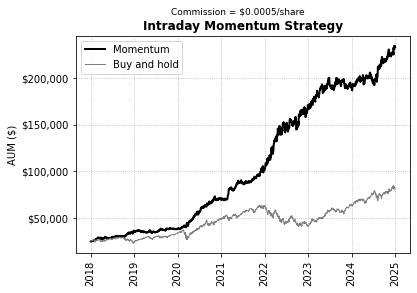

{'Total Return (%)': 833.0, 'Ending Capital ($)': 233200.0, 'Annualized Return (%)': 37.7, 'Annualized Volatility (%)': 17.2, 'Sharpe Ratio': 1.95, 'Hit Ratio (Daily win rate) (%)': 55.0, 'Maximum Drawdown (%)': 8.0, 'Total Number of Trades': 28710.0, 'Alpha (%)': 34.07, 'Beta': -0.03, 'Alpha t-stat': 5.24}


In [9]:
strategy['AUM_passive'] = AUM_0 * (1 + strategy['ret_passive']).cumprod(skipna=True)
total_return_passive = round((np.prod(1 + strategy['ret_passive'].dropna()) - 1) * 100, 0)
fig, ax = plt.subplots()

# Plotting the AUM of the strategy and the passive S&P 500 exposure
ax.plot(strategy.index, strategy['AUM'], label='Momentum', linewidth=2, color='k')
ax.plot(strategy.index, strategy['AUM_passive'], label='Buy and hold', linewidth=1, color='grey')

# Formatting the plot
ax.grid(True, linestyle=':')
ax.xaxis.set_major_locator(mdates.YearLocator())
ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y'))
plt.xticks(rotation=90)
ax.yaxis.set_major_formatter(FuncFormatter(lambda x, _: f'${x:,.0f}'))
ax.set_ylabel('AUM ($)')
plt.legend(loc='upper left')
plt.title('Intraday Momentum Strategy', fontsize=12, fontweight='bold')
plt.suptitle(f'Commission = ${commission}/share', fontsize=9, verticalalignment='top')

plt.show()

# Calculate additional stats
stats = {
    'Total Return (%)': round((np.prod(1 + strategy['ret'].dropna()) - 1) * 100, 0),
    'Ending Capital ($)': round(strategy['AUM'].iloc[-1], 0),
    'Annualized Return (%)': round((np.prod(1 + strategy['ret']) ** (252 / len(strategy['ret'])) - 1) * 100, 1),
    'Annualized Volatility (%)': round(strategy['ret'].dropna().std() * np.sqrt(252) * 100, 1),
    'Sharpe Ratio': round(strategy['ret'].dropna().mean() / strategy['ret'].dropna().std() * np.sqrt(252), 2),
    'Hit Ratio (Daily win rate) (%)': round((strategy['ret'] > 0).sum() / (strategy['ret'].abs() > 0).sum() * 100, 0),
    'Maximum Drawdown (%)': round(strategy['AUM'].div(strategy['AUM'].cummax()).sub(1).min() * -100, 0),
    'Total Number of Trades': total_trade_count / 2
}


Y = strategy['ret'].dropna()
X = sm.add_constant(strategy['ret_passive'].dropna())
model = sm.OLS(Y, X).fit()
stats['Alpha (%)'] = round(model.params.const * 100 * 252, 2)
stats['Beta'] = round(model.params['ret_passive'], 2)
stats["Alpha t-stat"] = round(model.tvalues.const, 2)

print(stats)

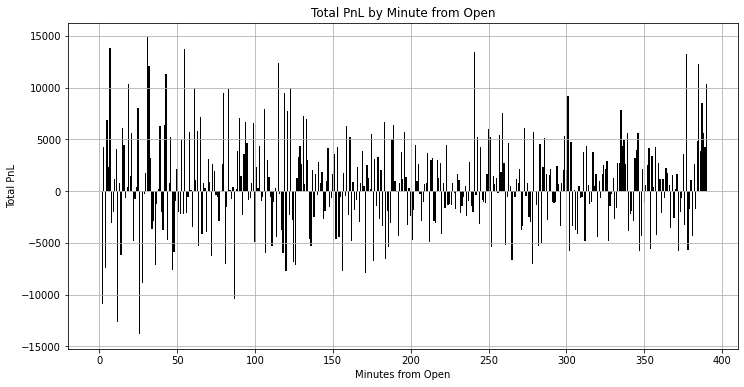

In [10]:
# Initialize a DataFrame to store cumulative PnL for each minute from open
pnl_by_minute = pd.DataFrame(index=range(391), columns=['PnL'])
pnl_by_minute['PnL'] = 0.0

# Loop through all days, starting from the second day
for d in range(1, len(all_days)):
    current_day = all_days[d]
    prev_day = all_days[d-1]

    if prev_day in daily_groups.groups and current_day in daily_groups.groups:
        prev_day_data = daily_groups.get_group(prev_day)
        current_day_data = daily_groups.get_group(current_day)

        open_price = current_day_data['open'].iloc[0]
        current_close_prices = current_day_data['close']
        vwap = current_day_data['vwap']

        signals = np.zeros_like(current_close_prices)
        
        # Generate signals at close
        signals[(current_close_prices > vwap)] = 1
        signals[(current_close_prices < vwap)] = -1

        # Position sizing
        previous_aum = strategy.loc[prev_day, 'AUM']
        shares = round(previous_aum / open_price)

        trade_indices = np.where(current_day_data["min_from_open"] % trade_freq == 0)[0]
        exposure = np.full(len(current_close_prices), np.nan)
        exposure[trade_indices] = signals[trade_indices] 

        # Forward-fill exposure values, stop at zeros
        last_valid = np.nan
        filled_values = [] 
        for value in exposure:
            if not np.isnan(value): 
                last_valid = value
            if last_valid == 0: 
                last_valid = np.nan
            filled_values.append(last_valid)

        exposure = pd.Series(filled_values, index=current_day_data.index).shift(1).fillna(0).values

        # Calculate per-minute PnL
        change_1m = current_close_prices.diff().fillna(0)
        pnl_1m = exposure * change_1m * shares

        # Aggregate PnL by minute from open
        for minute, pnl in zip(current_day_data['min_from_open'], pnl_1m):
            pnl_by_minute.at[minute, 'PnL'] += pnl

# Plot the aggregated PnL by minute from open
plt.figure(figsize=(12, 6))
plt.bar(pnl_by_minute.index, pnl_by_minute['PnL'], color='black')
plt.xlabel('Minutes from Open')
plt.ylabel('Total PnL')
plt.title('Total PnL by Minute from Open')
plt.grid(True)
plt.show()

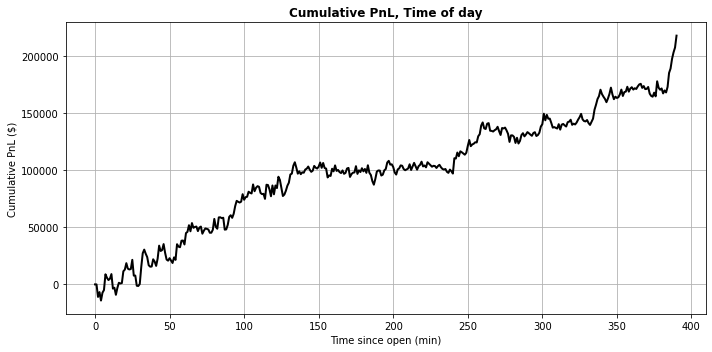

In [11]:
# Compute cumulative PnL
pnl_by_minute['Cumulative_PnL'] = pnl_by_minute['PnL'].cumsum()

# Plot cumulative PnL over time
plt.figure(figsize=(10, 5))
plt.plot(pnl_by_minute.index, pnl_by_minute['Cumulative_PnL'], linestyle='-', linewidth=2, color='k')

# Labels and title
plt.xlabel('Time since open (min)')
plt.ylabel('Cumulative PnL ($)')
plt.title('Cumulative PnL, Time of day', fontsize=12, fontweight='bold')
plt.grid(True)

plt.tight_layout()
plt.show()


In [12]:
def run_strategy_with_commission(all_days, daily_groups, df_daily, trade_freq=1, AUM_0=25000.0, min_comm_per_order=0):

    results = []  # Store results for different commission values
    
    for commission in np.arange(0, 0.0051, 0.0005):
        strategy = pd.DataFrame(index=all_days)
        strategy['ret'] = np.nan
        strategy['AUM'] = AUM_0
        total_trade_count = 0
        
        for d in range(1, len(all_days)):
            current_day = all_days[d]
            prev_day = all_days[d-1]
            
            if prev_day in daily_groups.groups and current_day in daily_groups.groups:
                prev_day_data = daily_groups.get_group(prev_day)
                current_day_data = daily_groups.get_group(current_day)
                
                open_price = current_day_data['open'].iloc[0]
                current_close_prices = current_day_data['close']
                vwap = current_day_data['vwap']
                
                signals = np.zeros_like(current_close_prices)
                signals[(current_close_prices > vwap)] = 1
                signals[(current_close_prices < vwap)] = -1
                
                previous_aum = strategy.loc[prev_day, 'AUM']
                shares = round(previous_aum / open_price)
                
                trade_indices = np.where(current_day_data["min_from_open"] % trade_freq == 0)[0]
                exposure = np.full(len(current_close_prices), np.nan)
                exposure[trade_indices] = signals[trade_indices]
                
                last_valid = np.nan
                filled_values = []
                for value in exposure:
                    if not np.isnan(value):
                        last_valid = value
                    if last_valid == 0:
                        last_valid = np.nan
                    filled_values.append(last_valid)
                
                exposure = pd.Series(filled_values, index=current_day_data.index).shift(1).fillna(0).values
                
                change_1m = current_close_prices.diff()
                gross_pnl = np.sum(exposure * change_1m) * shares
                trades_count = np.sum(np.abs(np.diff(np.append(exposure, 0))))
                total_trade_count += trades_count
                commission_paid = trades_count * max(min_comm_per_order, commission * shares)
                net_pnl = gross_pnl - commission_paid
                
                strategy.loc[current_day, 'AUM'] = previous_aum + net_pnl
                strategy.loc[current_day, 'ret'] = net_pnl / previous_aum
                
        total_return = strategy['AUM'].iloc[-1] / AUM_0 - 1
        results.append({'Commission': commission, 'Total Return': total_return})
    
    return pd.DataFrame(results)

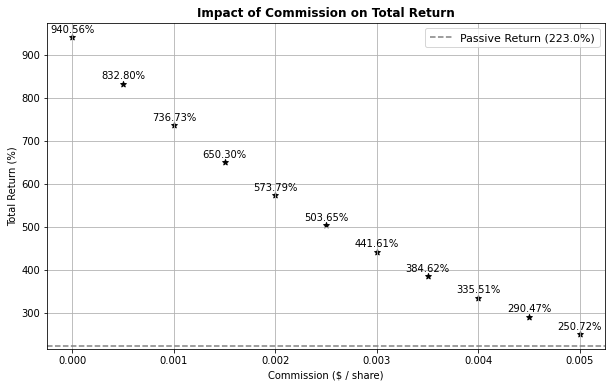

In [13]:
results_df = run_strategy_with_commission(all_days, daily_groups, df_daily)

# Convert total return to percentage
results_df["Total Return (%)"] = results_df["Total Return"] * 100

plt.figure(figsize=(10, 6))
plt.scatter(results_df["Commission"], results_df["Total Return (%)"], marker='*', color='k')

# Plot horizontal line at total_return_passive
plt.axhline(y=total_return_passive, color='grey', linestyle='--', label=f'Passive Return ({total_return_passive}%)')

# Labels and title
plt.xlabel("Commission ($ / share)")
plt.ylabel("Total Return (%)")
plt.title("Impact of Commission on Total Return", fontsize=12, fontweight='bold')
plt.grid(True)

# Show values at each point
for i, txt in enumerate(results_df["Total Return (%)"]):
    plt.annotate(f"{txt:.2f}%", 
                 (results_df["Commission"][i], results_df["Total Return (%)"][i]), 
                 textcoords="offset points", xytext=(0, 5), ha='center')
    
plt.legend(loc="best", fontsize=11, frameon=True)

plt.show()